# NDReg
## 0. Preamble
In order to fully understand the following analysis, some key terms must be defined:

- The **Error** between two volumes is the sum of squared errors between their voxels

- Given images a and b, and function f(), the  **Error Reduction Rate** is calculated as: $\frac{\bigg{|}\text{squaredError}(a,b) - \text{squaredError}(a, f(b))\bigg{|}}{\text{squaredError}(a, b)}$

## 1.Simulation Data
### 1. Write the distributions that I will use to test the code
#### Functionality Testing
I will obtain the functionality testing data from the NDReg tutorial notebooks. The functionality testing data will be an image of a brain, and an atlas that must be aligned to said image.
#### i. 
The solution for this registration should be the same as the solution detailed in the jupyter documentation here:
https://github.com/neurodata/ndreg/blob/master/doc/3D_STP_RegistrationTest.ipynb

#### ii.
I expect this test to perform very well as it is the test used in the example notebook detailing how to run the NDReg pipeline

#### Validation Testing
In order to test the validity of the code, I will be creating code that generates a random synthetic synapse volume, and then performs a random rigid body transformationon the data. The randomly generated volume will have similar size and density statistics as the real world data. Specifically, it will have:

- 98% non-synapse voxels, 2% synapse voxels
- synapse clusters of .2 microns$^3$, or ~27 voxels

Additionally, the random rigid body transformation will account for having up to 5% imaging error in any singular dimension.

### 2. Write code to sample the data
#### Functionality Testing
The code below prepares the functionality testing data by pulling it from NDio

In [2]:
import sys
sys.path.insert(0, '../../../ndreg/')
import ndreg

refImg = ndreg.imgDownload('ara_ccf2')
refAnnoImg = ndreg.imgDownload('ara_ccf2', channel="annotation")
inImg = ndreg.imgDownload('eacker01', 'r', 5)

#reorient and rescale the test image
inImgReor = ndreg.imgReorient(inImg, 'lsp', 'rsa')
inImg_ds = ndreg.imgResample(inImgReor, spacing=[.25, .25, .25])
refImg_ds = ndreg.imgResample(refImg, spacing=[.25, .25, .25])

#### Validation Testing
The code below generates a random volume and applies a rigid body transform according to the specifications in **Simulation Data, Section 1**

In [103]:
import math
import numpy as np
import SimpleITK as itk
from random import randrange as rand
from random import uniform as floatRand
from affine import Affine

def generatePointSet():
    center = (rand(0, 99), rand(0, 99), rand(0, 99))
    toPopulate = []
    for z in range(-1, 2):
        for y in range(-1, 2):
            for x in range(-1, 2):
                curPoint = (center[0]+z, center[1]+y, center[2]+x)               
                #only populate valid points
                valid = True
                for dim in range(3):
                    if curPoint[dim] < 0 or curPoint[dim] >= 100:
                        valid = False
                        
                if valid:
                    toPopulate.append(curPoint)
            
    return set(toPopulate)                       
   
def getTransform():
    #generate a random rigid body transform
    #error is assumed to be 5% rotationally
    #and laterally
    a = floatRand(-.15, .15)
    b = floatRand(-.15, .15)
    c = floatRand(-.15, .15)
    a, b, c = -0.15, -0.15, -0.15
    xt = floatRand(-1.5, 1.5)
    yt = floatRand(-1.5, 1.5)
    zt = floatRand(-1.5, 1.5)
    xt, yt, zt = 0., 0., 0.
    transform = np.stack([
        [math.cos(a)*math.cos(b), math.cos(a)*math.sin(b)*math.sin(c)-math.sin(a)*math.cos(c), math.cos(a)*math.sin(b)*math.cos(c)+math.sin(a)*math.sin(c), xt],
        [math.sin(a)*math.cos(b), math.sin(a)*math.sin(b)*math.sin(c)+math.cos(a)*math.cos(c), math.sin(a)*math.sin(b)*math.cos(c)-math.cos(a)*math.sin(c), yt],
        [-math.sin(b), math.cos(b)*math.sin(c), math.cos(b)*math.cos(c), zt],
        [0., 0., 0., 1.]
    ])
    return transform
    
    
def applyRigid(initialVolume, transform):
    rigidMatrix = np.zeros_like(initialVolume)    
    for z in range(initialVolume.shape[0]):
        for y in range(initialVolume.shape[1]):
            for x in range(initialVolume.shape[2]):
                shift = [initialVolume.shape[2]/2., initialVolume.shape[1]/2., initialVolume.shape[0]/2.]
                shiftedPoint = list(np.subtract([x, y, z], shift))
                shiftedPoint.append(1.)
                new = np.dot(transform, shiftedPoint)[:3]
                final = np.add(new, shift)
                try:
                    rigidMatrix[int(final[2]), int(final[1]), int(final[0])] = initialVolume[z, y, x]
                #if transformed place is out of bounds, dont deal with it
                except IndexError:
                        continue
    return rigidMatrix
    
def generateTestVolume():
    #create a test volume
    volume = np.zeros((100, 100, 100))
    myPointSet = set()
    for _ in range(rand(500, 800)):
        potentialPointSet = generatePointSet()
        #be sure there is no overlap
        while len(myPointSet.intersection(potentialPointSet)) > 0:
                potentialPointSet = generatePointSet()
        for elem in potentialPointSet:
            myPointSet.add(elem)
    
    #populate the true volume
    for elem in myPointSet:
        volume[elem[0], elem[1], elem[2]] = 60000
        
    #introduce noise
    noiseVolume = np.copy(volume)
    for z in range(noiseVolume.shape[0]):
        for y in range(noiseVolume.shape[1]):
            for x in range(noiseVolume.shape[2]):
                if not (z, y, x) in myPointSet:
                    noiseVolume[z][y][x] = rand(0, 10000)
      
    #convert numpy array to itk image
    itkVolume = itk.GetImageFromArray(noiseVolume)
    
    #perform a random rigid body transform to generate the second volume
    transform = getTransform()
    rigidMatrix = applyRigid(noiseVolume, transform)
    
    rigidVolume = itk.GetImageFromArray(rigidMatrix)
    return itkVolume, rigidVolume, transform

#### i.
This generation routing will return two volumes, the itkVolume and the rigidVolume. The itkVolume is the untranslated data, which can be used as the groundtruth for the registration operation.
#### ii.
I expect the algorithm to perfrom very well since the magnitude of the transform is extremely low at 5%

### 3. Describe what I think simulations will look like
#### Functionality
I expect the functionality results to be identical to the results outlined in the NDReg documentation notebook. The notebook is linked in **Simulation Data - Functionality Testing - 1 - i.**
#### Validation
I expect the validation data to have an **Error Reduction Rate** that is proportional to the number of iterations of gradient descent performed in the algorithm. I do not, however, have a prediction for the cap error reduction rate that will be achieved.

### 4/5. Write code to plot and plot the simulated data
#### Generation routine testing
The following code will apply random rigid body transformations to an initial image with two simple clusters in it, and display the results to confirm that small, valid transformations are being made.

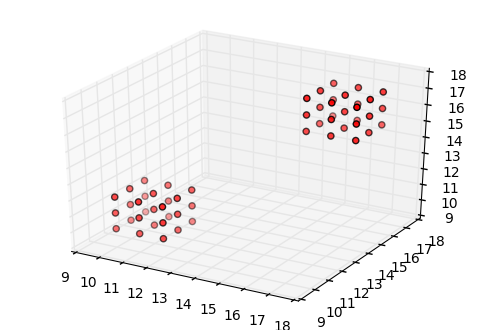

In [22]:
import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from skimage.measure import label

twoCluster = pickle.load(open('../code/tests/synthDat/twoPerfectClusters.synth'))

#pre transform
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
z, y, x = twoCluster.nonzero()
ax.scatter(x, y, z, zdir='z', c='r')
plt.show()

[[ 0.9913397   0.05491921  0.1192874   0.38816563]
 [-0.03640131  0.987678   -0.15220744 -0.31735753]
 [-0.12617665  0.14654706  0.98112355  0.60658194]
 [ 0.          0.          0.          1.        ]]


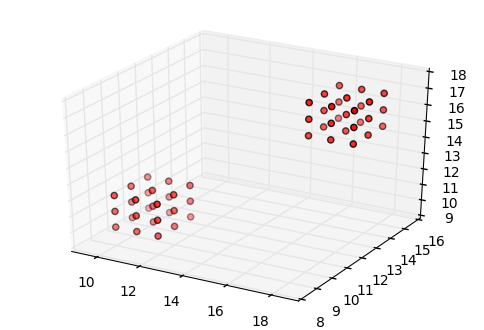

[[  9.89893398e-01   6.31190621e-04  -1.41812068e-01   5.80656762e-02]
 [  1.99448919e-02   9.89431100e-01   1.43625551e-01  -2.37695196e-01]
 [  1.40403926e-01  -1.45002411e-01   9.79418725e-01  -9.30255528e-01]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   1.00000000e+00]]


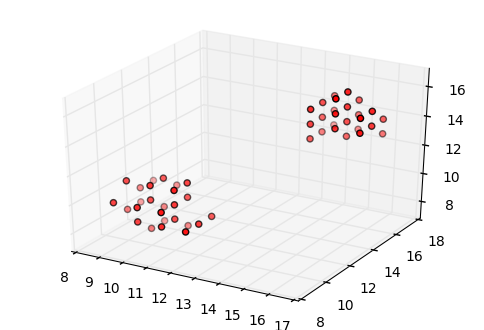

[[ 0.98824201  0.05551208 -0.14246453  0.31126411]
 [-0.04435811  0.99578239  0.08031057 -0.45226815]
 [ 0.14632188 -0.07304682  0.9865364  -1.41420247]
 [ 0.          0.          0.          1.        ]]


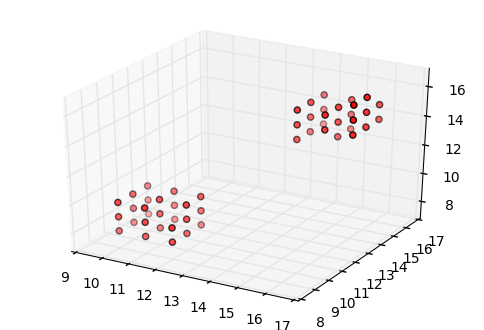

In [45]:
for i in range(3):
    #post transform
    transform = getTransform()
    post = applyRigid(twoCluster, transform)   
    print transform
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    z, y, x = post.nonzero()
    ax.scatter(x, y, z, zdir='z', c='r')
    plt.show()

### 6. Report on the simulated data

- From the visualizations provided, I can confirm that the transformation function is successfully transforming the data with a small rigid body transform.

- The validity of the random cluster generation routine (i.e. generateTestVolume) has already been investigated and reported on throrughly here:

### 7. Failure Case

I am not going to test NDReg's failure cases through data; rather, I am going to test them through hyperparameter variation. It is my expectation that modulating the number of gradient descent iterations of the algorithm will cause failure and success cases to appear on their own.

## Simulation Analysis
### 1. Pseudocode
Below is the pseudocode for NDReg's (poorly named) imgAffineComposite funciton.

#### **INPUTS & OUTPUTS**

##### Parameters
- inImg_ds -> The image two be aligned
- refImage_ds -> The image which inImg_ds is being aligned to
- iterations -> The number of iterations to run the algorithm
- useMI -> Whether or not to use MI (Mutual Information)
- verbose -> Whether or not to print progress and debug data

##### Input Space
The main inputs to this algorithm are 2 3D volumes of the same data type inImg_ds and refImage_ds

##### Output Space
The output of this algorithm is a matrix superposition of 4 transformations in this order:
1. Translation
2. Scaling
3. Rigid
4. Affine

The pseudocode for the algorithm is below:

In [ ]:
######################################
###THIS IS PSEUDOCODE; WILL NOT RUN###
######################################

def algorithm(inImg_ds, refImg_ds, iterations, useMI = False, verbose = False):
    translation = randomTranslation()
    for iteration in iterations:
        newImg = applyTranslation(inImg_ds, translation)
        loss = squaredError(newImg, refImg_ds)
        translation = gradientDescentStep(translation, loss)
    
    baseImg = newImg    
    scale = randomScale()
    for iteration in iterations:
        newImg = applyScale(baseImg, scale)
        loss = squaredError(newImg, refImg_ds)
        scale = gradientDescentStep(scale, loss)
    
    baseImg = newImg    
    rigid = randomRigid()
    for iteration in iterations:
        newImg = applyRigid(baseImg, rigid)
        loss = squaredError(newImg, refImg_ds)
        rigid = gradientDescentStep(rigid, loss)
    
    baseImg = newImg    
    affine = randomAffine()
    for iteration in iterations:
        newImg = applyAffine(baseImg, affine)
        loss = squaredError(newImg, refImg_ds)
        affine = gradientDescentStep(affine, loss)
        
    
    return translation * scale * rigid * affine

### 2. Algorithm Code

In [3]:
def register(inImg, baseImg, iterations, MI=False):
    return ndreg.imgAffineComposite(inImg,
                              baseImg,
                              iterations=iterations,
                              useMI=MI,
                              verbose=False)

### 3. Predicted functionality simulation performance
Please refer to **Simulation Data - Section 1 - i**

### 4. Generate Simulated Data
Since attempting to visualize the transformation on the simulated volumes is very difficult, the transformations will be applied to this function in order to help with visualizing the exact distortions of the transformation

In [4]:
def visualizeTransform(transform):
    twoCluster = pickle.load(open('../code/tests/synthDat/twoPerfectClusters.synth'))
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    z, y, x = twoCluster.nonzero()
    ax.scatter(x, y, z, zdir='z', c='r')
    plt.show()
    post = applyRigid(twoCluster, transform)   
    print transform
    fig2 = plt.figure()
    ax = fig2.add_subplot(111, projection='3d')
    z, y, x = post.nonzero()
    ax.scatter(x, y, z, zdir='z', c='r')
    plt.show()

### Functionality Data
Below are the plots of the atlas and the brain image to be aligned for the functionality test.

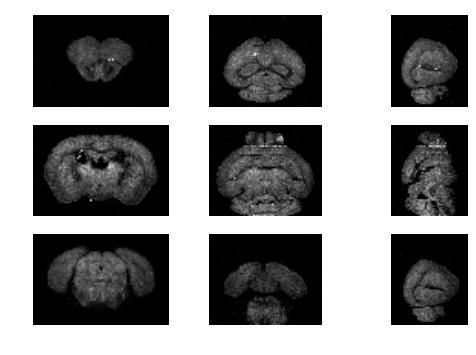

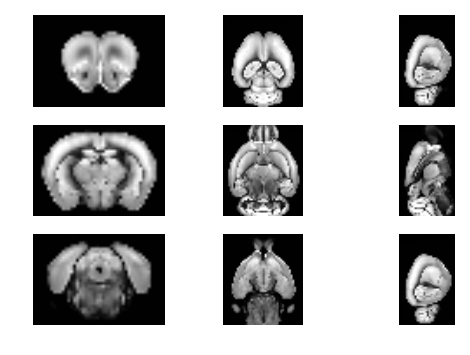

In [4]:
#display the images to be registered
ndreg.imgShow(inImg_ds, vmax=10000)
ndreg.imgShow(refImg_ds, vmax=500)

### Validation Data
Below is a demonstration of a random rigid transform on a synthetic body and a visualization space

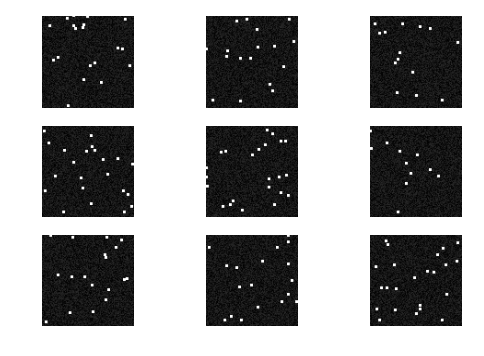

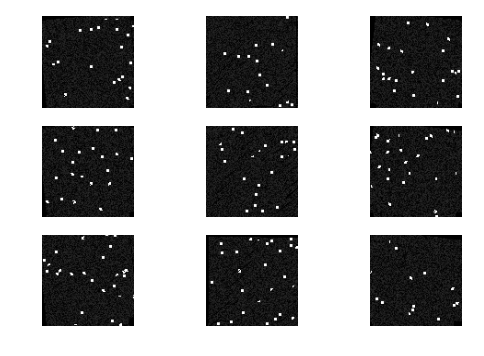

Transformation Visualization:


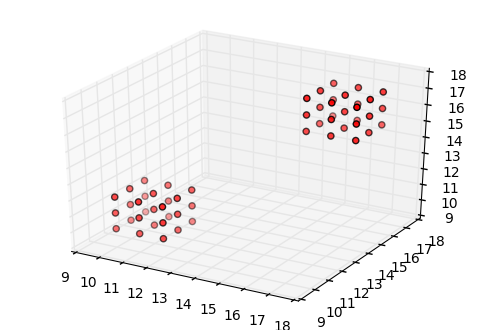

[[ 0.99501994  0.09880746 -0.01313052  0.65802909]
 [-0.09966726  0.9880151  -0.11786686 -1.10876344]
 [ 0.00132702  0.11858856  0.99294259  1.09742232]
 [ 0.          0.          0.          1.        ]]


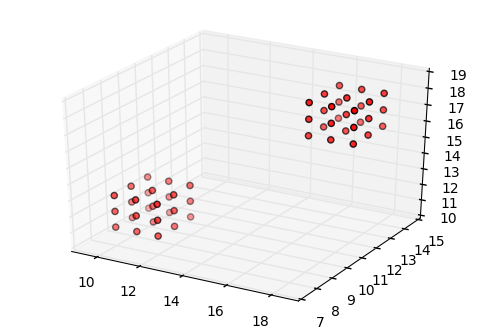

In [46]:
baseVolumeImg, transformedVolumeImg, transform = generateTestVolume()

#base volume image
ndreg.imgShow(baseVolumeImg)
#transformed volume image
ndreg.imgShow(transformedVolumeImg)
#transformation visualization
print 'Transformation Visualization:'
visualizeTransform(transform)

### 5. Run pipeline on simulated data
#### Functionality data

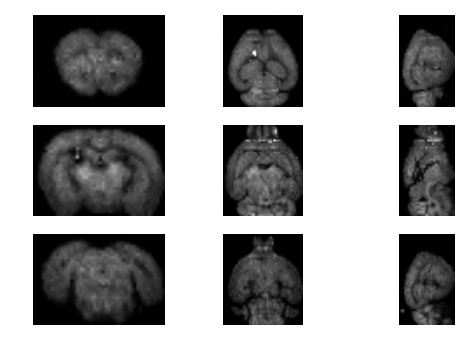

In [5]:
transform = register(inImg_ds, refImg_ds, 200, True)
resultImage = ndreg.imgApplyAffine(inImg_ds,
                                   transform,
                                   size=refImg_ds.GetSize(),
                                   spacing=refImg_ds.GetSpacing())
ndreg.imgShow(resultImage, vmax=10000)

The output of the functionality test verifies that the algorithm can be called successfully and is functioning as expected on a base case.

#### Validation data
The validation data will be tested as a function of iterations of gradient descent, as well as a function of its loss metric (L2 vs MI). The tests will be evaluated on their error reduction ratio, and their error reduction ratio variance.

In [5]:
def executeValidationTest(iterations, MI):

    print '\nExecuting Validation Test With : ', iterations, ' iterations'
    
    #generate an display data
    itkVolume, rigidVolume, curTransform = generateTestVolume()
    print '\tTransformation Visualization:'
    visualizeTransform(curTransform)
    ndreg.imgShow(itkVolume, vmax=60000)
    ndreg.imgShow(rigidVolume, vmax=60000)
    
    #calculate initial error
    initialErr = np.sum((itk.GetArrayFromImage(itkVolume)-itk.GetArrayFromImage(rigidVolume))**2)
    print '\tInitial Error: ', initialErr
    
    #perform transform
    transform = register(rigidVolume, itkVolume, 100, MI)
    resultVolume = ndreg.imgApplyAffine(rigidVolume, transform, size=itkVolume.GetSize(), spacing=itkVolume.GetSpacing())
    ndreg.imgShow(resultVolume, vmax=60000)
    
    #perform random transform
    randMatrix = applyRigid(itk.GetArrayFromImage(rigidVolume), getTransform())

    #calculate final error
    finalPipeErr = np.sum((itk.GetArrayFromImage(itkVolume)-itk.GetArrayFromImage(resultVolume))**2)
    finalRandErr = np.sum((itk.GetArrayFromImage(itkVolume)-randMatrix)**2)
    print '\tFinal Pipeline Error: ', finalPipeErr
    print '\tFinal Random Error: ', finalRandErr

    #get the reduction in error
    pipeRatio = (initialErr - finalPipeErr)/initialErr 
    randRatio = (initialErr - finalRandErr)/initialErr 
    
    print '\tPipeline Reduction Ratio: ', pipeRatio
    print '\tRandom Reduction Ratio: ', randRatio
    print '\n\n\n'
    
    return pipeRatio, randRatio


Executing Validation Test With :  150  iterations
	Transformation Visualization:


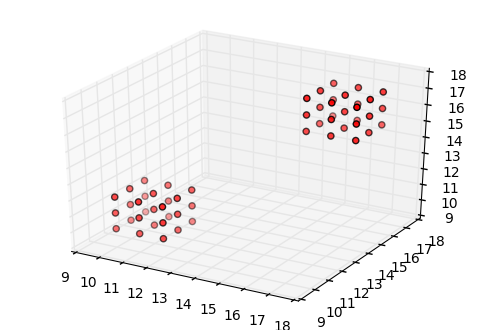

[[ 0.99483785  0.10137187  0.00462474 -1.19029017]
 [-0.10016729  0.98827398 -0.11524349 -1.00426839]
 [-0.01625296  0.11418534  0.99332651  1.20151912]
 [ 0.          0.          0.          1.        ]]


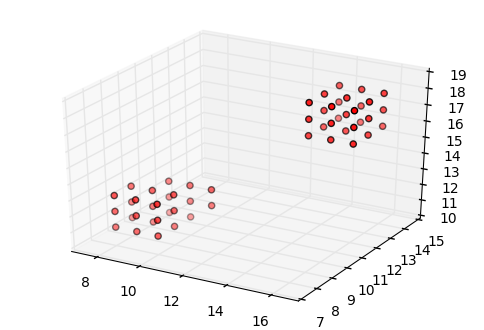

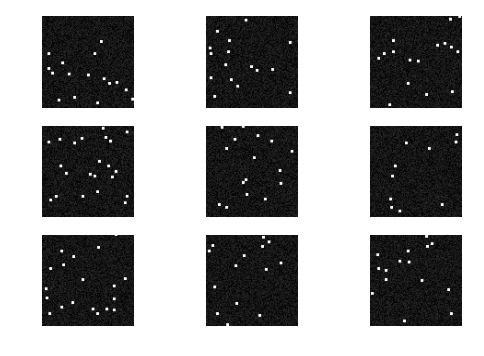

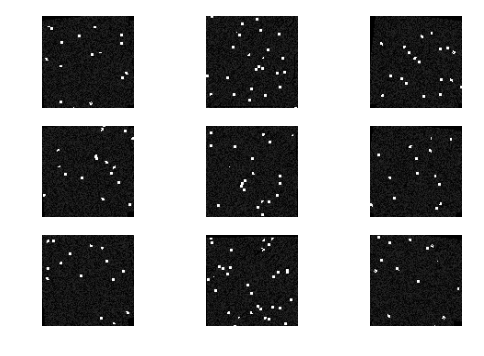

	Initial Error:  1.10790532782e+14


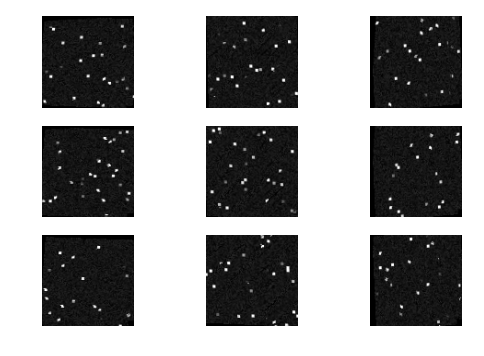

	Final Pipeline Error:  6.99538544213e+13
	Final Random Error:  1.1035507223e+14
	Pipeline Reduction Ratio:  0.368593573253
	Random Reduction Ratio:  0.00393048522101





Executing Validation Test With :  150  iterations
	Transformation Visualization:


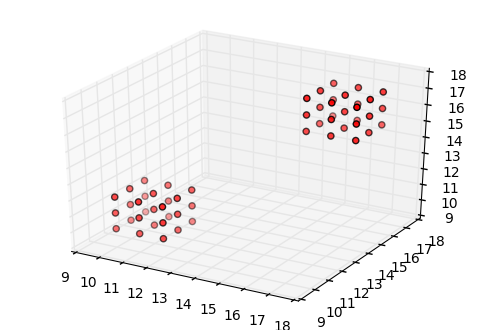

[[ 0.99180258  0.07781858  0.1013504  -0.87527613]
 [-0.08125986  0.99623306  0.03027416  0.62321102]
 [-0.09861273 -0.03826171  0.99439005 -1.20016335]
 [ 0.          0.          0.          1.        ]]


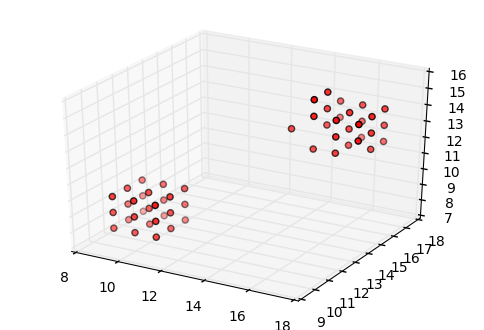

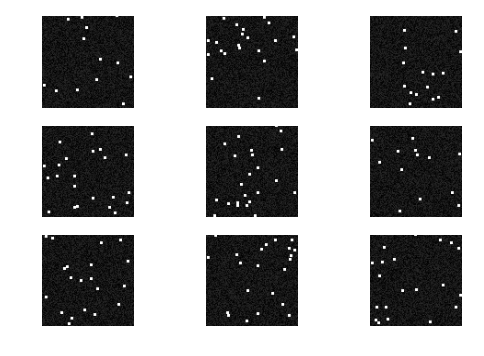

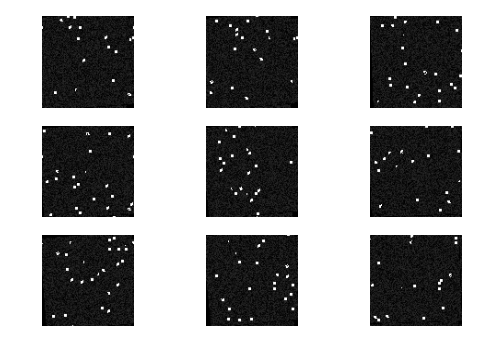

	Initial Error:  1.13324757752e+14


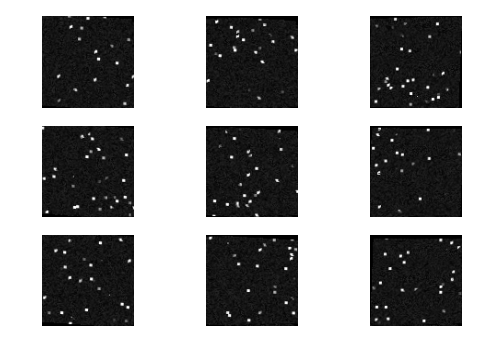

	Final Pipeline Error:  7.08426569265e+13
	Final Random Error:  1.12712072348e+14
	Pipeline Reduction Ratio:  0.374870431391
	Random Reduction Ratio:  0.00540645677492





Executing Validation Test With :  150  iterations
	Transformation Visualization:


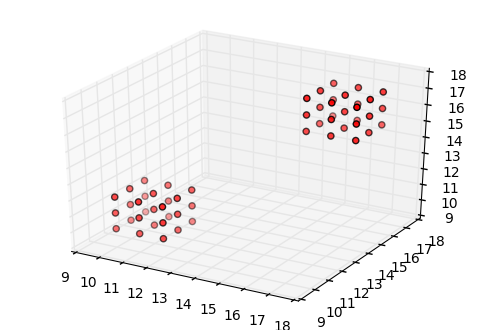

[[ 0.99078412 -0.07963325 -0.10956902  0.52656339]
 [ 0.07005375  0.99359489 -0.08866602 -0.89926088]
 [ 0.11592798  0.08017316  0.99001665  1.42850202]
 [ 0.          0.          0.          1.        ]]


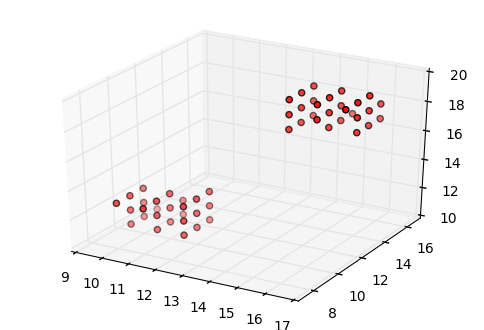

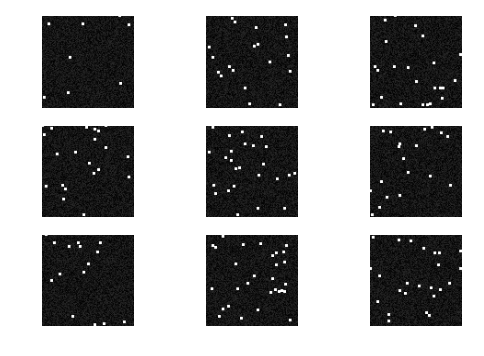

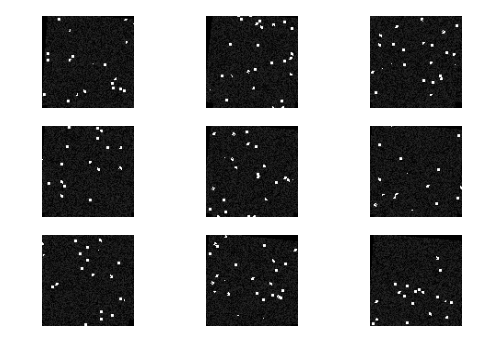

	Initial Error:  1.13263779982e+14


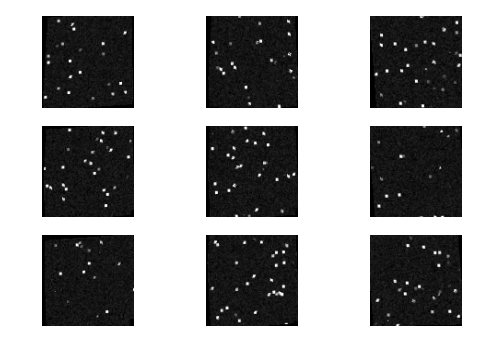

	Final Pipeline Error:  7.06382273582e+13
	Final Random Error:  1.13700451262e+14
	Pipeline Reduction Ratio:  0.376338778651
	Random Reduction Ratio:  -0.00385534792909





Average Error Reduction Ratio:
	Pipeline:  0.373267594432
	Random:  0.00182719802228

Error Reduction Ratio Variance
	Pipeline:  1.12825776016e-05
	Random:  1.65087462494e-05

Executing Validation Test With :  200  iterations
	Transformation Visualization:


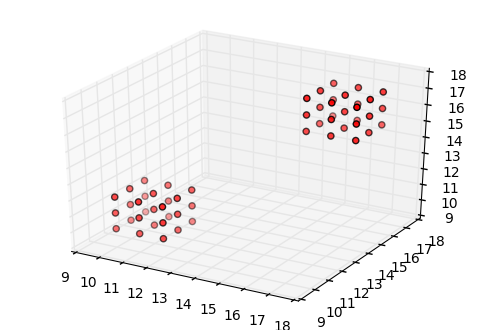

[[ 0.98409412 -0.1037195  -0.14422564  0.31951387]
 [ 0.10864262  0.99372312  0.02666721  0.74236513]
 [ 0.14055445 -0.0419121   0.98918543  0.58180274]
 [ 0.          0.          0.          1.        ]]


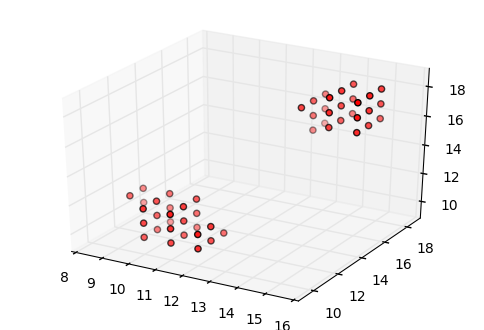

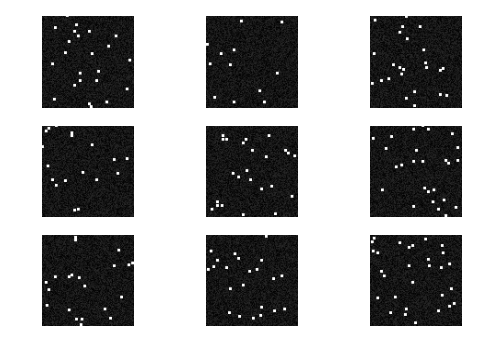

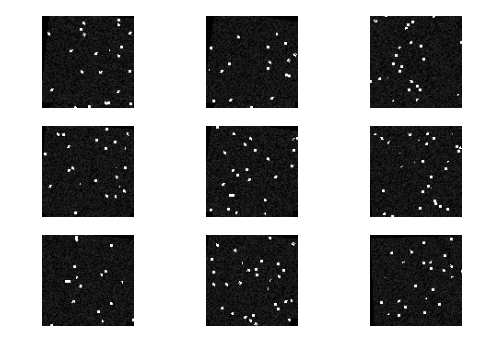

	Initial Error:  1.30992059801e+14


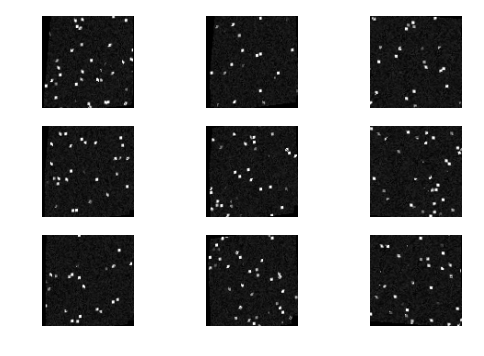

	Final Pipeline Error:  9.0040521144e+13
	Final Random Error:  1.17317601939e+14
	Pipeline Reduction Ratio:  0.312626114282
	Random Reduction Ratio:  0.104391501921





Executing Validation Test With :  200  iterations
	Transformation Visualization:


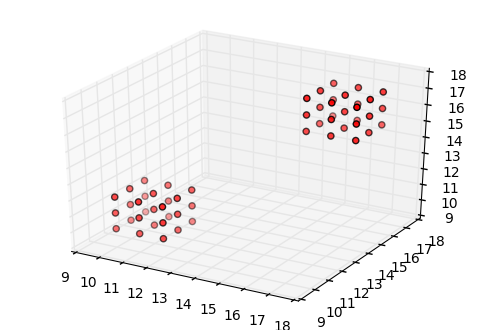

[[ 0.98592322  0.09099257  0.14027028  1.4990139 ]
 [-0.1013902   0.99246209  0.06884054 -0.662555  ]
 [-0.13294896 -0.08209352  0.98771718  0.45378902]
 [ 0.          0.          0.          1.        ]]


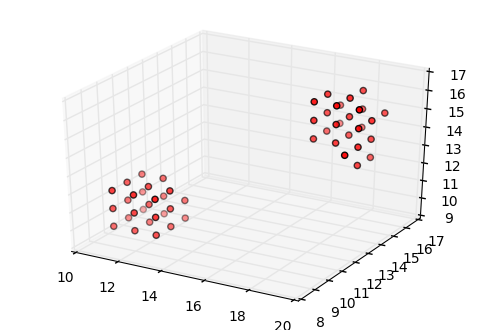

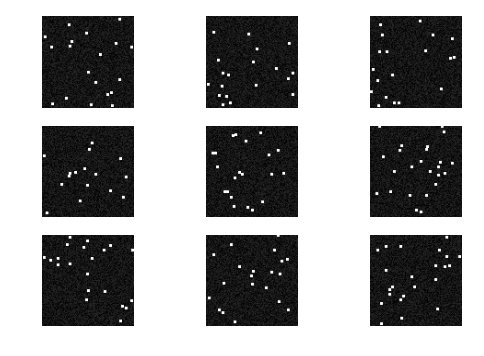

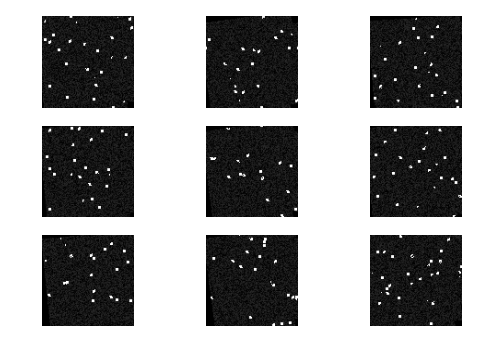

	Initial Error:  1.15437072875e+14


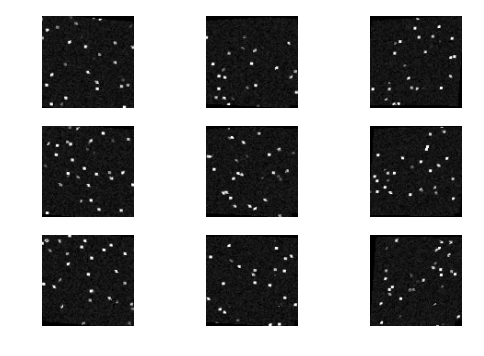

	Final Pipeline Error:  7.92023749905e+13
	Final Random Error:  1.15053351861e+14
	Pipeline Reduction Ratio:  0.313891343411
	Random Reduction Ratio:  0.00332407088989





Executing Validation Test With :  200  iterations
	Transformation Visualization:


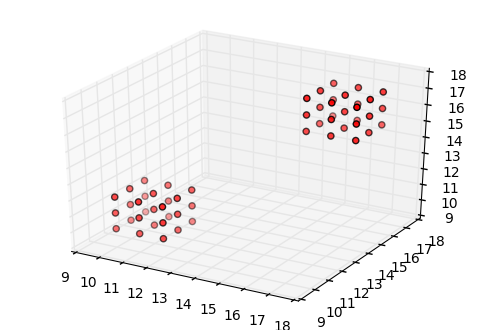

[[ 0.98934442  0.01839695  0.14442701  0.72626049]
 [-0.00747344  0.99709392 -0.07581465 -1.32203133]
 [-0.14540205  0.07392744  0.9866068  -0.29691522]
 [ 0.          0.          0.          1.        ]]


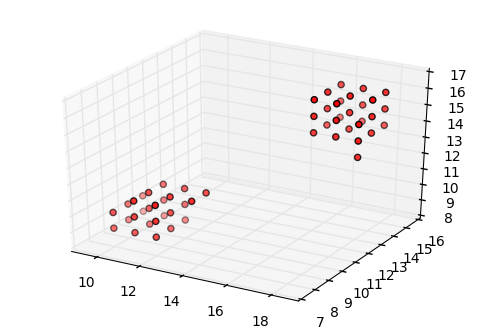

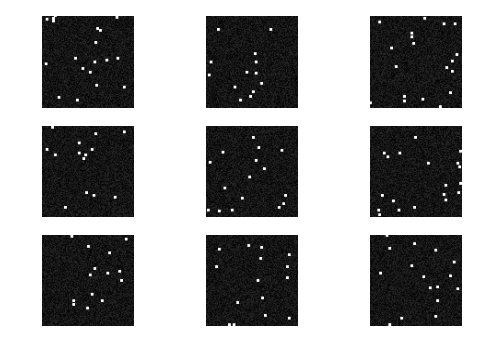

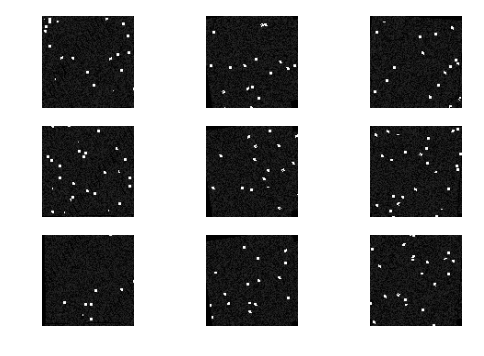

	Initial Error:  1.12568940296e+14


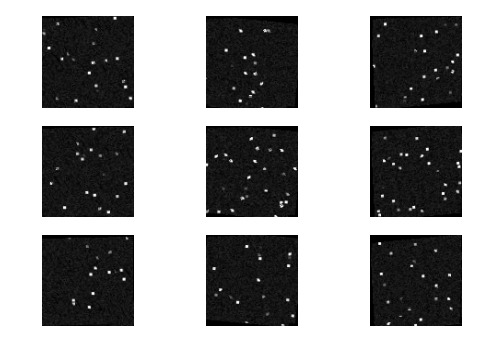

	Final Pipeline Error:  6.76868952567e+13
	Final Random Error:  1.11277571461e+14
	Pipeline Reduction Ratio:  0.398707182651
	Random Reduction Ratio:  0.0114718041363





Average Error Reduction Ratio:
	Pipeline:  0.341741546781
	Random:  0.039729125649

Error Reduction Ratio Variance
	Pipeline:  0.00162280863579
	Random:  0.00210167571207

Executing Validation Test With :  250  iterations
	Transformation Visualization:


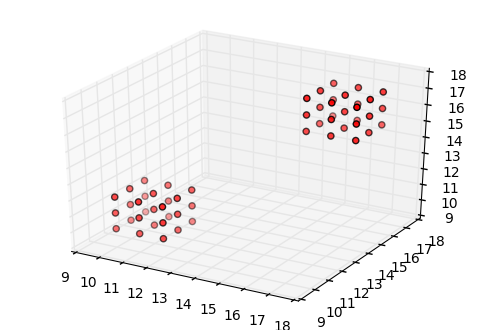

[[ 0.98987128 -0.07067461 -0.12312572  1.23180141]
 [ 0.06655877  0.99708763 -0.03723159 -1.34066477]
 [ 0.12539846  0.02865939  0.99169243  0.73228104]
 [ 0.          0.          0.          1.        ]]


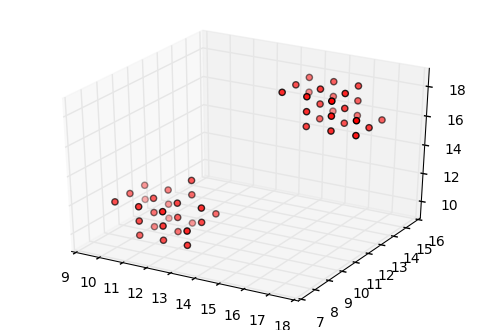

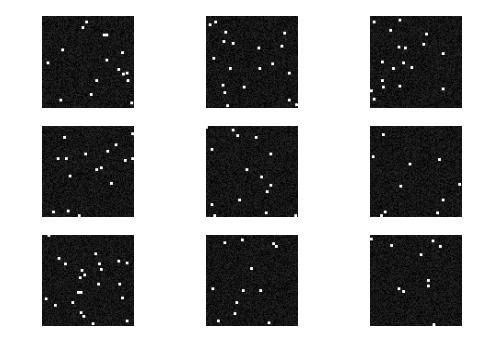

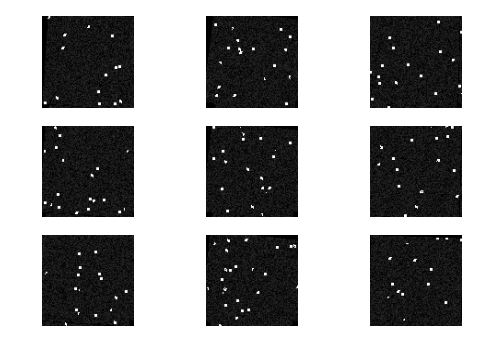

	Initial Error:  1.07143462885e+14


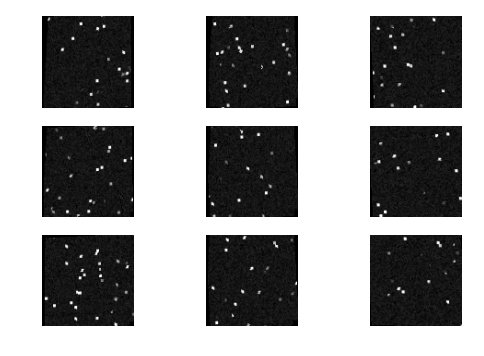

	Final Pipeline Error:  6.64599835726e+13
	Final Random Error:  1.02186082138e+14
	Pipeline Reduction Ratio:  0.379710326855
	Random Reduction Ratio:  0.0462686253866





Executing Validation Test With :  250  iterations
	Transformation Visualization:


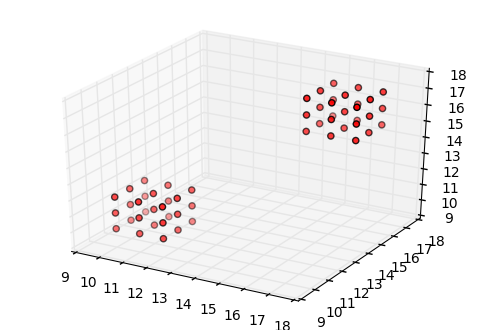

[[ 0.99753389  0.04963955 -0.04961906 -0.1103241 ]
 [-0.04510466  0.99503903  0.08867293 -0.93331727]
 [ 0.05377459 -0.08621621  0.99482413 -0.58615244]
 [ 0.          0.          0.          1.        ]]


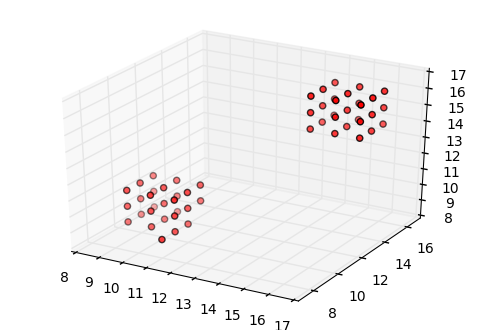

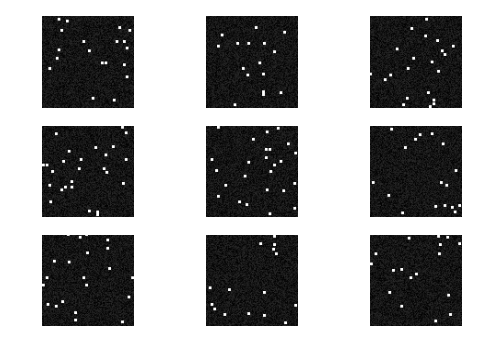

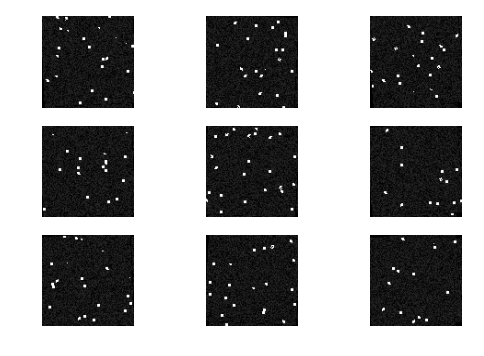

	Initial Error:  1.09053953323e+14


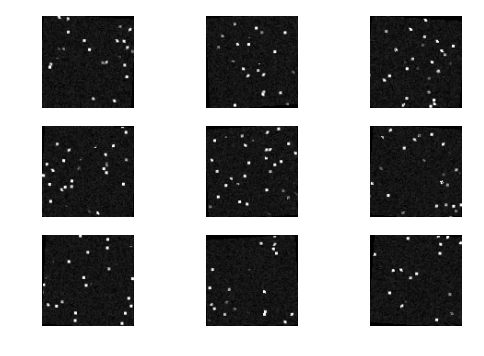

	Final Pipeline Error:  4.00435388603e+13
	Final Random Error:  1.10205709928e+14
	Pipeline Reduction Ratio:  0.632809837331
	Random Reduction Ratio:  -0.0105613466595





Executing Validation Test With :  250  iterations
	Transformation Visualization:


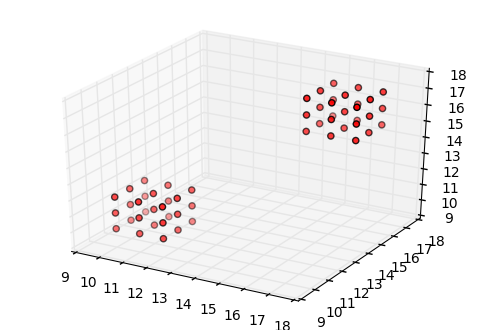

[[ 0.9995224   0.02543084  0.01755697 -0.59846459]
 [-0.02444842  0.99823788 -0.0540686   0.56044486]
 [-0.01890104  0.05361354  0.99838286  0.69106438]
 [ 0.          0.          0.          1.        ]]


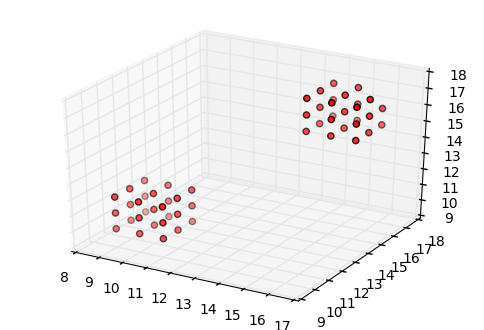

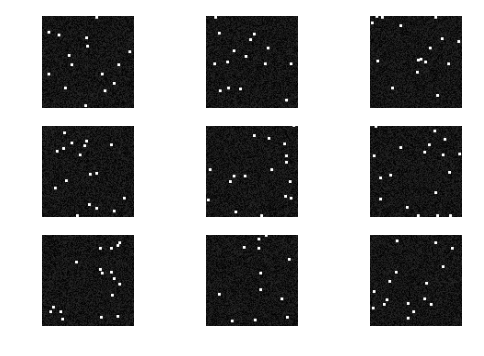

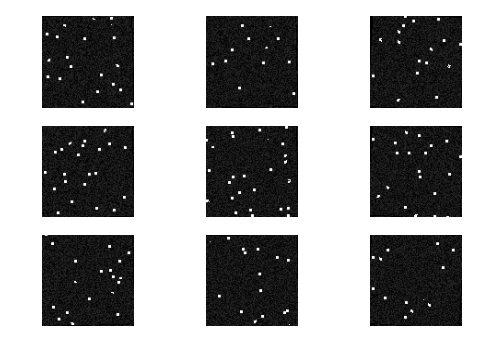

	Initial Error:  9.40887396684e+13


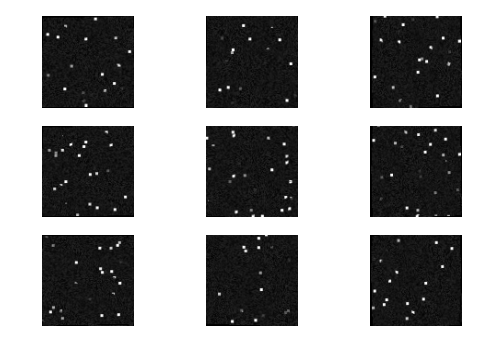

	Final Pipeline Error:  4.47591809486e+13
	Final Random Error:  1.07769096244e+14
	Pipeline Reduction Ratio:  0.524287591625
	Random Reduction Ratio:  -0.14539844644





Average Error Reduction Ratio:
	Pipeline:  0.512269251937
	Random:  -0.0365637225711

Error Reduction Ratio Variance
	Pipeline:  0.0107487806116
	Random:  0.00646077284698

Executing Validation Test With :  300  iterations
	Transformation Visualization:


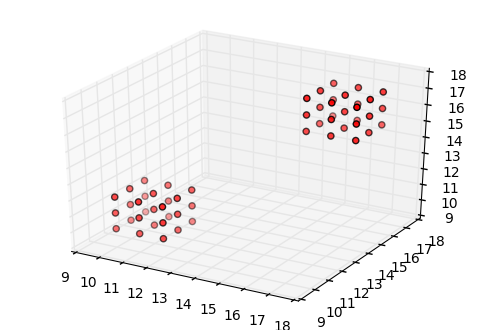

[[ 0.99584544 -0.01488461  0.08983488 -1.28231577]
 [ 0.00211953  0.99007159  0.14054802 -0.51249239]
 [-0.09103496 -0.1397737   0.98598983  0.96185226]
 [ 0.          0.          0.          1.        ]]


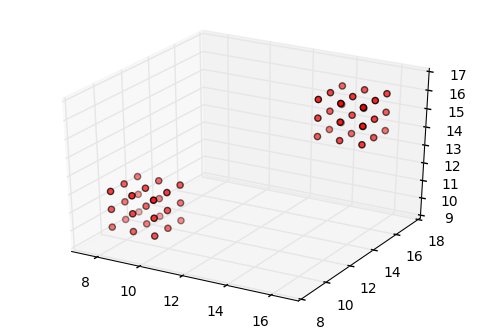

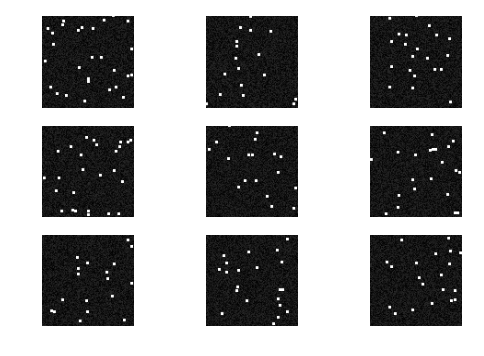

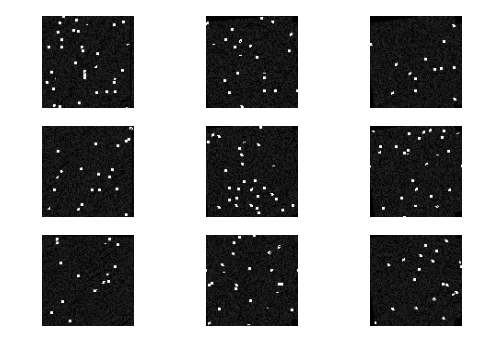

	Initial Error:  1.20924878356e+14


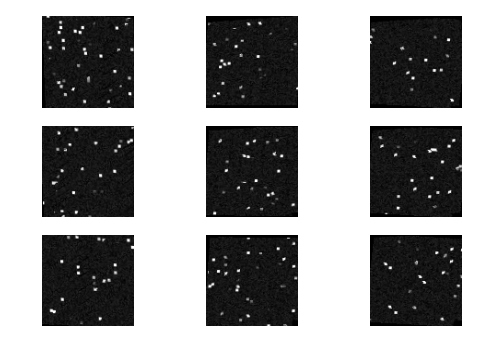

	Final Pipeline Error:  7.87204182094e+13
	Final Random Error:  1.19332106022e+14
	Pipeline Reduction Ratio:  0.349013873079
	Random Reduction Ratio:  0.013171585169





Executing Validation Test With :  300  iterations
	Transformation Visualization:


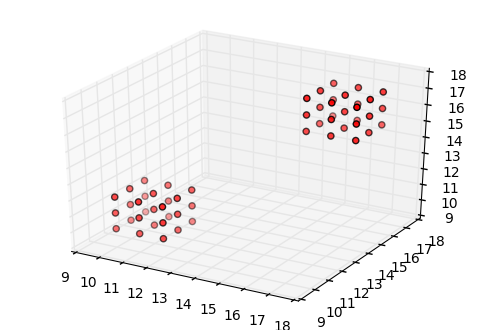

[[ 0.99256193  0.07319126 -0.09728237 -1.18646237]
 [-0.06344576  0.99298746  0.09975242 -0.73831758]
 [ 0.10390118 -0.0928383   0.99024522  1.08463135]
 [ 0.          0.          0.          1.        ]]


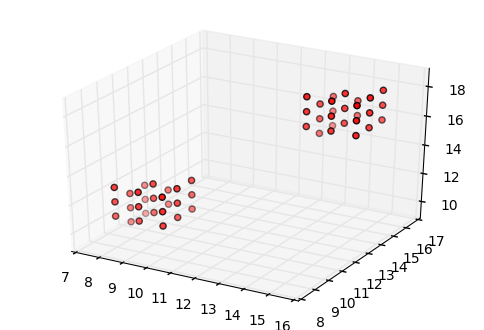

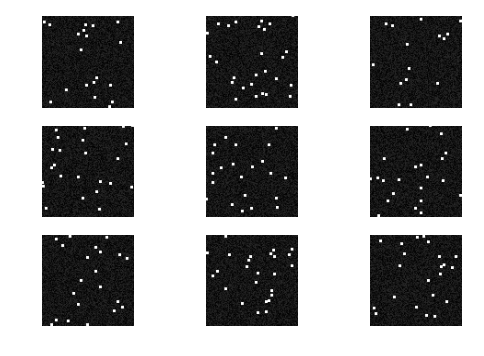

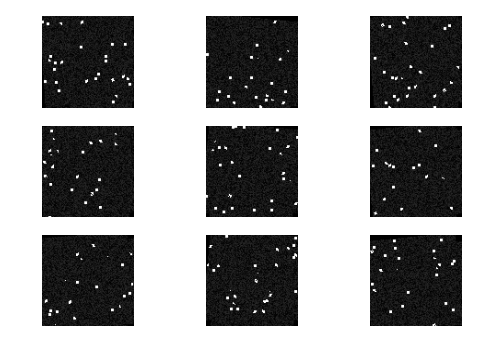

	Initial Error:  1.22846985169e+14


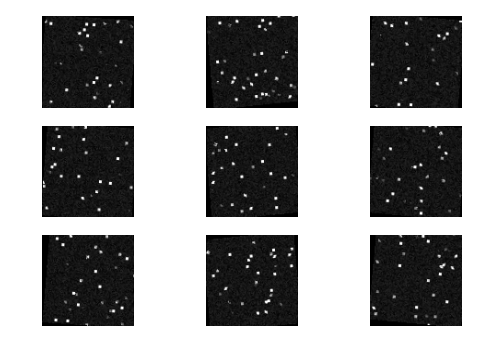

	Final Pipeline Error:  3.26976101317e+13
	Final Random Error:  1.13651310405e+14
	Pipeline Reduction Ratio:  0.733834655471
	Random Reduction Ratio:  0.0748547044194





Executing Validation Test With :  300  iterations
	Transformation Visualization:


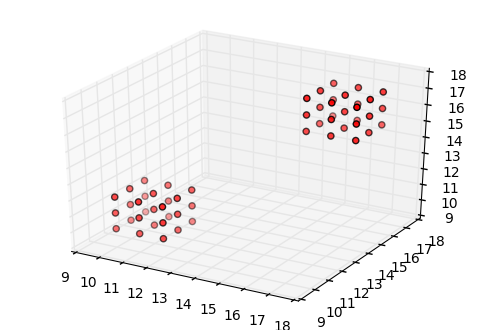

[[ 0.9929383  -0.0376186  -0.11250947  1.43277468]
 [ 0.0270927   0.99523526 -0.09366304 -1.3110634 ]
 [ 0.11549687  0.08995344  0.98922639 -0.05907549]
 [ 0.          0.          0.          1.        ]]


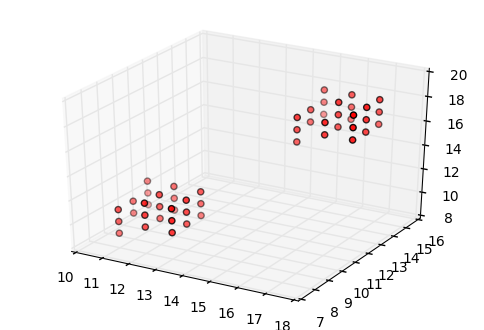

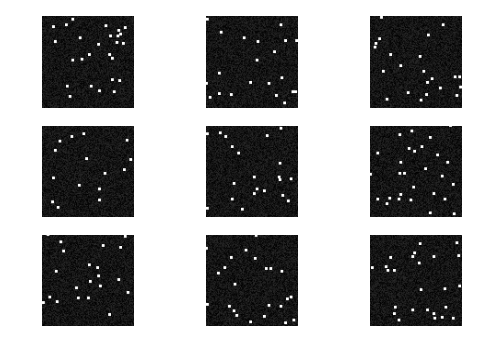

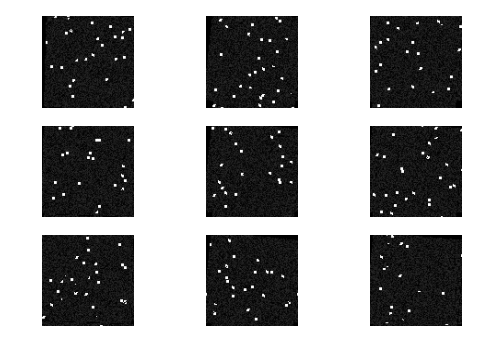

	Initial Error:  1.305126883e+14


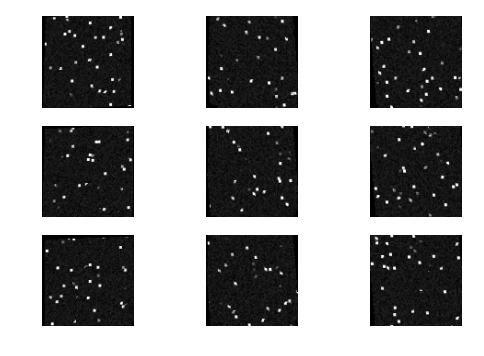

	Final Pipeline Error:  8.1970268829e+13
	Final Random Error:  1.2907085788e+14
	Pipeline Reduction Ratio:  0.371936400234
	Random Reduction Ratio:  0.0110474348417





Average Error Reduction Ratio:
	Pipeline:  0.484928309595
	Random:  0.0330245748101

Error Reduction Ratio Variance
	Pipeline:  0.0310647582174
	Random:  0.000875631874003

Executing Validation Test With :  350  iterations
	Transformation Visualization:


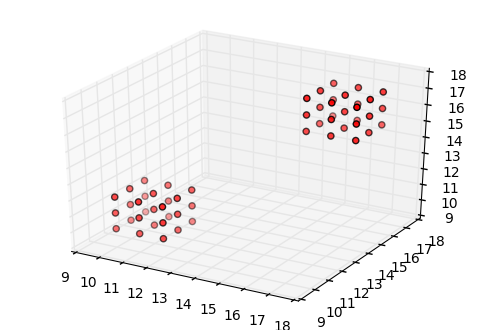

[[ 0.98849015 -0.12069959  0.09120763 -1.19590643]
 [ 0.12693737  0.98971355 -0.06598477 -0.40751777]
 [-0.0823051   0.07680295  0.99364339  1.27459334]
 [ 0.          0.          0.          1.        ]]


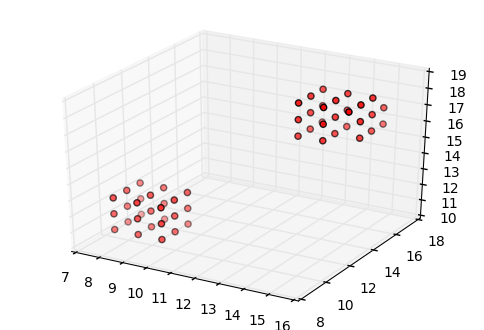

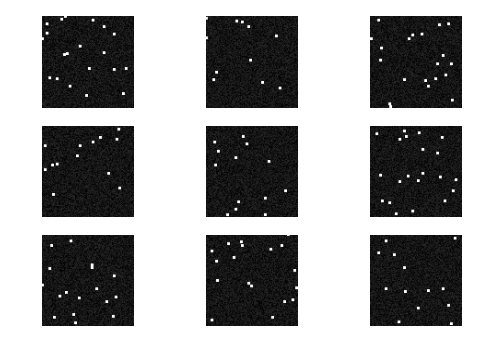

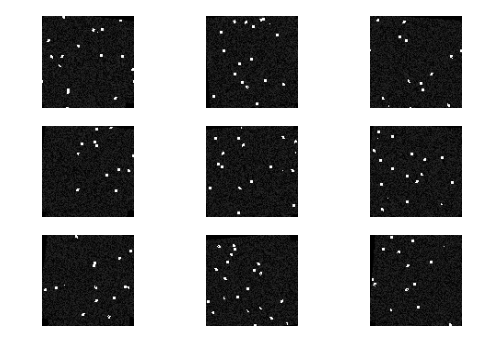

	Initial Error:  9.29214462821e+13


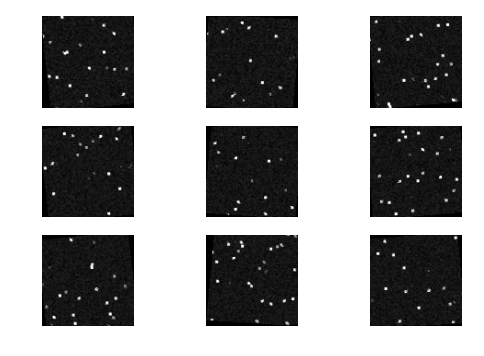

	Final Pipeline Error:  3.77923337468e+13
	Final Random Error:  9.5498970979e+13
	Pipeline Reduction Ratio:  0.593287284487
	Random Reduction Ratio:  -0.0277387492341





Executing Validation Test With :  350  iterations
	Transformation Visualization:


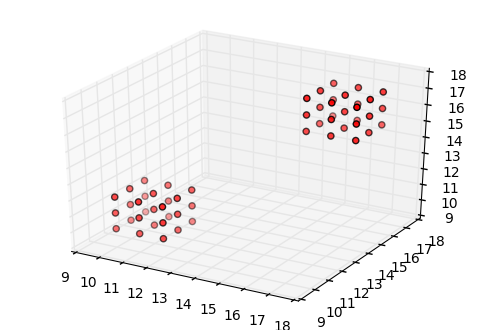

[[ 0.99940749 -0.02804788  0.01994945 -0.24792573]
 [ 0.02732637  0.99899373  0.03556405  1.08244901]
 [-0.02092688 -0.03499783  0.99916826  0.42369234]
 [ 0.          0.          0.          1.        ]]


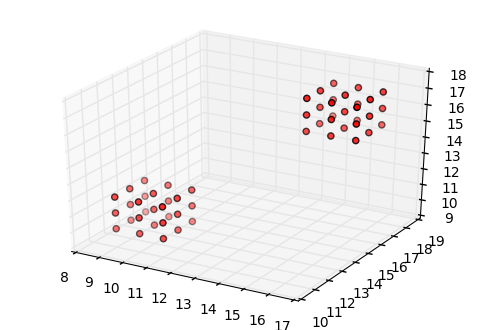

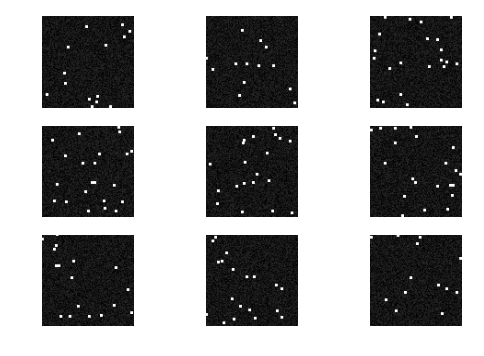

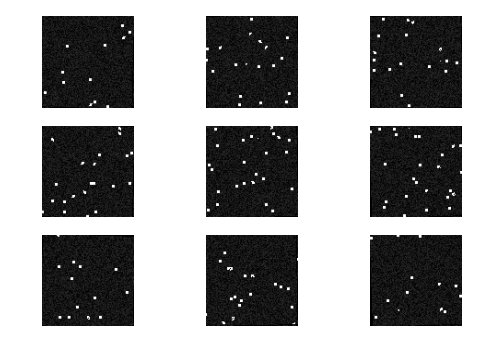

	Initial Error:  8.74587590753e+13


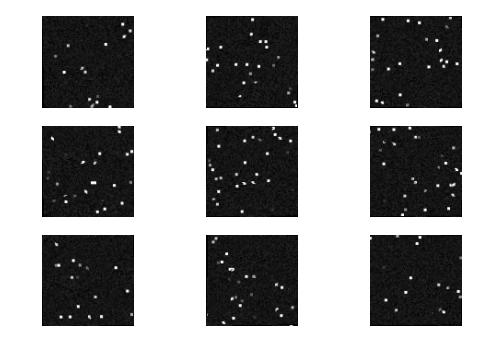

	Final Pipeline Error:  4.19871331879e+13
	Final Random Error:  1.12553340061e+14
	Pipeline Reduction Ratio:  0.519920776012
	Random Reduction Ratio:  -0.286930448715





Executing Validation Test With :  350  iterations
	Transformation Visualization:


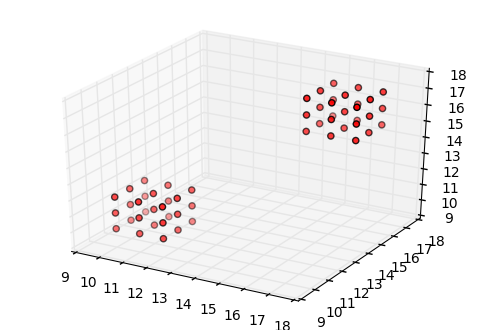

[[ 0.99187885  0.07145389  0.10521731 -0.69067194]
 [-0.07767273  0.99539143  0.05623929 -1.29116069]
 [-0.10071389 -0.06395508  0.99285772  1.10769124]
 [ 0.          0.          0.          1.        ]]


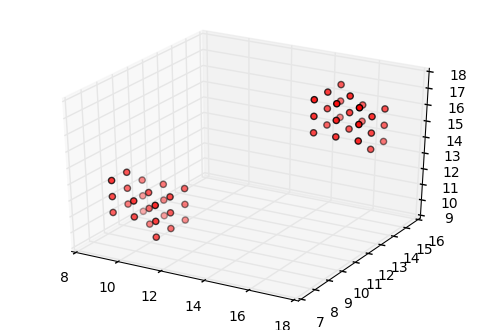

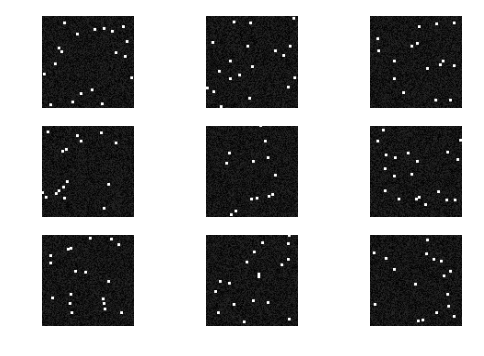

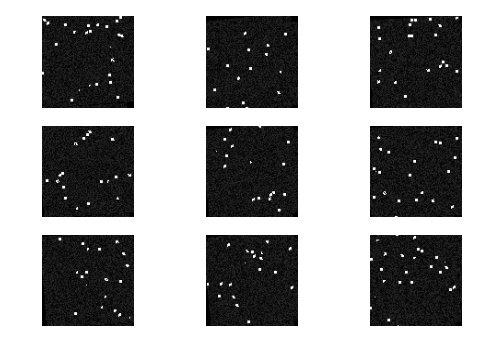

	Initial Error:  1.03177028473e+14


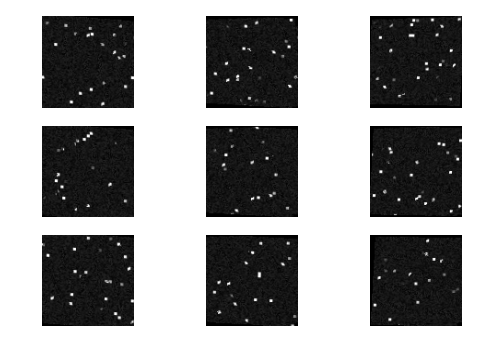

	Final Pipeline Error:  6.59121987951e+13
	Final Random Error:  9.88698614594e+13
	Pipeline Reduction Ratio:  0.361173705325
	Random Reduction Ratio:  0.0417454066812





Average Error Reduction Ratio:
	Pipeline:  0.491460588608
	Random:  -0.0909745970893

Error Reduction Ratio Variance
	Pipeline:  0.00938444340548
	Random:  0.0200040225471


In [54]:
pipeDat = []
randDat = []

for iterationNum in (150, 200, 250, 300, 350):
    
    pipeList = []
    randList = []
    
    for i in range(3):
        pipeline, random = executeValidationTest(iterationNum, False)
        pipeList.append(pipeline)
        randList.append(random)
    
    print '\nAverage Error Reduction Ratio:'
    print '\tPipeline: ', np.average(pipeList)
    print '\tRandom: ', np.average(randList)

    print '\nError Reduction Ratio Variance'
    print '\tPipeline: ', np.var(pipeList)
    print '\tRandom: ', np.var(randList)
    
    #save the data for later exploration
    pipeDat.append(pipeList)
    randDat.append(randList)

#### With L2 Loss Metric

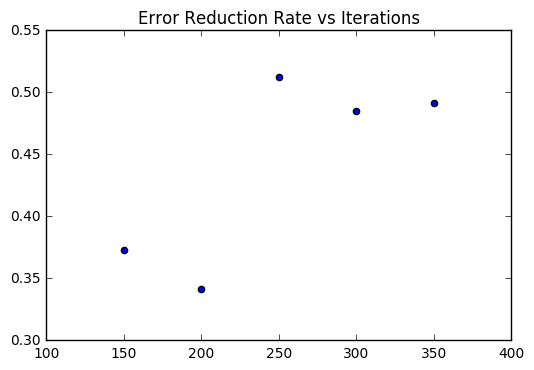

In [65]:
fig = plt.figure()
plt.title('Error Reduction Rate vs Iterations')
plt.scatter([150, 200, 250, 300, 350], [np.average(elem) for elem in pipeDat])
plt.show()

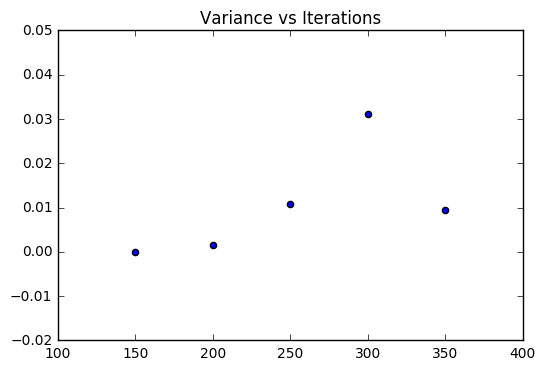

In [60]:
fig = plt.figure()
plt.title('Variance vs Iterations')
plt.scatter([150, 200, 250, 300, 350], [np.var(elem) for elem in pipeDat])
plt.show()


Executing Validation Test With :  150  iterations
	Transformation Visualization:


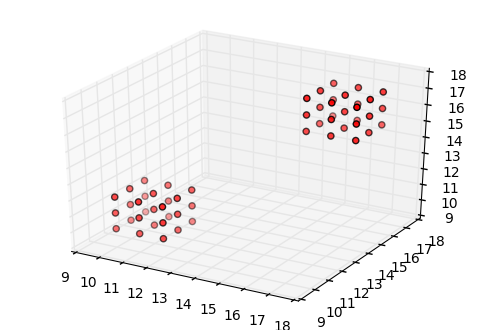

[[ 0.99063091  0.0633346  -0.1209923  -0.03996942]
 [-0.06787527  0.99712182 -0.03377918 -1.4652555 ]
 [ 0.11850467  0.04167509  0.99207854 -0.72816663]
 [ 0.          0.          0.          1.        ]]


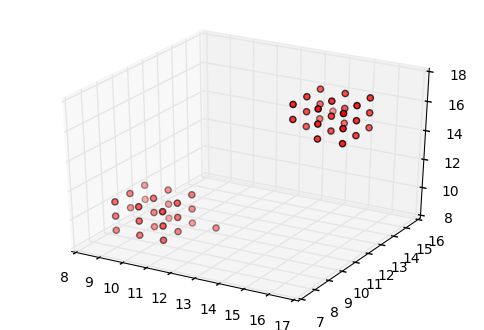

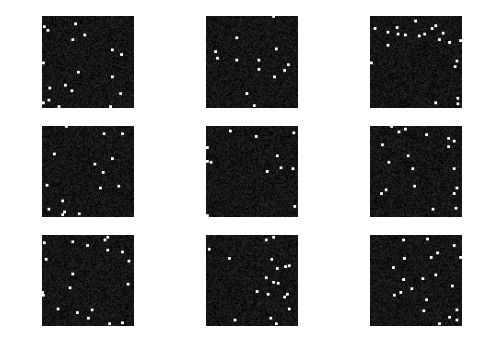

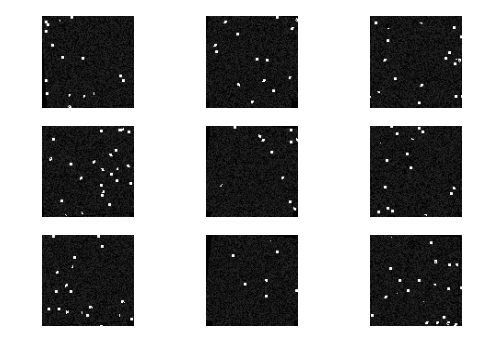

	Initial Error:  1.07433473272e+14


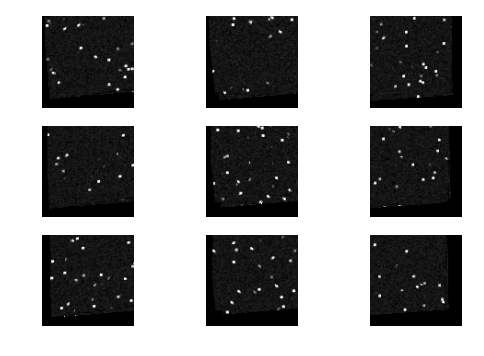

	Final Pipeline Error:  8.81824848402e+13
	Final Random Error:  1.07049862977e+14
	Pipeline Reduction Ratio:  0.179189854385
	Random Reduction Ratio:  0.00357067758712





Executing Validation Test With :  150  iterations
	Transformation Visualization:


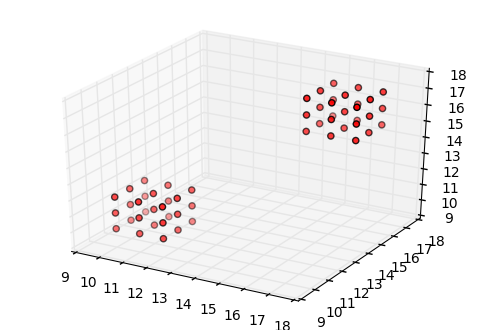

[[ 0.98653829  0.0823261  -0.14129623  1.11127029]
 [-0.07882071  0.9964301   0.03023829  0.25592427]
 [ 0.14328122 -0.01869416  0.98950544 -0.99164657]
 [ 0.          0.          0.          1.        ]]


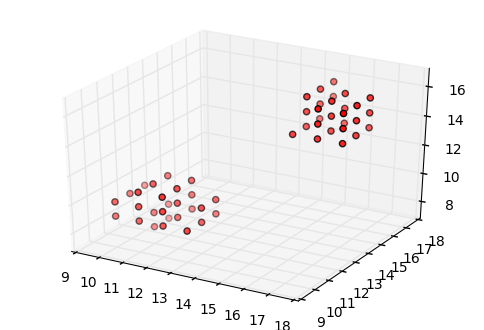

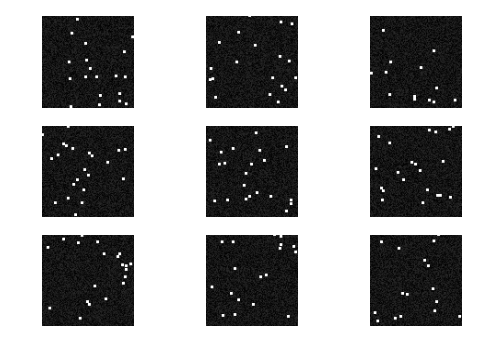

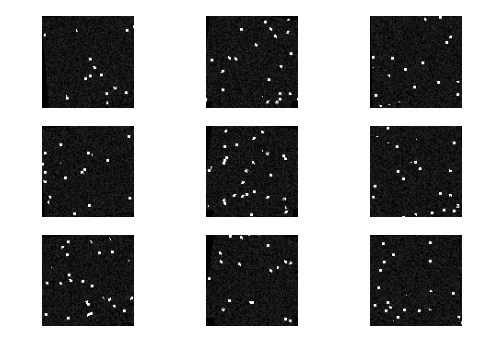

	Initial Error:  1.09687177133e+14


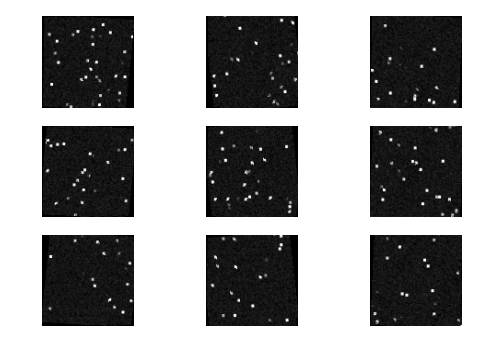

	Final Pipeline Error:  6.23358483192e+13
	Final Random Error:  1.11070939443e+14
	Pipeline Reduction Ratio:  0.431694296925
	Random Reduction Ratio:  -0.0126155339734





Executing Validation Test With :  150  iterations
	Transformation Visualization:


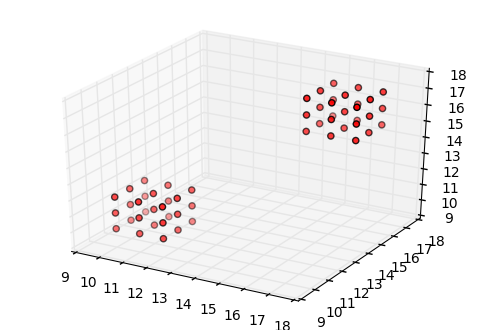

[[ 0.98169583 -0.12589351  0.14291299  1.3530049 ]
 [ 0.13846164  0.98699506 -0.08166465  0.21006771]
 [-0.13077336  0.09995782  0.98636036  1.1558135 ]
 [ 0.          0.          0.          1.        ]]


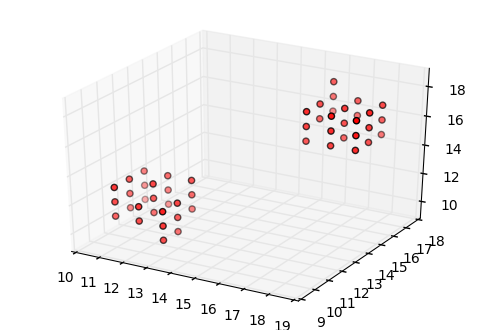

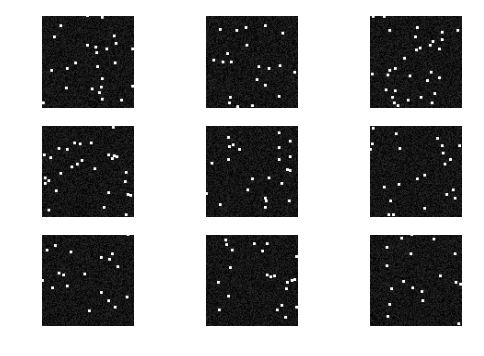

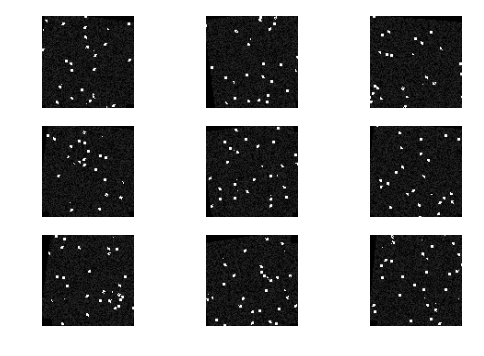

	Initial Error:  1.30769541681e+14


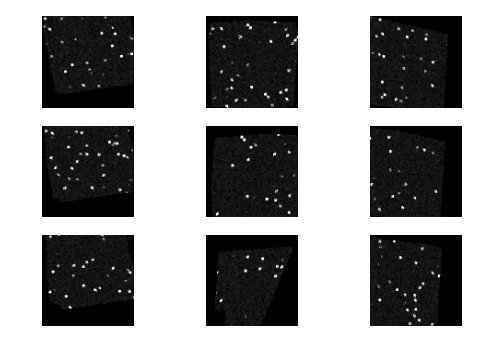

	Final Pipeline Error:  1.07648954392e+14
	Final Random Error:  1.30974822536e+14
	Pipeline Reduction Ratio:  0.176804070672
	Random Reduction Ratio:  -0.00156979103976





Average Error Reduction Ratio:
	Pipeline:  0.26256274066
	Random:  -0.0035382158087

Error Reduction Ratio Variance
	Pipeline:  0.0143036903228
	Random:  4.56029221494e-05

Executing Validation Test With :  200  iterations
	Transformation Visualization:


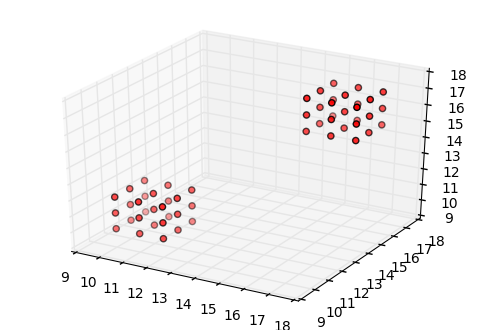

[[ 0.98874894  0.14605722  0.03229275 -0.78900388]
 [-0.14144755  0.98314839 -0.11580946  0.1217297 ]
 [-0.04866338  0.10993875  0.99274637 -0.27350536]
 [ 0.          0.          0.          1.        ]]


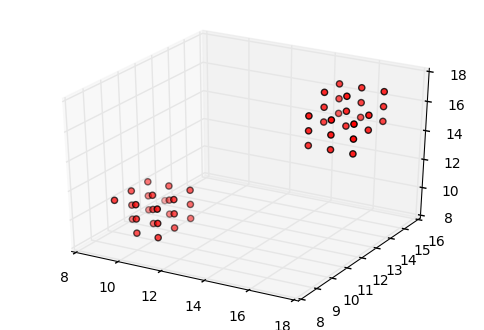

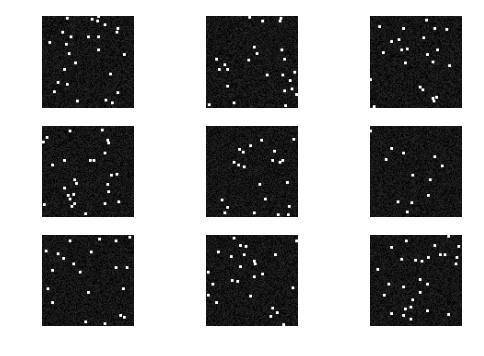

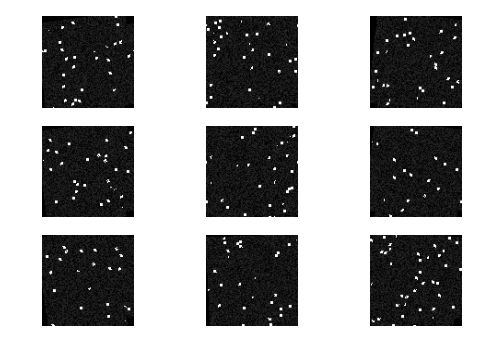

	Initial Error:  1.30365021583e+14


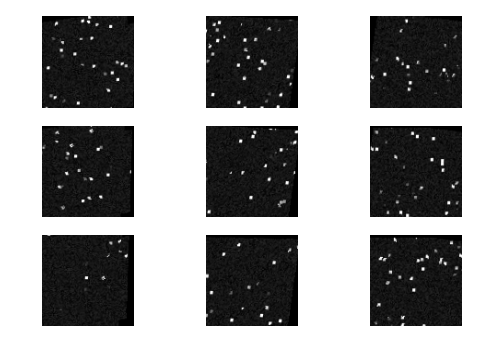

	Final Pipeline Error:  1.09383030888e+14
	Final Random Error:  1.30877443634e+14
	Pipeline Reduction Ratio:  0.160948009215
	Random Reduction Ratio:  -0.00393067131929





Executing Validation Test With :  200  iterations
	Transformation Visualization:


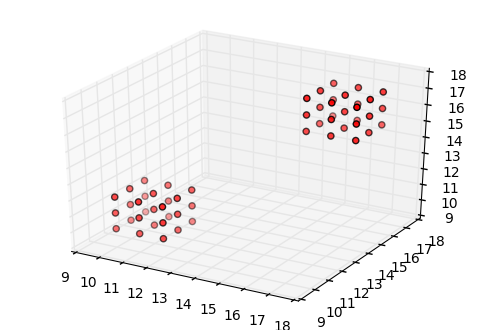

[[ 0.9930496  -0.04497964 -0.10876269 -0.24039722]
 [ 0.0328155   0.99326155 -0.11115141  0.57864908]
 [ 0.11302935  0.10680976  0.98783401 -0.64994701]
 [ 0.          0.          0.          1.        ]]


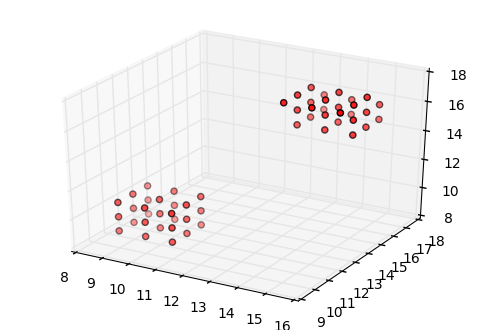

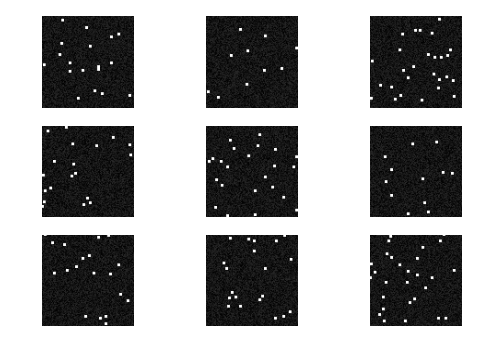

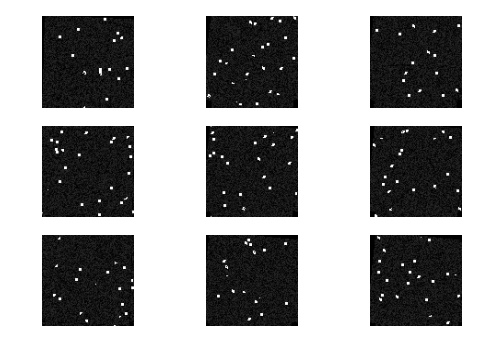

	Initial Error:  1.20883005408e+14


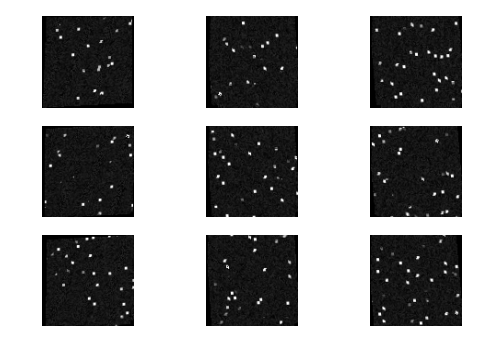

	Final Pipeline Error:  8.12240264897e+13
	Final Random Error:  1.21697624916e+14
	Pipeline Reduction Ratio:  0.328077373529
	Random Reduction Ratio:  -0.00673890845865





Executing Validation Test With :  200  iterations
	Transformation Visualization:


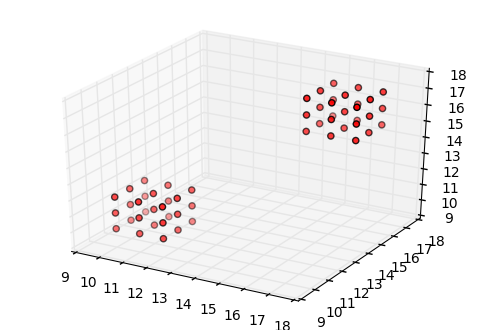

[[ 0.99117214 -0.04717738  0.12390354  1.46679394]
 [ 0.02914392  0.98921881  0.14351574 -0.2178685 ]
 [-0.12933841 -0.13863777  0.98186106 -0.260065  ]
 [ 0.          0.          0.          1.        ]]


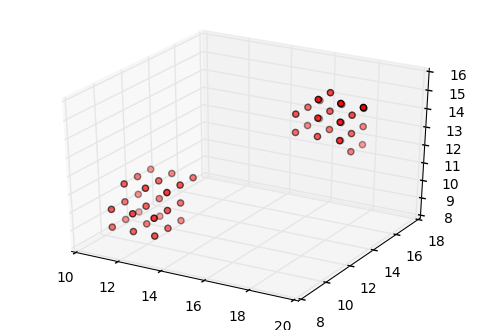

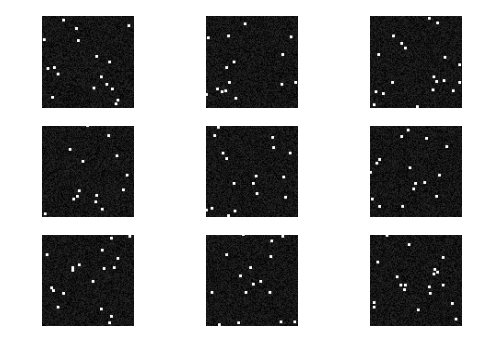

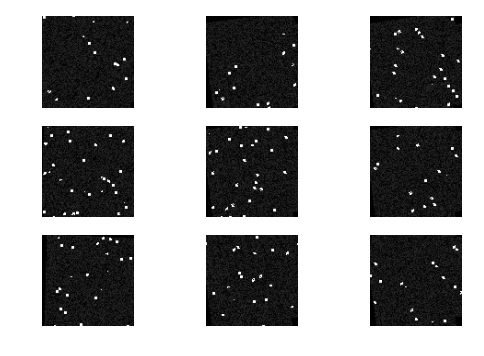

	Initial Error:  1.07574086722e+14


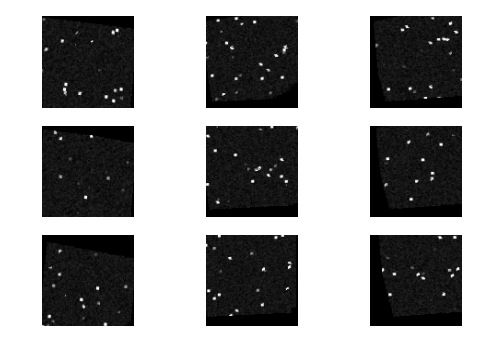

	Final Pipeline Error:  8.98630243028e+13
	Final Random Error:  1.07170328919e+14
	Pipeline Reduction Ratio:  0.1646406022
	Random Reduction Ratio:  0.00375329984654





Average Error Reduction Ratio:
	Pipeline:  0.217888661648
	Random:  -0.0023054266438

Error Reduction Ratio Variance
	Pipeline:  0.00607304865349
	Random:  1.96684493142e-05

Executing Validation Test With :  250  iterations
	Transformation Visualization:


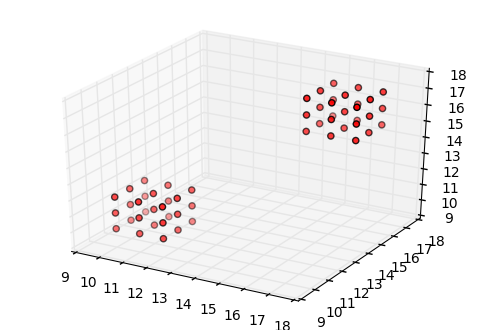

[[ 0.99013146 -0.12490328 -0.06355198 -1.3086086 ]
 [ 0.12884147  0.98971405  0.06217689 -0.40389801]
 [ 0.05513219 -0.06975143  0.99603975  0.48396975]
 [ 0.          0.          0.          1.        ]]


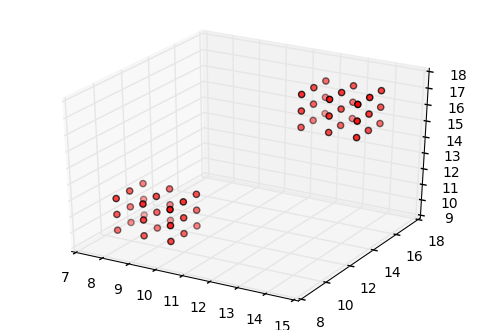

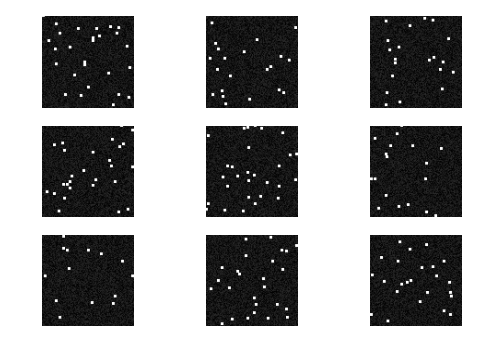

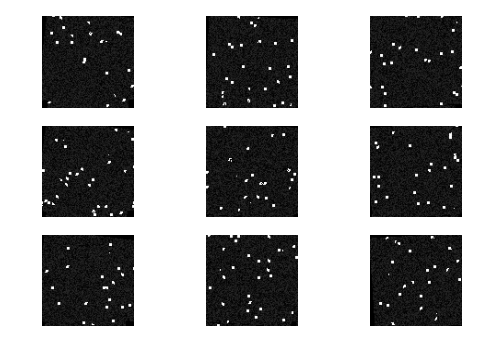

	Initial Error:  1.32744836308e+14


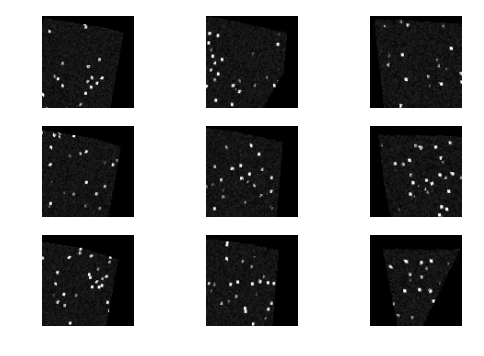

	Final Pipeline Error:  1.1144653755e+14
	Final Random Error:  1.33974892358e+14
	Pipeline Reduction Ratio:  0.160445403005
	Random Reduction Ratio:  -0.00926631938387





Executing Validation Test With :  250  iterations
	Transformation Visualization:


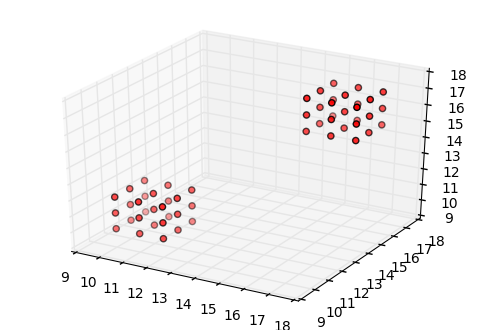

[[ 0.99318367 -0.07508504  0.08915405 -0.79285742]
 [ 0.07838593  0.99633922 -0.03411458  0.86068873]
 [-0.08626618  0.04087046  0.99543345  1.19985995]
 [ 0.          0.          0.          1.        ]]


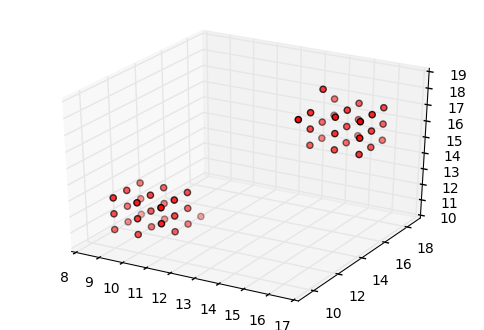

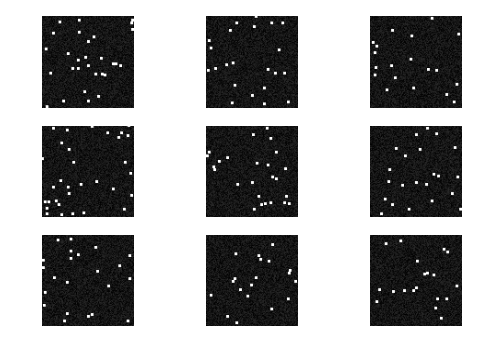

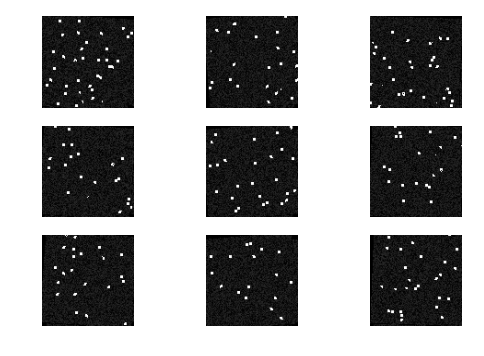

	Initial Error:  1.25414588051e+14


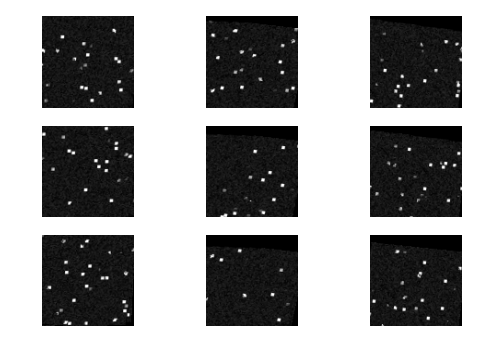

	Final Pipeline Error:  1.08229323828e+14
	Final Random Error:  1.30598064138e+14
	Pipeline Reduction Ratio:  0.137027633626
	Random Reduction Ratio:  -0.0413307268872





Executing Validation Test With :  250  iterations
	Transformation Visualization:


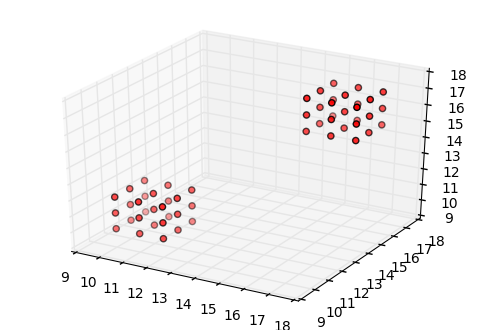

[[ 0.99962955  0.00390501  0.02693549 -0.83667333]
 [-0.00513171  0.99894548  0.04562445  0.1854329 ]
 [-0.02672892 -0.04574577  0.99859546  0.15199808]
 [ 0.          0.          0.          1.        ]]


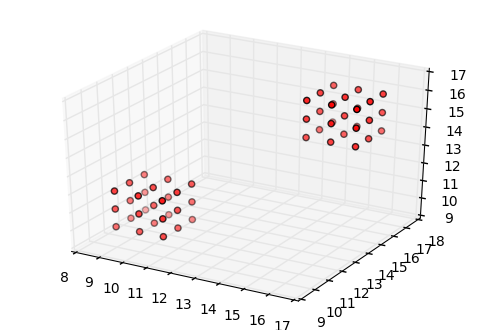

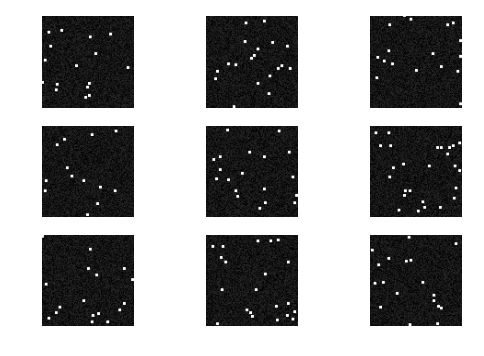

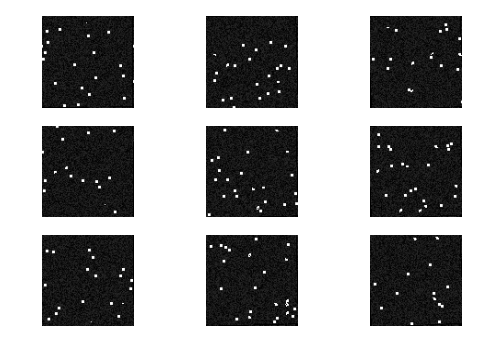

	Initial Error:  8.91234514493e+13


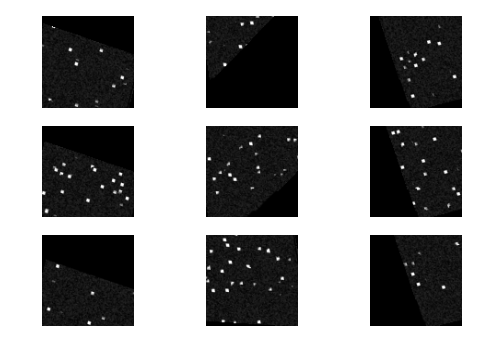

	Final Pipeline Error:  8.93620354755e+13
	Final Random Error:  1.04214926915e+14
	Pipeline Reduction Ratio:  -0.00267700613323
	Random Reduction Ratio:  -0.169332260138





Average Error Reduction Ratio:
	Pipeline:  0.0982653434992
	Random:  -0.073309768803

Error Reduction Ratio Variance
	Pipeline:  0.00518607762844
	Random:  0.0047815137925

Executing Validation Test With :  300  iterations
	Transformation Visualization:


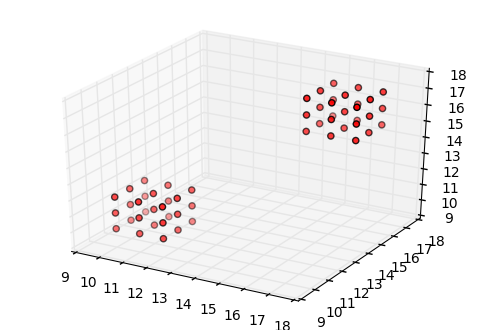

[[  9.88926460e-01   1.39039245e-01  -5.18897468e-02   1.22811113e+00]
 [ -1.38901018e-01   9.90286368e-01   6.27825295e-03   8.51419745e-01]
 [  5.22586324e-02   9.98808178e-04   9.98633085e-01  -1.15387160e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   1.00000000e+00]]


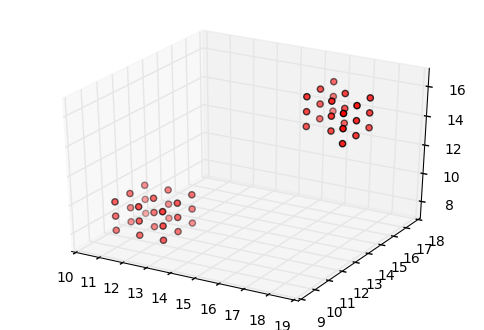

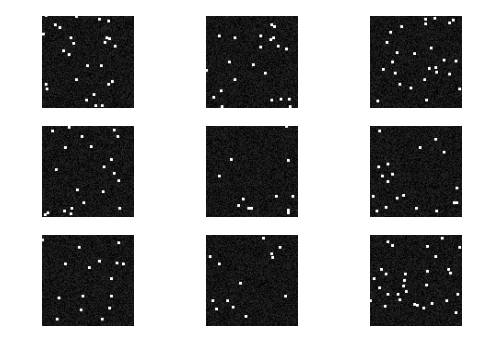

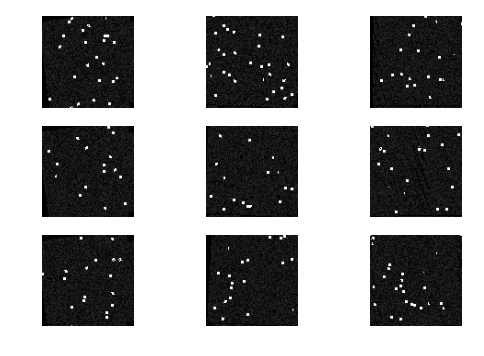

	Initial Error:  1.21934537502e+14


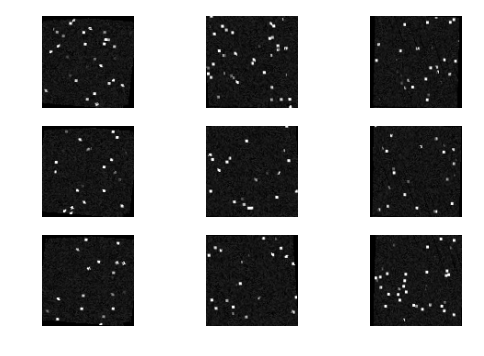

	Final Pipeline Error:  7.00024065467e+13
	Final Random Error:  1.21980386817e+14
	Pipeline Reduction Ratio:  0.425901733988
	Random Reduction Ratio:  -0.000376015821214





Executing Validation Test With :  300  iterations
	Transformation Visualization:


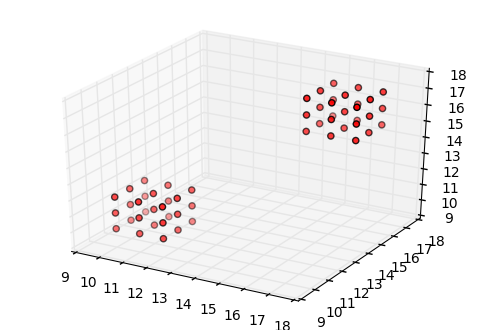

[[  9.97047922e-01   3.28025846e-02   6.94221320e-02   1.03938271e+00]
 [ -3.29597090e-02   9.99456055e-01   1.11877147e-03  -8.85178237e-01]
 [ -6.93476716e-02  -3.40360204e-03   9.97586746e-01  -1.33875718e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   1.00000000e+00]]


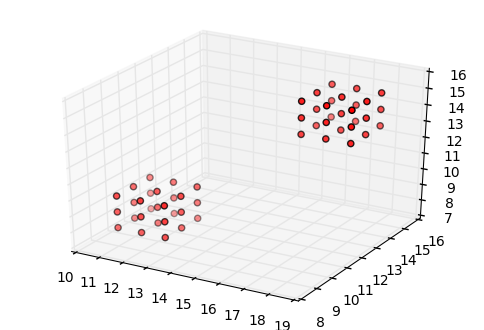

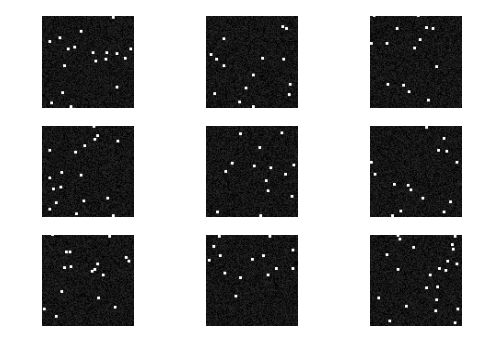

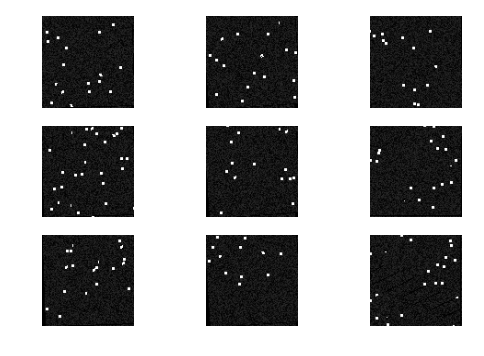

	Initial Error:  9.86709878453e+13


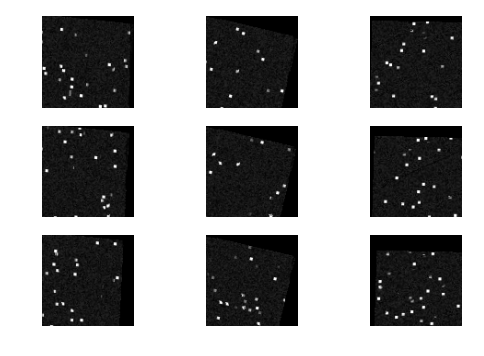

	Final Pipeline Error:  9.13125302615e+13
	Final Random Error:  1.05439593201e+14
	Pipeline Reduction Ratio:  0.0745756959007
	Random Reduction Ratio:  -0.0685977256659





Executing Validation Test With :  300  iterations
	Transformation Visualization:


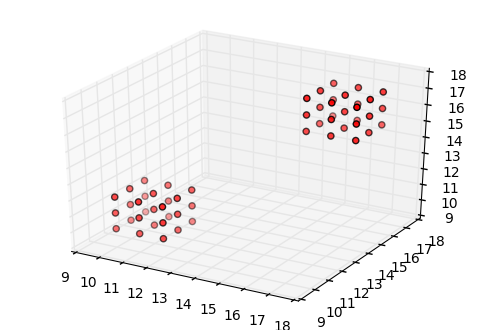

[[ 0.99372972 -0.10917676 -0.02411815 -1.06046855]
 [ 0.10975909  0.99366103  0.02430445  0.5972219 ]
 [ 0.02131179 -0.02679924  0.99941363 -0.04540855]
 [ 0.          0.          0.          1.        ]]


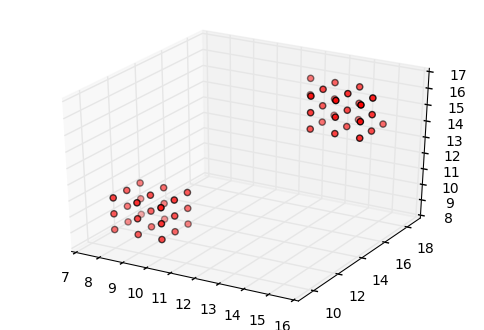

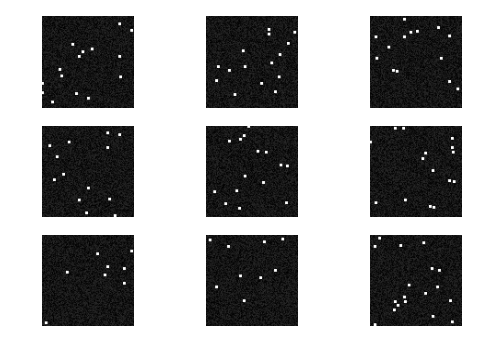

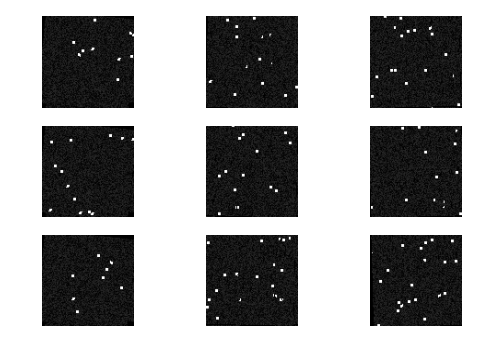

	Initial Error:  9.14673447327e+13


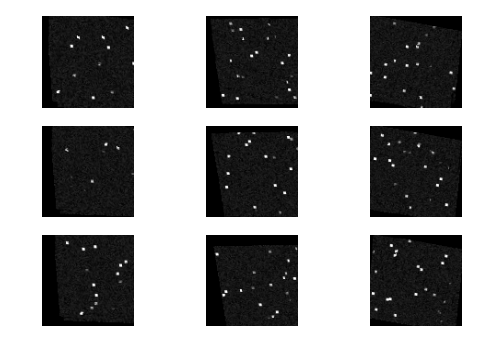

	Final Pipeline Error:  7.76650319566e+13
	Final Random Error:  9.34290355398e+13
	Pipeline Reduction Ratio:  0.15089880237
	Random Reduction Ratio:  -0.021446897937





Average Error Reduction Ratio:
	Pipeline:  0.217125410753
	Random:  -0.0301402131414

Error Reduction Ratio Variance
	Pipeline:  0.022764646002
	Random:  0.000813487146978

Executing Validation Test With :  350  iterations
	Transformation Visualization:


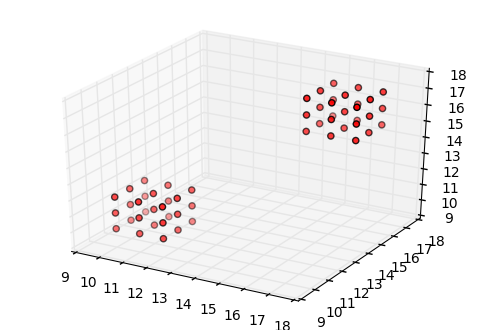

[[ 0.99541031  0.06082232  0.07388474  0.57364352]
 [-0.06113568  0.99812749  0.00198491 -1.0833919 ]
 [-0.07362567 -0.0064928   0.99726481 -0.71972225]
 [ 0.          0.          0.          1.        ]]


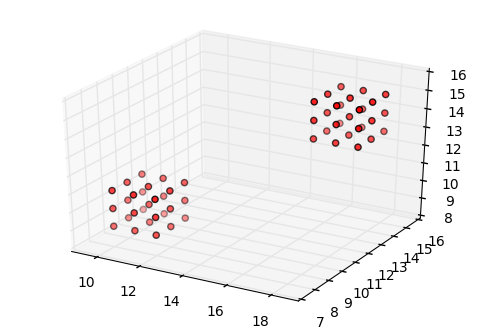

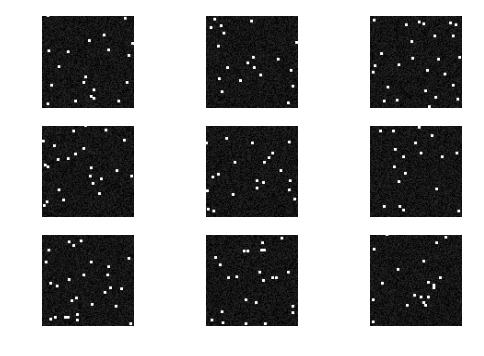

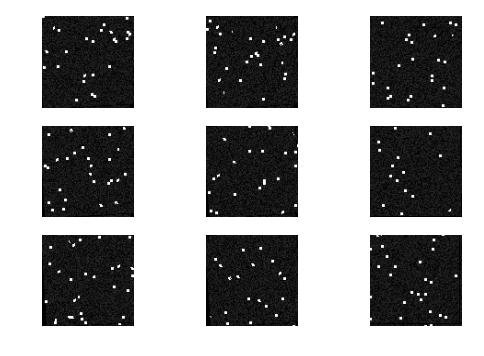

	Initial Error:  1.21647213049e+14


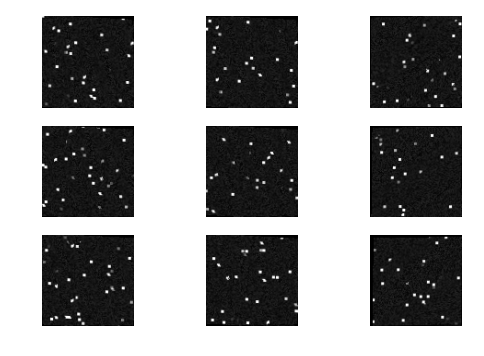

	Final Pipeline Error:  6.69217161295e+13
	Final Random Error:  1.30865115731e+14
	Pipeline Reduction Ratio:  0.449870535853
	Random Reduction Ratio:  -0.0757756996767





Executing Validation Test With :  350  iterations
	Transformation Visualization:


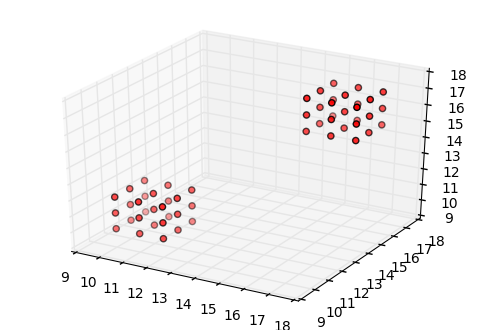

[[ 0.98712266 -0.14409015 -0.06947573  0.8858005 ]
 [ 0.14010562  0.98836574 -0.05919099 -0.46509686]
 [ 0.07719627  0.04869483  0.99582606 -1.47133009]
 [ 0.          0.          0.          1.        ]]


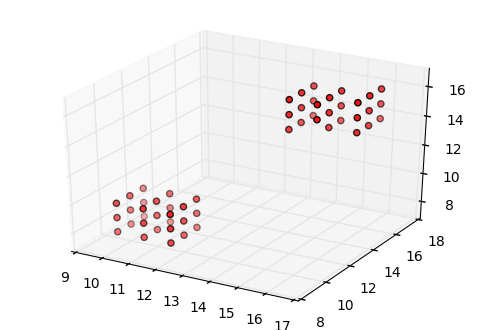

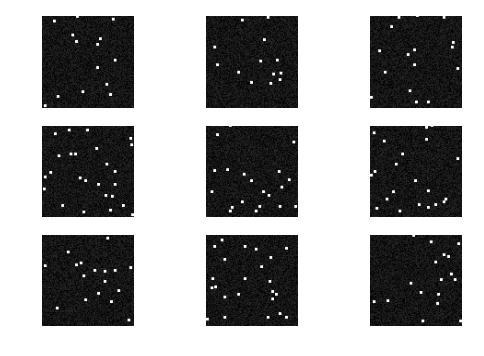

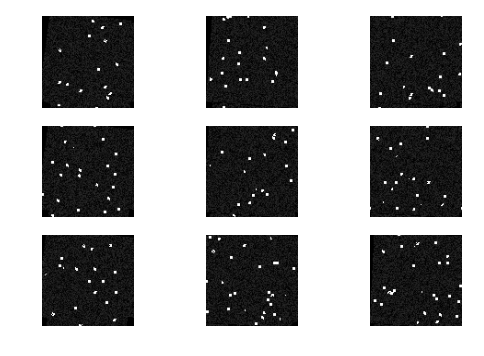

	Initial Error:  1.05697148739e+14


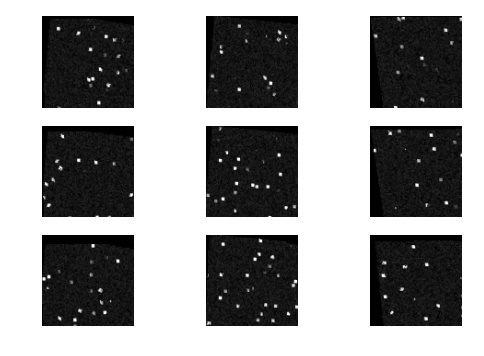

	Final Pipeline Error:  8.85199454185e+13
	Final Random Error:  1.05964615145e+14
	Pipeline Reduction Ratio:  0.162513402917
	Random Reduction Ratio:  -0.00253049783423





Executing Validation Test With :  350  iterations
	Transformation Visualization:


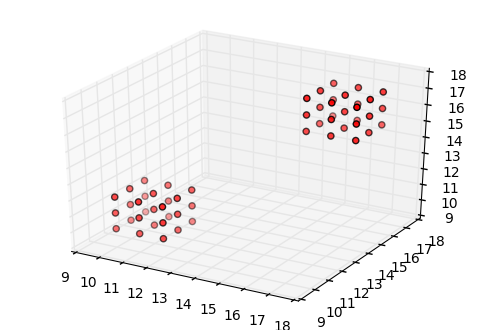

[[ 0.9856511  -0.06648793 -0.15514915  1.00349019]
 [ 0.08264761  0.99153487  0.10013982  0.95413737]
 [ 0.1471777  -0.11152563  0.9828025   1.41398071]
 [ 0.          0.          0.          1.        ]]


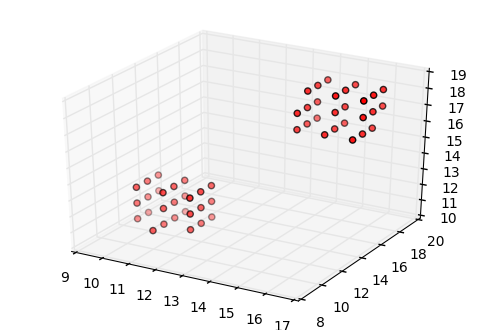

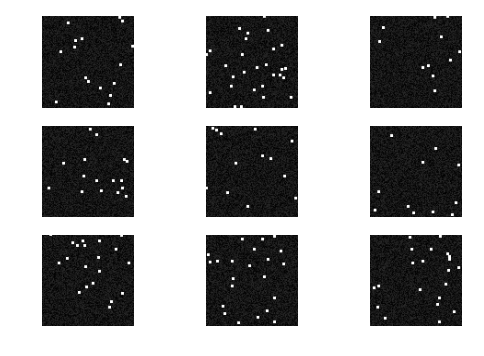

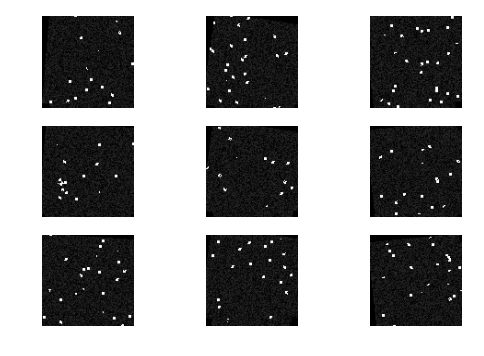

	Initial Error:  1.15191659501e+14


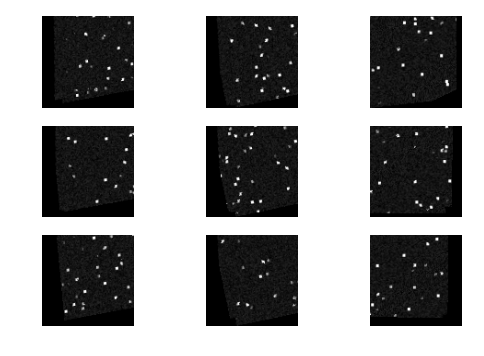

	Final Pipeline Error:  9.71476069228e+13
	Final Random Error:  1.15080853497e+14
	Pipeline Reduction Ratio:  0.156643741881
	Random Reduction Ratio:  0.000961927317233





Average Error Reduction Ratio:
	Pipeline:  0.256342560217
	Random:  -0.0257814233979

Error Reduction Ratio Variance
	Pipeline:  0.0187322808303
	Random:  0.00125174666923


In [53]:
miPipeDat = []
miRandDat = []

for iterationNum in (150, 200, 250, 300, 350):
    
    pipeList = []
    randList = []
    
    for i in range(3):
        pipeline, random = executeValidationTest(iterationNum, True)
        pipeList.append(pipeline)
        randList.append(random)
    
    print '\nAverage Error Reduction Ratio:'
    print '\tPipeline: ', np.average(pipeList)
    print '\tRandom: ', np.average(randList)

    print '\nError Reduction Ratio Variance'
    print '\tPipeline: ', np.var(pipeList)
    print '\tRandom: ', np.var(randList)
    
    #save the data for later exploration
    miPipeDat.append(pipeList)
    miRandDat.append(randList)

#### With MI Loss

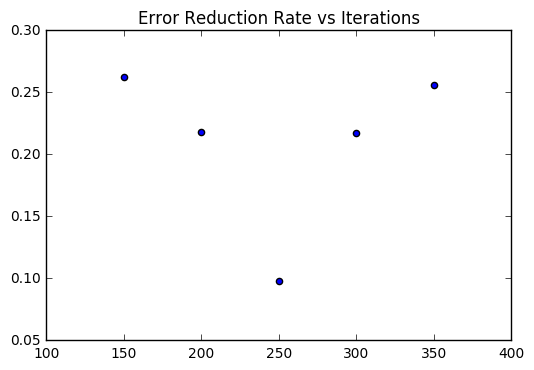

In [55]:
fig = plt.figure()
plt.title('Error Reduction Rate vs Iterations')
plt.scatter([150, 200, 250, 300, 350], [np.average(elem) for elem in miPipeDat])
plt.show()

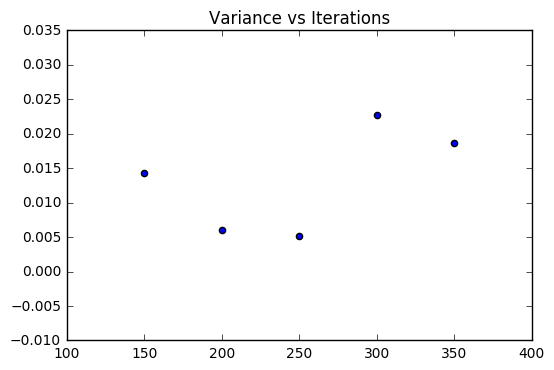

In [56]:
fig = plt.figure()
plt.title('Variance vs Iterations')
plt.scatter([150, 200, 250, 300, 350], [np.var(elem) for elem in miPipeDat])
plt.show()

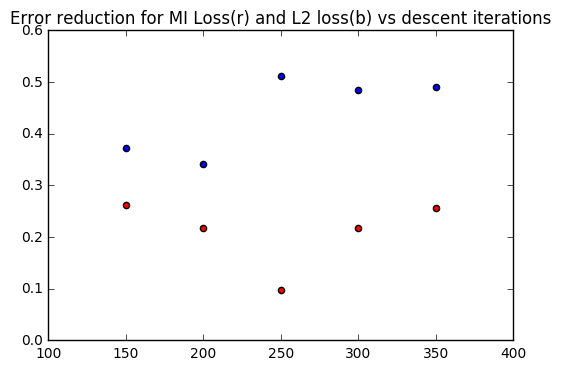

In [66]:
fig = plt.figure()
plt.scatter([150, 200, 250, 300, 350],[np.average(elem) for elem in miPipeDat], c='r')
plt.scatter([150, 200, 250, 300, 350],[np.average(elem) for elem in pipeDat], c='b')
plt.title('Error reduction for MI Loss(r) and L2 loss(b) vs descent iterations')
plt.show()

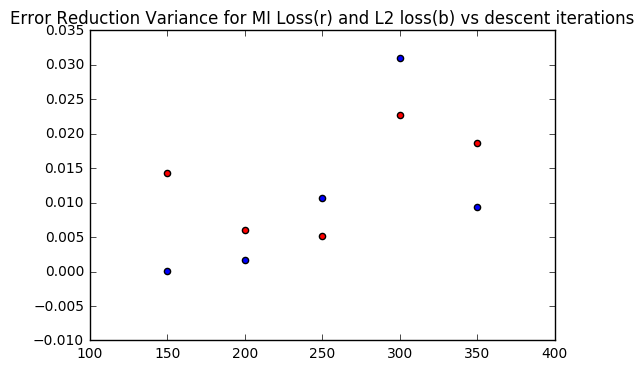

In [68]:
fig = plt.figure()
plt.scatter([150, 200, 250, 300, 350],[np.var(elem) for elem in miPipeDat], c='r')
plt.scatter([150, 200, 250, 300, 350],[np.var(elem) for elem in pipeDat], c='b')
plt.title('Error Reduction Variance for MI Loss(r) and L2 loss(b) vs descent iterations')
plt.show()

The results of both NDREg tests were underwhelming. The aveage error reduction of the pipeline is hovering around 16%, regardless of iterations of gradient descent or loss metric.

One interesting relationship that I saw was that the data sets with the most variation tended to be the ones with the highest reduction in error. I am going to attempt to introduce variation by running NDReg with a small number of iterations many times, and selecting the best output (as determined by loss reduction rate)

In [69]:
def executeNDReg2Test(iterations, MI):

    print '\nExecuting Validation Test With : ', iterations, ' NDReg iterations'
    
    #generate an display data
    itkVolume, rigidVolume, curTransform = generateTestVolume()
    print '\tTransformation Visualization:'
    visualizeTransform(curTransform)
    ndreg.imgShow(itkVolume, vmax=60000)
    ndreg.imgShow(rigidVolume, vmax=60000)
    
    #calculate initial error
    initialErr = np.sum((itk.GetArrayFromImage(itkVolume)-itk.GetArrayFromImage(rigidVolume))**2)
    print '\tInitial Error: ', initialErr
    
    finalVolume = None
    bestReduction = 0.
    for i in range(iterations):
    #perform transform
        transform = register(rigidVolume, itkVolume, 250, MI)
        resultVolume = ndreg.imgApplyAffine(rigidVolume, transform, size=itkVolume.GetSize(), spacing=itkVolume.GetSpacing())
        finalPipeErr = np.sum((itk.GetArrayFromImage(itkVolume)-itk.GetArrayFromImage(resultVolume))**2)
        if finalPipeErr > bestReduction:
            finalVolume = resultVolume
            bestReduction = finalPipeErr
    
    #perform random transform
    randMatrix = applyRigid(itk.GetArrayFromImage(rigidVolume), getTransform())

    #calculate final error
    finalPipeErr = np.sum((itk.GetArrayFromImage(itkVolume)-itk.GetArrayFromImage(finalVolume))**2)
    finalRandErr = np.sum((itk.GetArrayFromImage(itkVolume)-randMatrix)**2)
    print '\tFinal Pipeline Error: ', finalPipeErr
    print '\tFinal Random Error: ', finalRandErr

    #get the reduction in error
    pipeRatio = (initialErr - finalPipeErr)/initialErr 
    randRatio = (initialErr - finalRandErr)/initialErr 
    
    print '\tPipeline Reduction Ratio: ', pipeRatio
    print '\tRandom Reduction Ratio: ', randRatio
    print '\n\n\n'
    
    return pipeRatio, randRatio


Executing Validation Test With :  1  NDReg iterations
	Transformation Visualization:


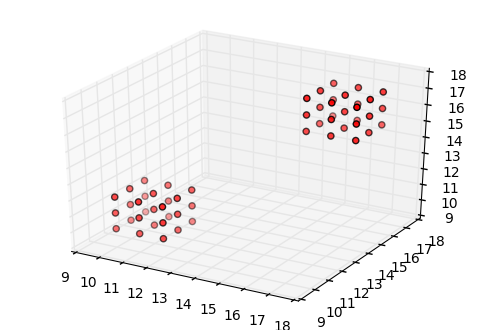

[[  9.98873555e-01  -4.74419285e-02  -9.40079598e-04  -7.63968066e-01]
 [  4.73984498e-02   9.96632167e-01   6.69156908e-02  -6.29173227e-01]
 [ -2.23769585e-03  -6.68848723e-02   9.97758190e-01  -8.75925959e-01]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   1.00000000e+00]]


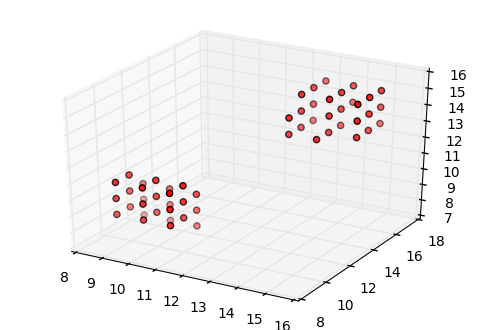

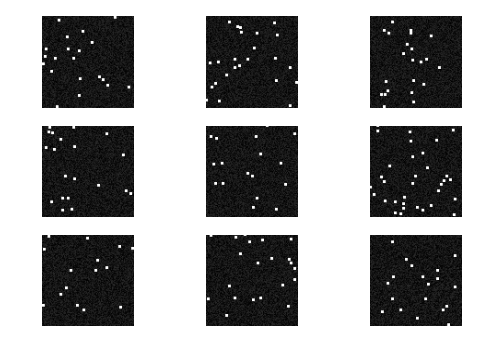

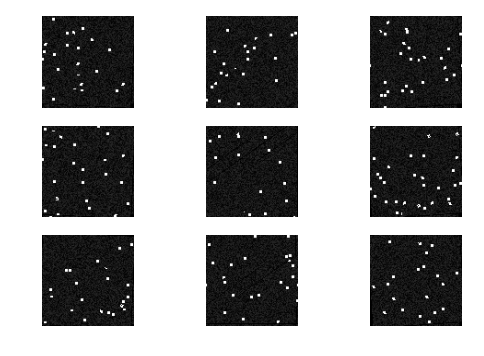

	Initial Error:  1.19837234059e+14
	Final Pipeline Error:  1.10274246976e+14
	Final Random Error:  1.31281016461e+14
	Pipeline Reduction Ratio:  0.0797997980973
	Random Reduction Ratio:  -0.0954943802911





Executing Validation Test With :  1  NDReg iterations
	Transformation Visualization:


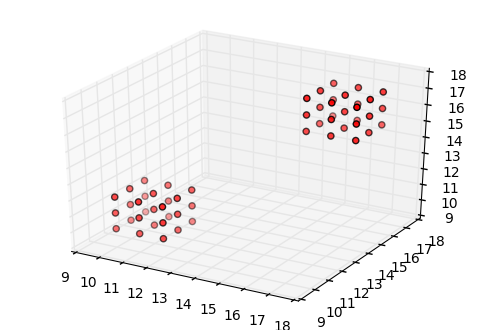

[[ 0.9932227  -0.08117458 -0.08318264  0.26914623]
 [ 0.06849293  0.98700582 -0.1453555   1.339506  ]
 [ 0.09390092  0.13867296  0.98587648  1.44494858]
 [ 0.          0.          0.          1.        ]]


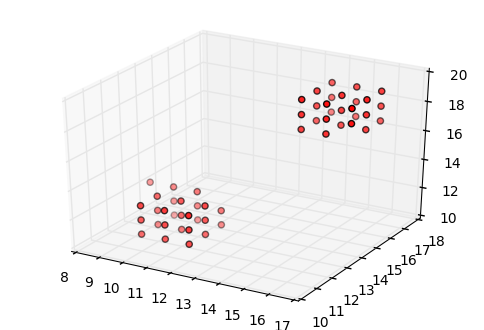

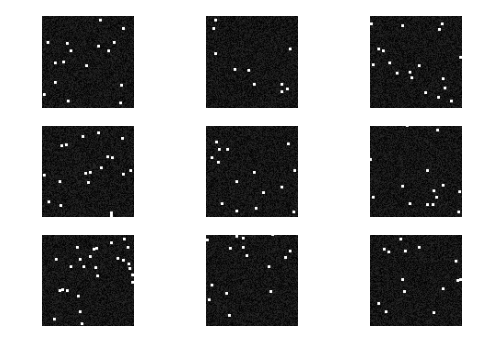

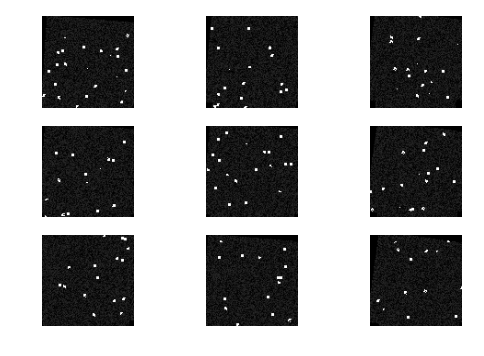

	Initial Error:  1.00003681164e+14
	Final Pipeline Error:  6.69532671612e+13
	Final Random Error:  1.01730798463e+14
	Pipeline Reduction Ratio:  0.330491974077
	Random Reduction Ratio:  -0.0172705372329





Executing Validation Test With :  1  NDReg iterations
	Transformation Visualization:


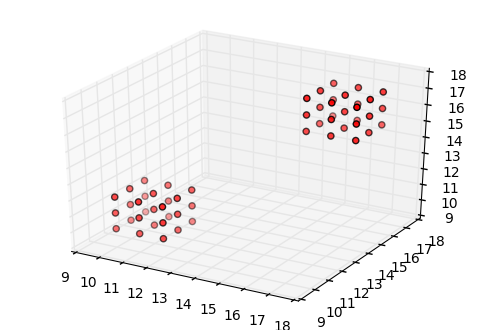

[[ 0.99354748  0.1134056   0.00160739  0.69694587]
 [-0.11337971  0.9927578   0.03971147  0.48278114]
 [ 0.00290775 -0.03963747  0.9992099  -0.55426105]
 [ 0.          0.          0.          1.        ]]


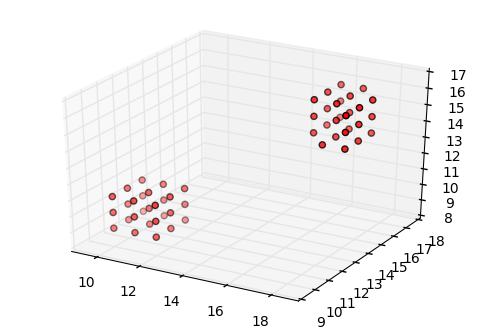

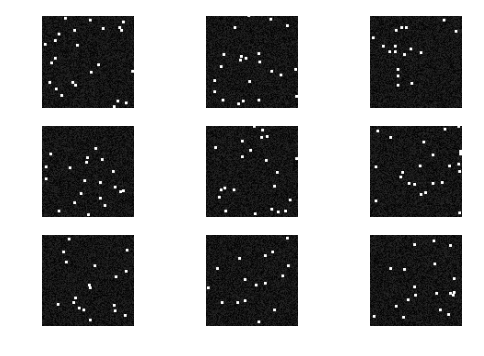

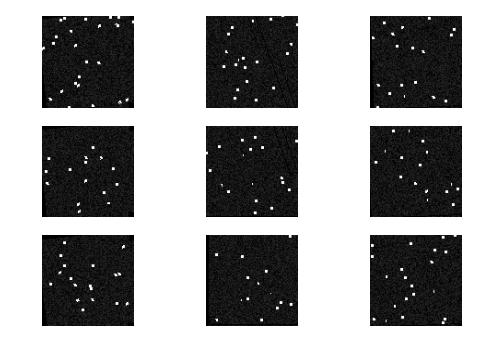

	Initial Error:  1.12613297951e+14
	Final Pipeline Error:  6.50707887003e+13
	Final Random Error:  1.15763297434e+14
	Pipeline Reduction Ratio:  0.422174912871
	Random Reduction Ratio:  -0.0279718251772





Average Error Reduction Ratio:
	Pipeline:  0.277488895015
	Random:  -0.0469122475671

Error Reduction Ratio Variance
	Pipeline:  0.0209414497311
	Random:  0.00119919807062

Executing Validation Test With :  2  NDReg iterations
	Transformation Visualization:


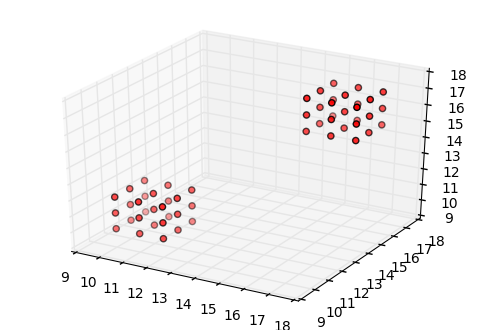

[[ 0.99573965  0.08041878  0.04511497 -0.40786942]
 [-0.07354933  0.98777783 -0.13742435 -0.09753358]
 [-0.05561507  0.1335207   0.9894843   0.64188292]
 [ 0.          0.          0.          1.        ]]


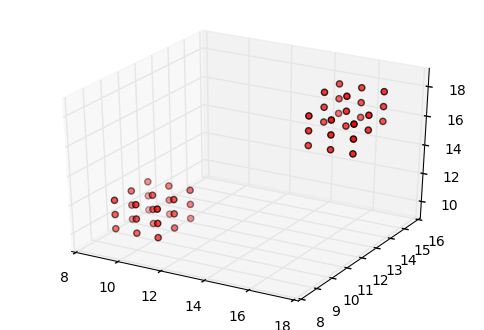

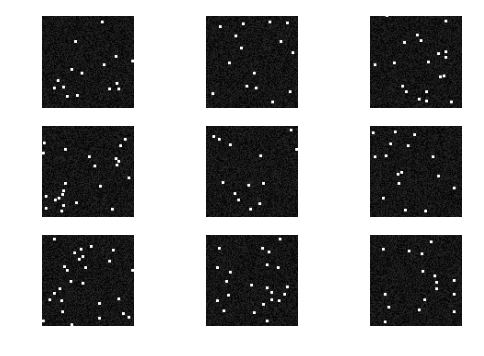

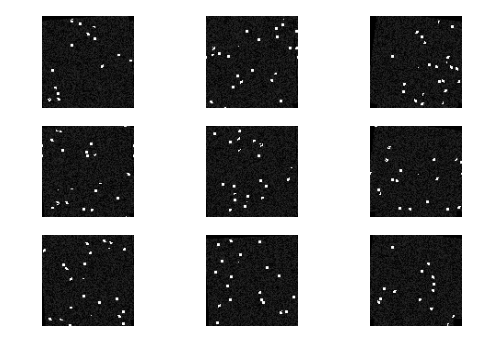

	Initial Error:  1.03738551781e+14
	Final Pipeline Error:  6.91605057351e+13
	Final Random Error:  7.54591842352e+13
	Pipeline Reduction Ratio:  0.333319151387
	Random Reduction Ratio:  0.272602297412





Executing Validation Test With :  2  NDReg iterations
	Transformation Visualization:


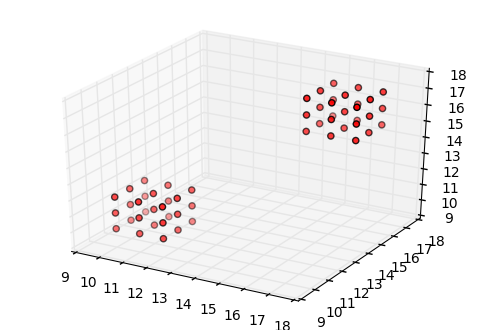

[[ 0.99657564  0.03320857  0.07572441  1.43244605]
 [-0.04334973  0.98969371  0.13648138  0.40774151]
 [-0.07041162 -0.13929665  0.98774422  1.03835657]
 [ 0.          0.          0.          1.        ]]


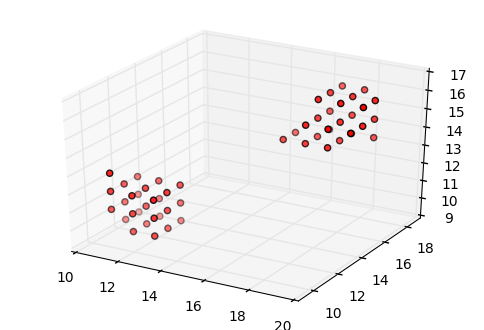

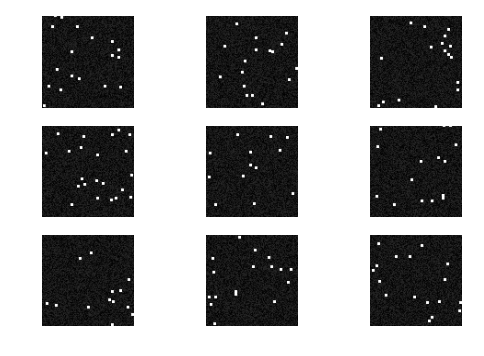

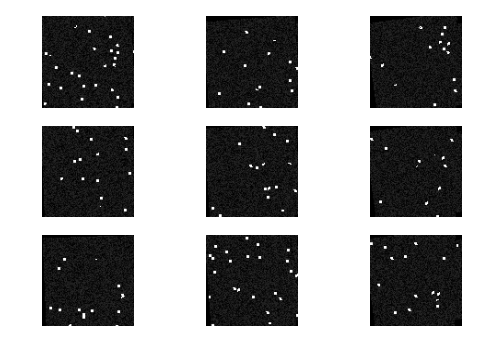

	Initial Error:  9.66206362005e+13
	Final Pipeline Error:  6.41428930368e+13
	Final Random Error:  9.7598091613e+13
	Pipeline Reduction Ratio:  0.336136714069
	Random Reduction Ratio:  -0.0101164249261





Executing Validation Test With :  2  NDReg iterations
	Transformation Visualization:


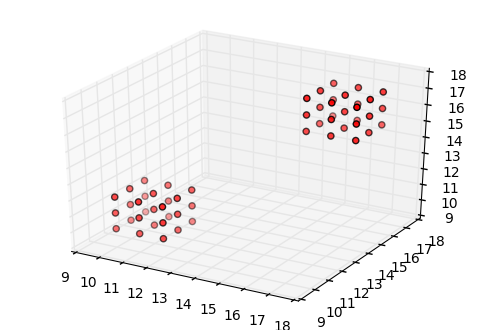

[[ 0.99776151  0.05757976  0.03400793 -0.9619074 ]
 [-0.06181296  0.98815429  0.14046444 -1.35487402]
 [-0.02551717 -0.14225215  0.98950149 -1.20785781]
 [ 0.          0.          0.          1.        ]]


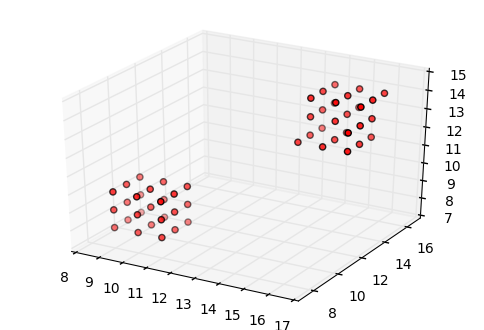

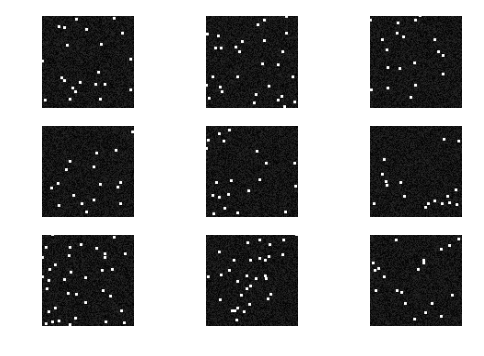

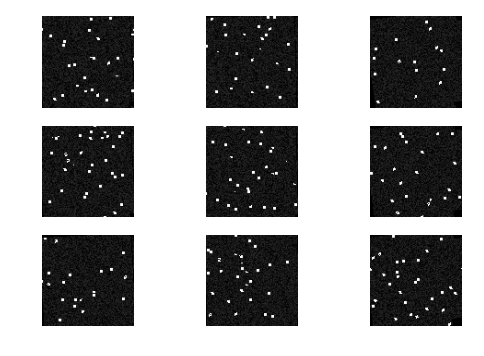

	Initial Error:  1.35594027259e+14
	Final Pipeline Error:  8.3908630401e+13
	Final Random Error:  1.35284876776e+14
	Pipeline Reduction Ratio:  0.381177533426
	Random Reduction Ratio:  0.00227997124182





Average Error Reduction Ratio:
	Pipeline:  0.350211132961
	Random:  0.0882552812426

Error Reduction Ratio Variance
	Pipeline:  0.000480782088792
	Random:  0.0170175229583

Executing Validation Test With :  3  NDReg iterations
	Transformation Visualization:


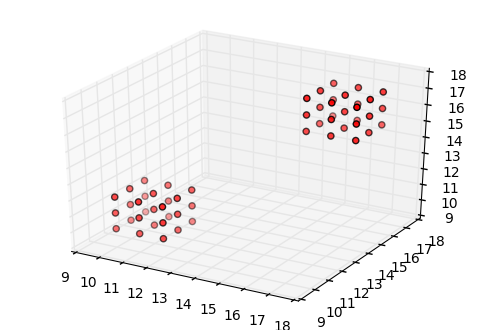

[[  9.95369346e-01  -1.69056416e-03   9.61093523e-02  -1.51777524e-03]
 [ -1.31511165e-03   9.99512248e-01   3.12015567e-02  -2.63277355e-01]
 [ -9.61152229e-02  -3.11834676e-02   9.94881629e-01   1.39052110e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   1.00000000e+00]]


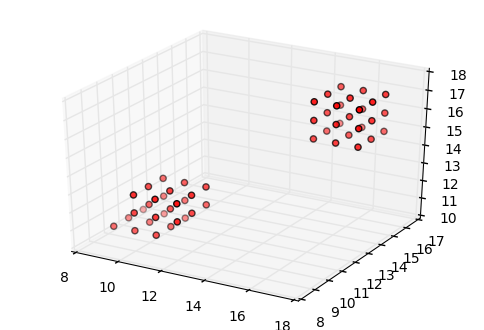

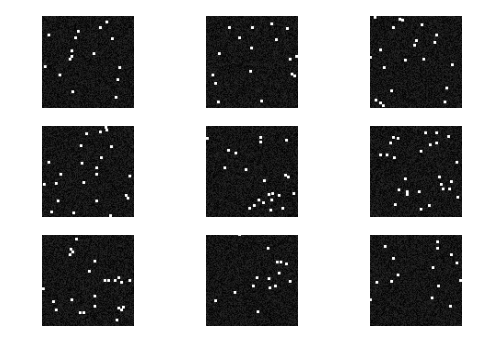

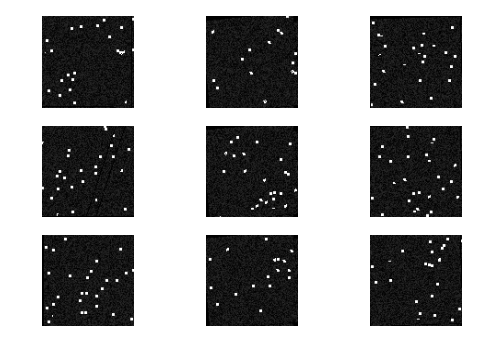

	Initial Error:  1.2362261931e+14
	Final Pipeline Error:  7.66072731121e+13
	Final Random Error:  1.27212514581e+14
	Pipeline Reduction Ratio:  0.380313460923
	Random Reduction Ratio:  -0.0290391458315





Executing Validation Test With :  3  NDReg iterations
	Transformation Visualization:


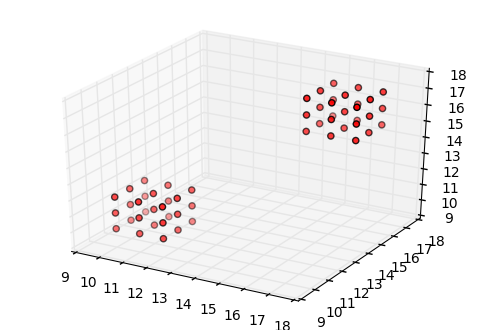

[[ 0.99773334 -0.06502099  0.01733386 -0.17924444]
 [ 0.06593133  0.99610812 -0.05849513  0.5896267 ]
 [-0.01346298  0.05950539  0.99813719  0.03294862]
 [ 0.          0.          0.          1.        ]]


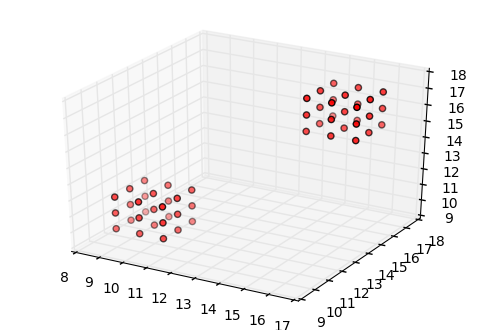

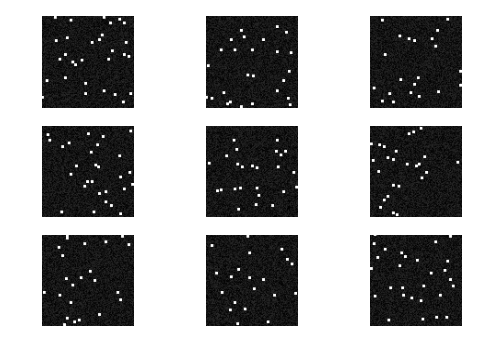

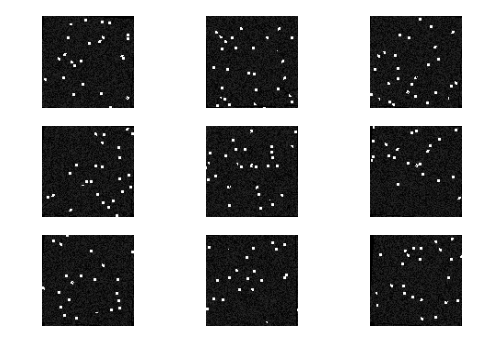

	Initial Error:  1.21774168389e+14
	Final Pipeline Error:  4.41960340808e+13
	Final Random Error:  1.31048502528e+14
	Pipeline Reduction Ratio:  0.637065605411
	Random Reduction Ratio:  -0.0761601106527





Executing Validation Test With :  3  NDReg iterations
	Transformation Visualization:


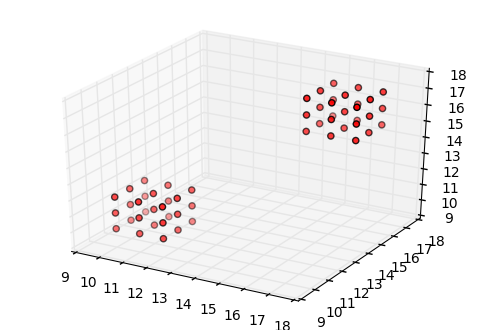

[[ 0.99229445 -0.12368329 -0.00736023  0.10135089]
 [ 0.12353532  0.9830426   0.13552223  0.41854505]
 [-0.00952642 -0.1353872   0.99074697  1.10896124]
 [ 0.          0.          0.          1.        ]]


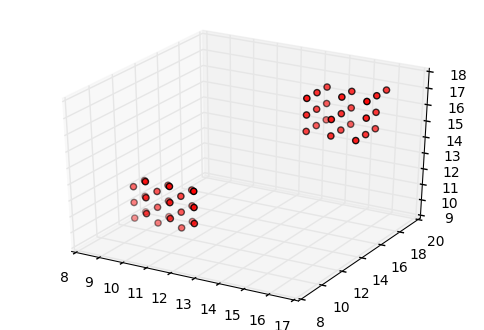

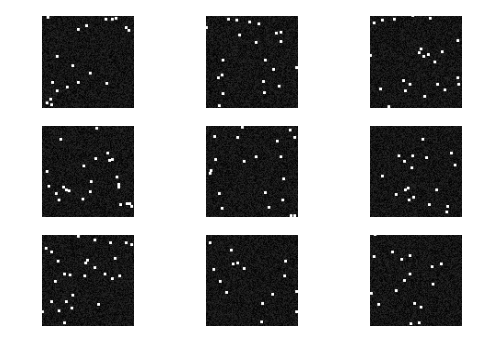

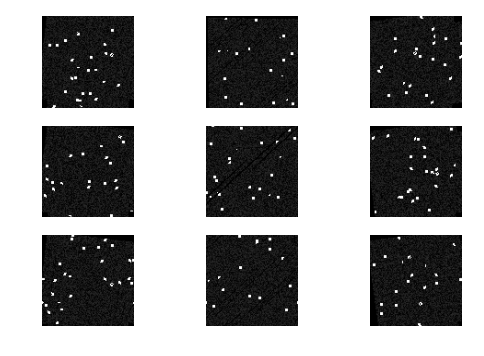

	Initial Error:  1.17047900537e+14
	Final Pipeline Error:  7.79154518206e+13
	Final Random Error:  1.15327466797e+14
	Pipeline Reduction Ratio:  0.334328497451
	Random Reduction Ratio:  0.0146985442011





Average Error Reduction Ratio:
	Pipeline:  0.450569187928
	Random:  -0.0301669040944

Error Reduction Ratio Variance
	Pipeline:  0.0177428930112
	Random:  0.00137651844632

Executing Validation Test With :  4  NDReg iterations
	Transformation Visualization:


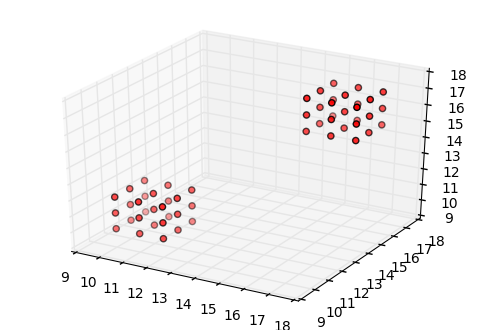

[[ 0.98848709 -0.13883552  0.06014956 -1.20115628]
 [ 0.13636548  0.98970712  0.04340821 -1.29199881]
 [-0.06555705 -0.03470613  0.99724508 -0.95736844]
 [ 0.          0.          0.          1.        ]]


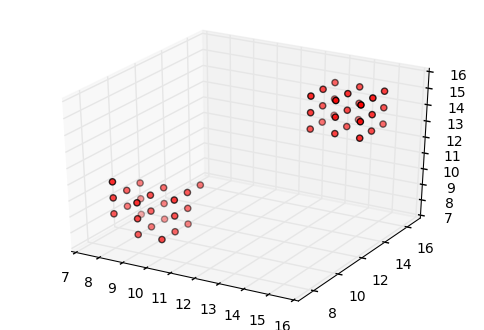

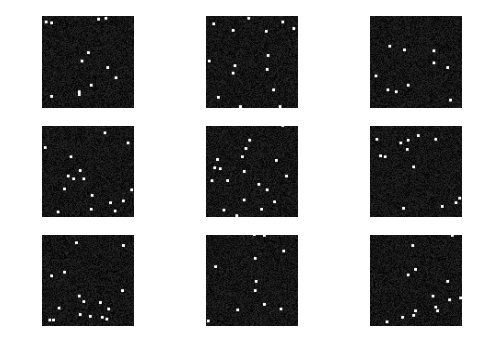

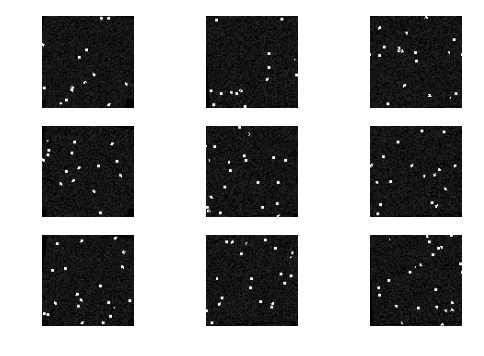

	Initial Error:  9.76593711953e+13
	Final Pipeline Error:  6.2000551574e+13
	Final Random Error:  9.76372235189e+13
	Pipeline Reduction Ratio:  0.365134642839
	Random Reduction Ratio:  0.000226784957654





Executing Validation Test With :  4  NDReg iterations
	Transformation Visualization:


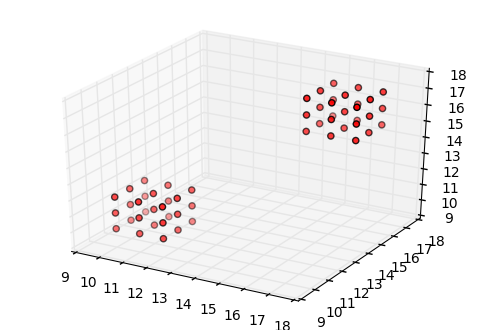

[[ 0.99636804  0.05261721 -0.06694895 -1.09040361]
 [-0.05487415  0.99796973 -0.03233012  0.77553006]
 [ 0.0651119   0.03588647  0.99723247 -1.46542969]
 [ 0.          0.          0.          1.        ]]


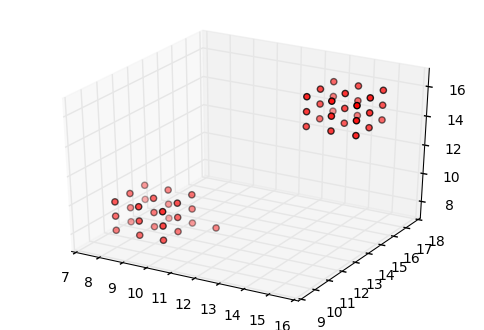

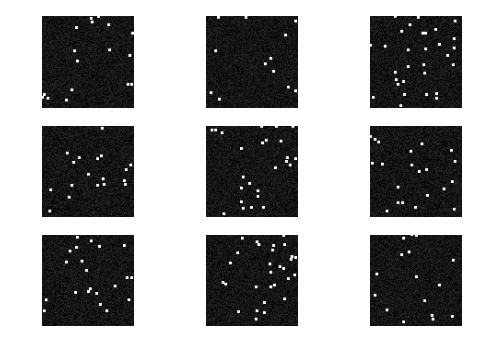

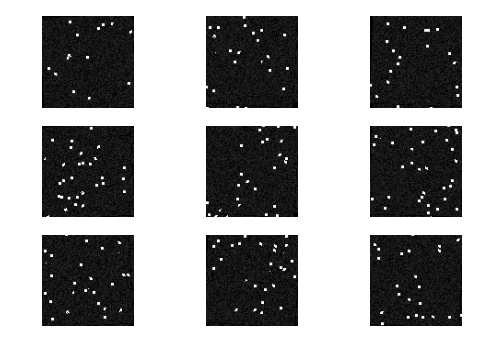

	Initial Error:  1.23126783934e+14
	Final Pipeline Error:  7.09616557203e+13
	Final Random Error:  1.31832668925e+14
	Pipeline Reduction Ratio:  0.42367002976
	Random Reduction Ratio:  -0.0707066709027





Executing Validation Test With :  4  NDReg iterations
	Transformation Visualization:


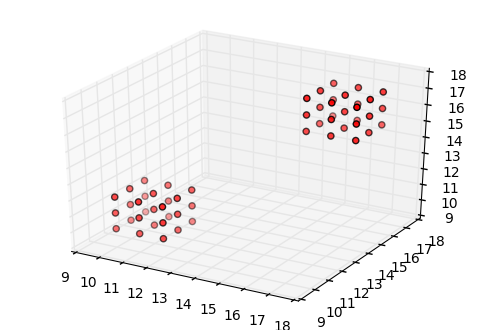

[[ 0.98129179  0.15666     0.11191101  0.98186933]
 [-0.14579866  0.98430276 -0.09945262 -0.27561341]
 [-0.12573457  0.08127557  0.98872903  1.04440211]
 [ 0.          0.          0.          1.        ]]


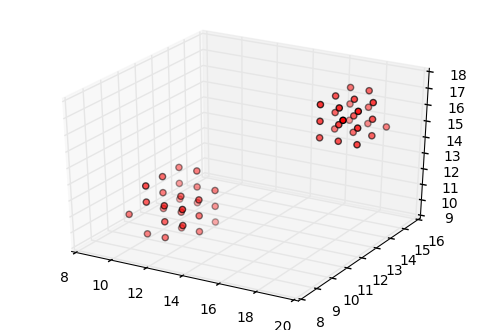

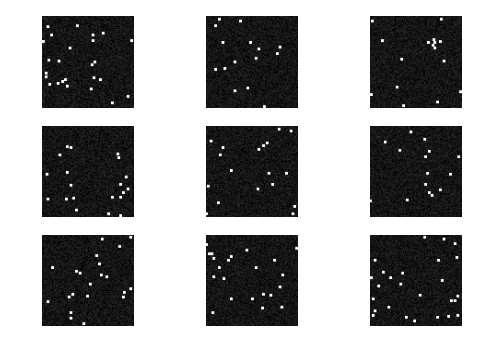

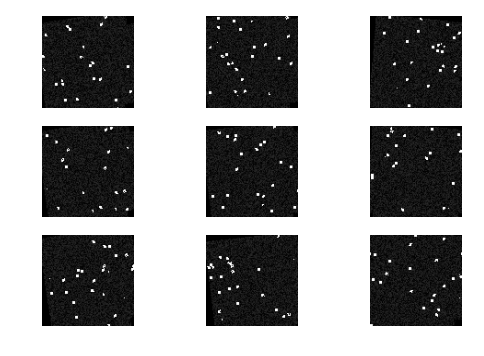

	Initial Error:  1.13515096536e+14
	Final Pipeline Error:  7.96177135879e+13
	Final Random Error:  1.142384919e+14
	Pipeline Reduction Ratio:  0.298615637763
	Random Reduction Ratio:  -0.00637267981583





Average Error Reduction Ratio:
	Pipeline:  0.362473436787
	Random:  -0.0256175219203

Error Reduction Ratio Variance
	Pipeline:  0.00260997450179
	Random:  0.00102377450053

Executing Validation Test With :  5  NDReg iterations
	Transformation Visualization:


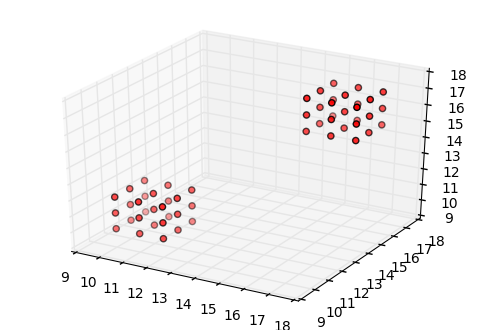

[[ 0.99646189 -0.08063897 -0.02368647 -1.31316428]
 [ 0.07962681  0.99598323 -0.04095095 -0.33013467]
 [ 0.02689357  0.03891999  0.99888036  0.78485793]
 [ 0.          0.          0.          1.        ]]


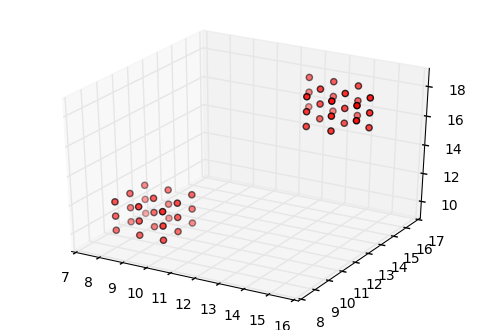

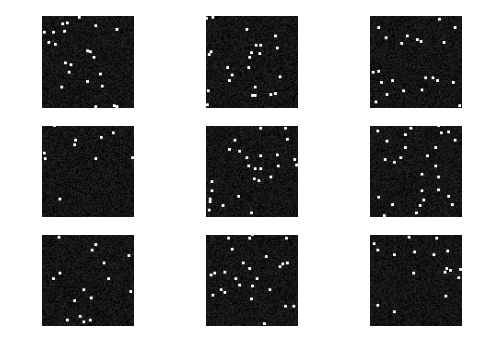

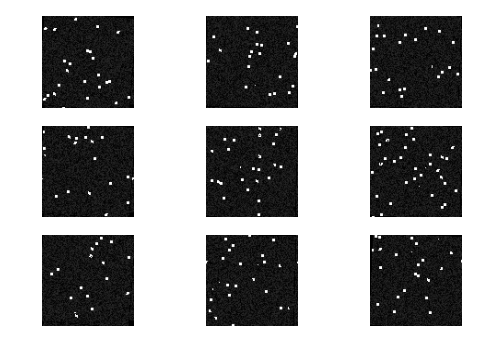

	Initial Error:  1.19150144299e+14
	Final Pipeline Error:  6.25123570507e+13
	Final Random Error:  1.29885443908e+14
	Pipeline Reduction Ratio:  0.475348037398
	Random Reduction Ratio:  -0.0900989224283





Executing Validation Test With :  5  NDReg iterations
	Transformation Visualization:


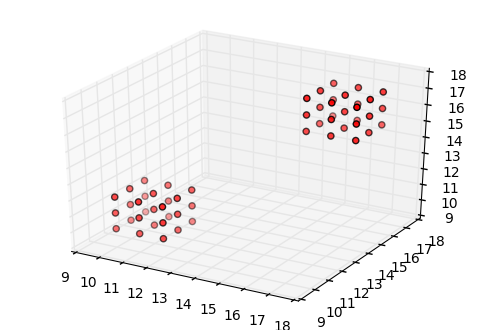

[[ 0.98787634 -0.13747871  0.07211064 -1.48033551]
 [ 0.13268424  0.98885411  0.06754584  0.8209066 ]
 [-0.08059302 -0.05715899  0.99510684  0.5574439 ]
 [ 0.          0.          0.          1.        ]]


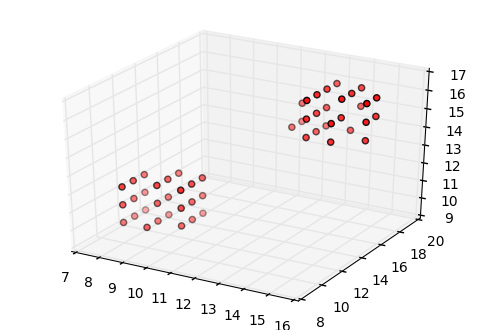

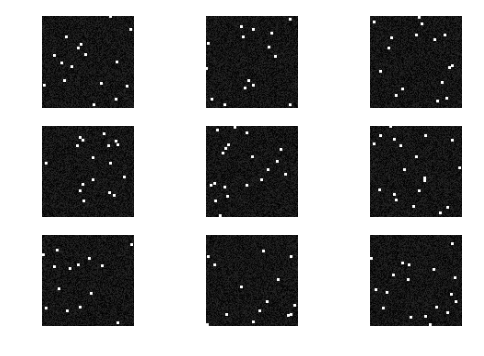

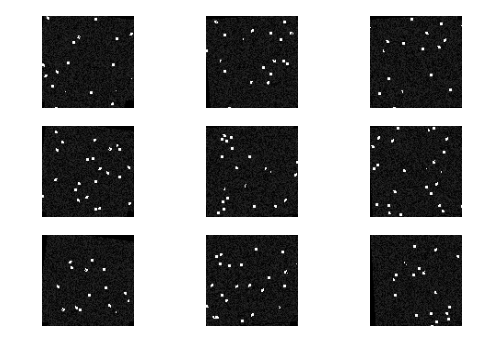

	Initial Error:  1.0506158691e+14
	Final Pipeline Error:  6.09276323336e+13
	Final Random Error:  1.05185240625e+14
	Pipeline Reduction Ratio:  0.420076984122
	Random Reduction Ratio:  -0.00117696409522





Executing Validation Test With :  5  NDReg iterations
	Transformation Visualization:


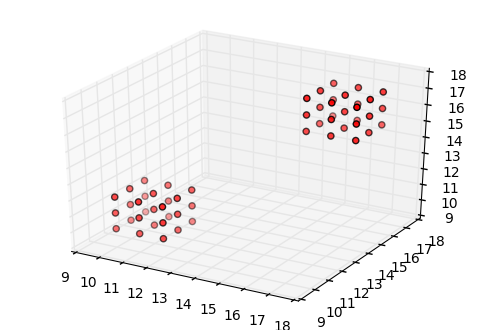

[[ 0.99036532  0.05735394  0.12604387 -0.47227444]
 [-0.04410478  0.99344053 -0.10550209  0.00401489]
 [-0.13126805  0.09892648  0.98639863  0.31045795]
 [ 0.          0.          0.          1.        ]]


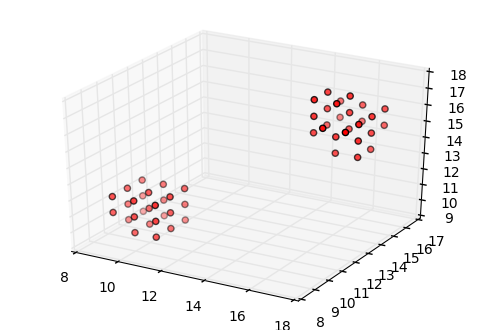

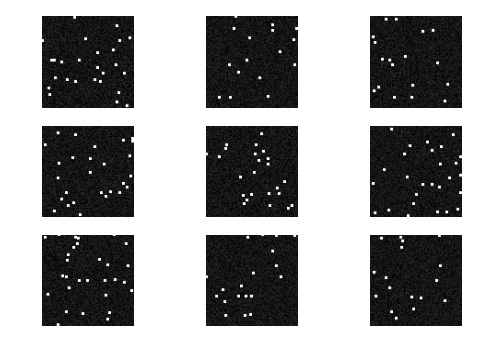

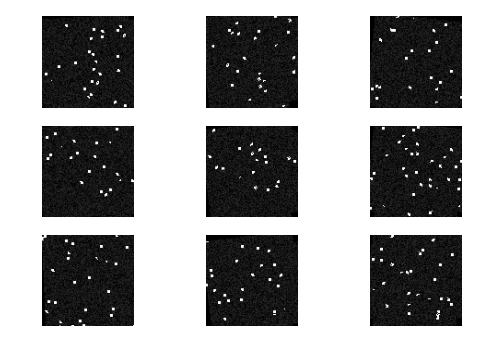

	Initial Error:  1.20175585838e+14
	Final Pipeline Error:  7.64154544516e+13
	Final Random Error:  1.21902009269e+14
	Pipeline Reduction Ratio:  0.364134953711
	Random Reduction Ratio:  -0.0143658416073





Average Error Reduction Ratio:
	Pipeline:  0.419853325077
	Random:  -0.0352139093769

Error Reduction Ratio Variance
	Pipeline:  0.00206141667554
	Random:  0.0015351734105


In [71]:
multiPipeDat = []
multiRandDat = []

for iterationNum in range(1, 6):
    
    pipeList = []
    randList = []
    
    for i in range(3):
        pipeline, random = executeNDReg2Test(iterationNum, False)
        pipeList.append(pipeline)
        randList.append(random)
    
    print '\nAverage Error Reduction Ratio:'
    print '\tPipeline: ', np.average(pipeList)
    print '\tRandom: ', np.average(randList)

    print '\nError Reduction Ratio Variance'
    print '\tPipeline: ', np.var(pipeList)
    print '\tRandom: ', np.var(randList)
    
    #save the data for later exploration
    multiPipeDat.append(pipeList)
    multiRandDat.append(randList)

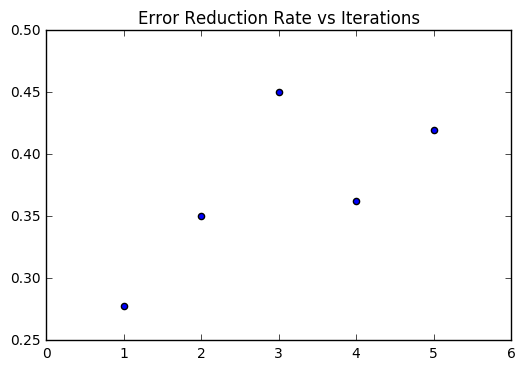

In [73]:
fig = plt.figure()
plt.title('Error Reduction Rate vs Iterations')
plt.scatter([1, 2, 3, 4, 5], [np.average(elem) for elem in multiPipeDat])
plt.show()

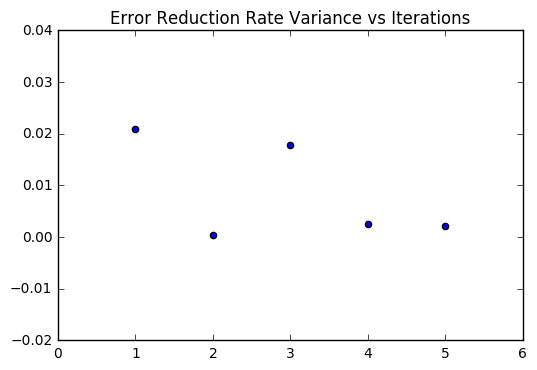

In [76]:
fig = plt.figure()
plt.title('Error Reduction Rate Variance vs Iterations')
plt.scatter([1, 2, 3, 4, 5], [np.var(elem) for elem in multiPipeDat])
plt.show()

In [75]:
print 'Average of Average Error Reduction for iterative NDReg: ', np.average([np.average(elem) for elem in multiPipeDat])

Average of Average Error Reduction for iterative NDReg:  0.372119195554


This repetition of NDReg has improved the reduction of error ratio substantially from the .18 reduction ratio of the non repeated test. Now, I will repeat the same test with the MI loss metric as opposed to the L2 loss metric


Executing Validation Test With :  1  NDReg iterations
	Transformation Visualization:


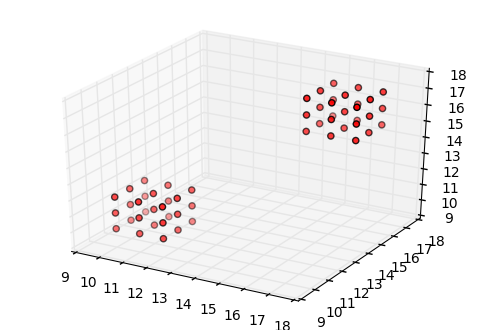

[[ 0.98944231 -0.11441869  0.08895103 -0.36307843]
 [ 0.10415393  0.9881727   0.11254635 -0.73039638]
 [-0.10077638 -0.10209352  0.98965703  0.09574831]
 [ 0.          0.          0.          1.        ]]


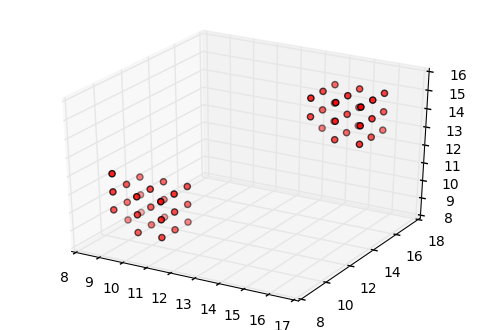

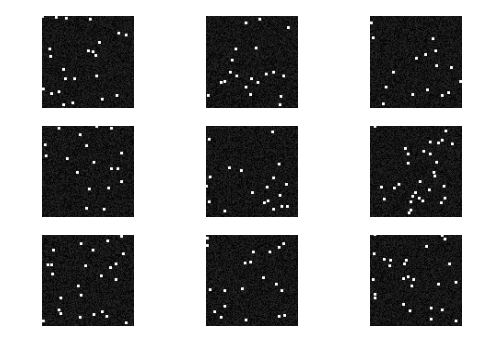

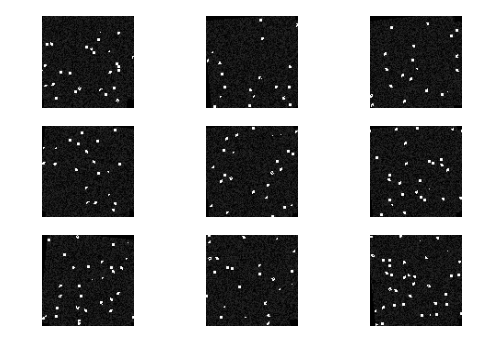

	Initial Error:  1.2691885024e+14
	Final Pipeline Error:  1.05242579769e+14
	Final Random Error:  1.28954726603e+14
	Pipeline Reduction Ratio:  0.17078842449
	Random Reduction Ratio:  -0.0160407721876





Executing Validation Test With :  1  NDReg iterations
	Transformation Visualization:


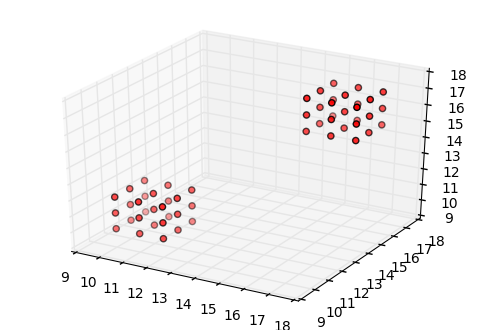

[[ 0.9844408  -0.11609152  0.13190555  0.36642586]
 [ 0.12466981  0.99045889 -0.05872506 -1.2009556 ]
 [-0.12382954  0.07425598  0.98952124 -1.08286617]
 [ 0.          0.          0.          1.        ]]


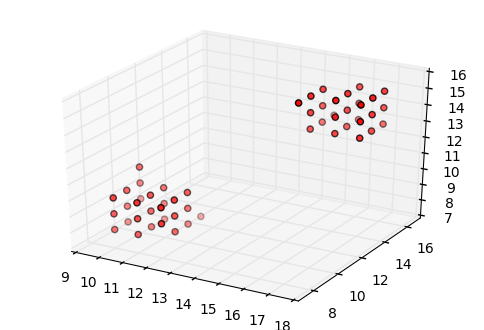

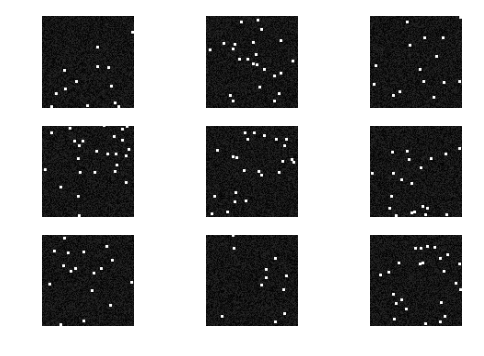

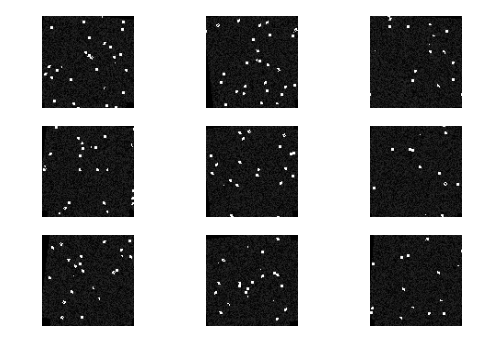

	Initial Error:  1.2045575069e+14
	Final Pipeline Error:  9.77832630695e+13
	Final Random Error:  1.18083969879e+14
	Pipeline Reduction Ratio:  0.188222542227
	Random Reduction Ratio:  0.0196900587774





Executing Validation Test With :  1  NDReg iterations
	Transformation Visualization:


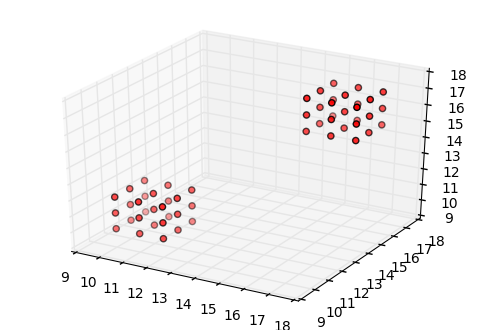

[[ 0.99003774 -0.03865693  0.1353917  -0.05758405]
 [ 0.04901439  0.99605146 -0.07402079  1.20291604]
 [-0.13199569  0.07991952  0.98802328 -0.34392421]
 [ 0.          0.          0.          1.        ]]


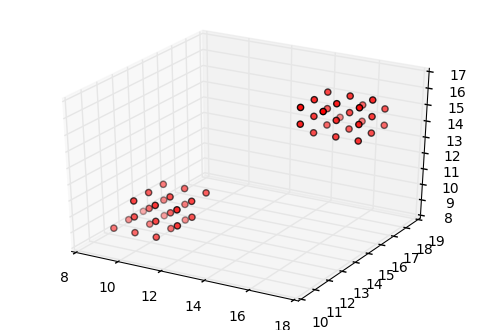

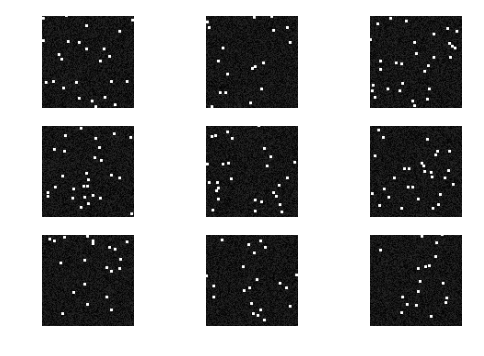

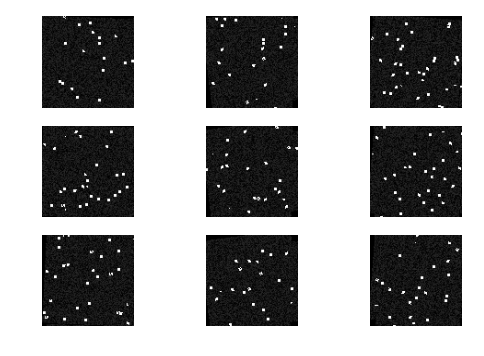

	Initial Error:  1.27073273787e+14
	Final Pipeline Error:  5.91196409387e+13
	Final Random Error:  1.29396257573e+14
	Pipeline Reduction Ratio:  0.534759440938
	Random Reduction Ratio:  -0.0182806637175





Average Error Reduction Ratio:
	Pipeline:  0.297923469218
	Random:  -0.0048771257092

Error Reduction Ratio Variance
	Pipeline:  0.0280962968271
	Random:  0.000302609462478

Executing Validation Test With :  2  NDReg iterations
	Transformation Visualization:


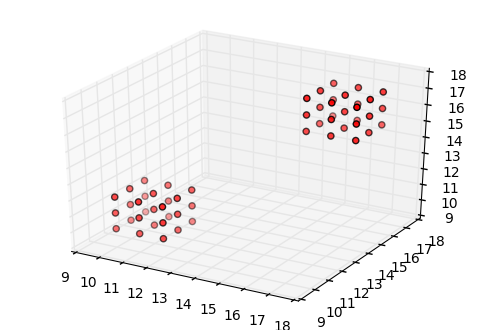

[[ 0.9888407   0.14873244  0.00852784 -0.77316338]
 [-0.14839151  0.97827257  0.14478517 -0.24942711]
 [ 0.0131917  -0.14443493  0.98942636 -0.04909512]
 [ 0.          0.          0.          1.        ]]


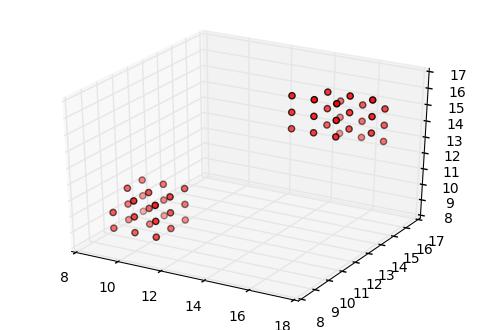

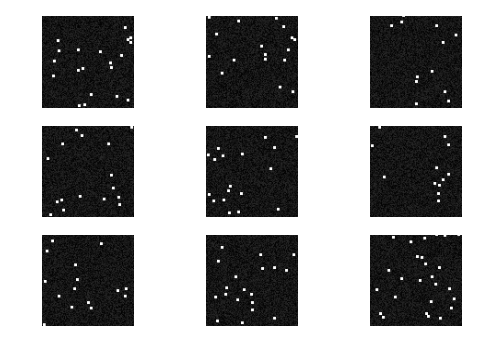

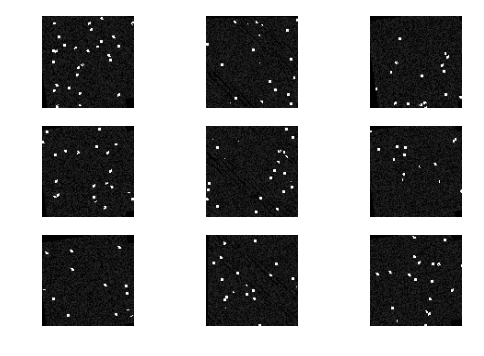

	Initial Error:  1.02083273059e+14
	Final Pipeline Error:  8.4963469908e+13
	Final Random Error:  1.01589288263e+14
	Pipeline Reduction Ratio:  0.167704293156
	Random Reduction Ratio:  0.00483903760138





Executing Validation Test With :  2  NDReg iterations
	Transformation Visualization:


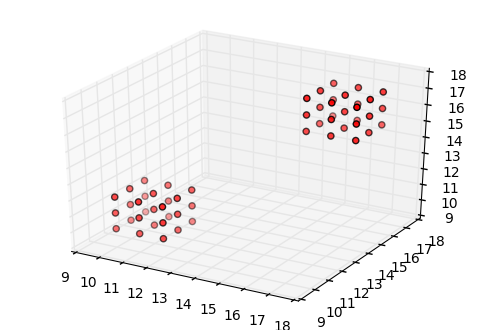

[[ 0.99284663 -0.04778957 -0.10941535 -0.60547306]
 [ 0.04035866  0.9967895  -0.06915101 -1.43263494]
 [ 0.11236877  0.06424049  0.99158783 -1.32505145]
 [ 0.          0.          0.          1.        ]]


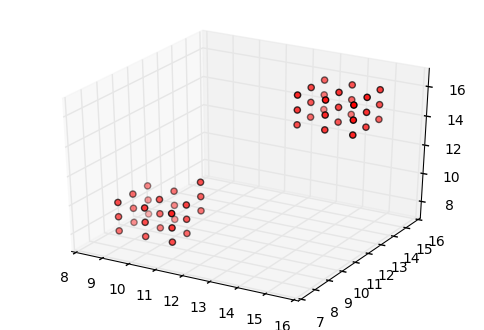

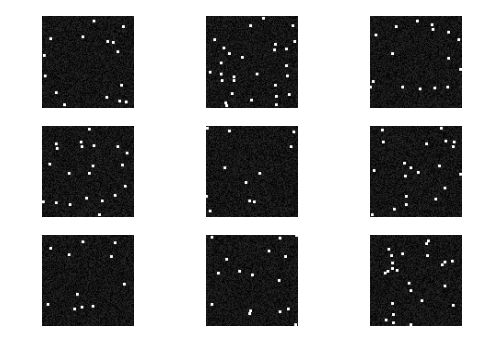

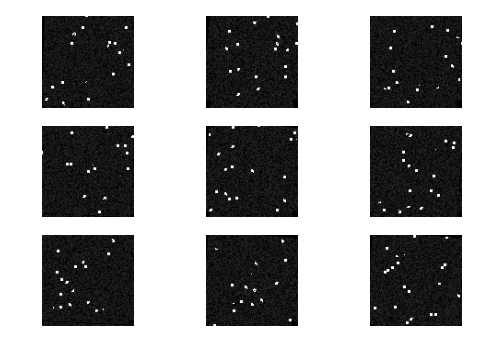

	Initial Error:  9.48857555862e+13
	Final Pipeline Error:  8.17838080948e+13
	Final Random Error:  9.77069339838e+13
	Pipeline Reduction Ratio:  0.138081289551
	Random Reduction Ratio:  -0.0297323700509





Executing Validation Test With :  2  NDReg iterations
	Transformation Visualization:


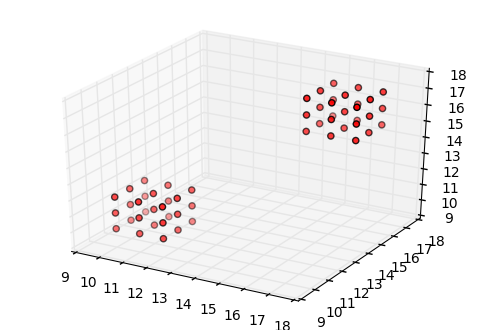

[[ 0.98962461 -0.12392939  0.07269553 -0.54868517]
 [ 0.11569181  0.98736475  0.10828788 -1.21663955]
 [-0.08519706 -0.09875407  0.99145807  0.03726565]
 [ 0.          0.          0.          1.        ]]


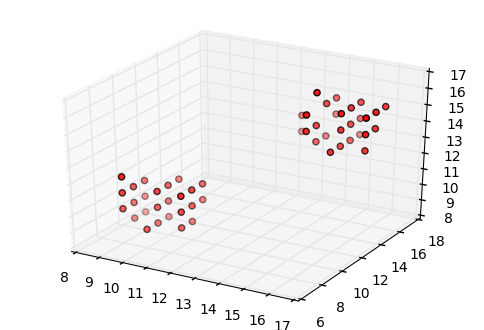

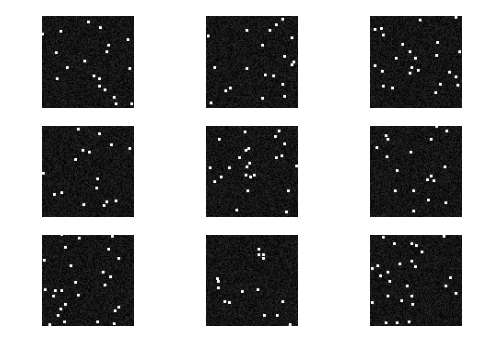

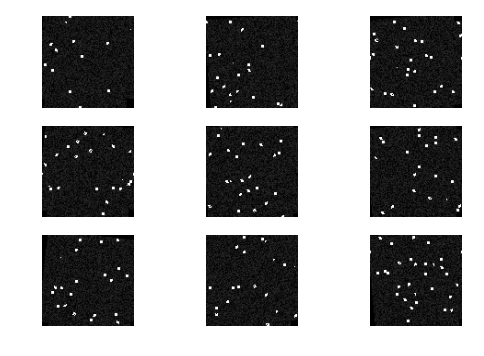

	Initial Error:  1.16952067666e+14
	Final Pipeline Error:  9.87024484088e+13
	Final Random Error:  1.1664892768e+14
	Pipeline Reduction Ratio:  0.156043579406
	Random Reduction Ratio:  0.00259200194256





Average Error Reduction Ratio:
	Pipeline:  0.153943054037
	Random:  -0.00743377683566

Error Reduction Ratio Variance
	Pipeline:  0.000148459827175
	Random:  0.000249455157898

Executing Validation Test With :  3  NDReg iterations
	Transformation Visualization:


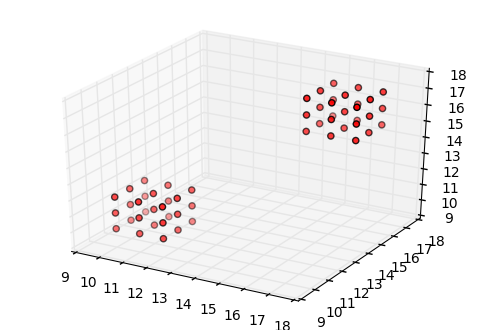

[[ 0.99303751 -0.00852938 -0.11748934  1.06246299]
 [ 0.01412472  0.99880093  0.04687417  0.2626288 ]
 [ 0.11694866 -0.04820731  0.99196727  0.23641318]
 [ 0.          0.          0.          1.        ]]


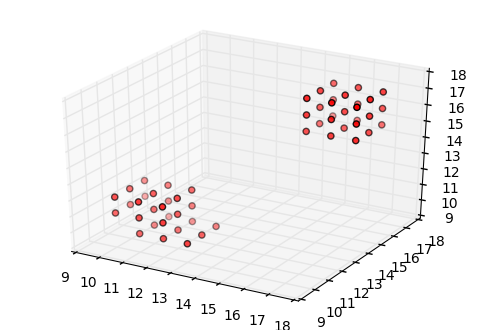

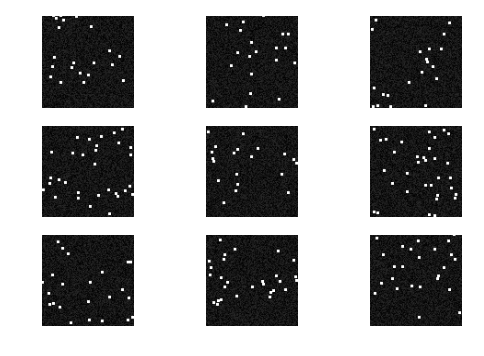

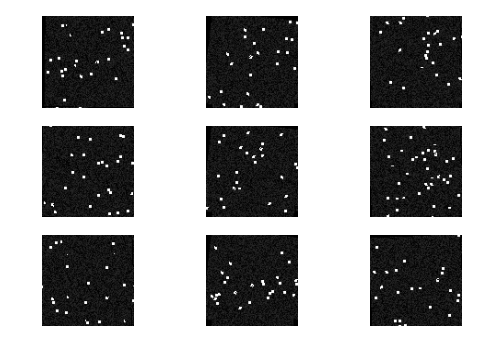

	Initial Error:  1.30996612974e+14
	Final Pipeline Error:  7.70865283674e+13
	Final Random Error:  1.33671771669e+14
	Pipeline Reduction Ratio:  0.41153800379
	Random Reduction Ratio:  -0.0204215867455





Executing Validation Test With :  3  NDReg iterations
	Transformation Visualization:


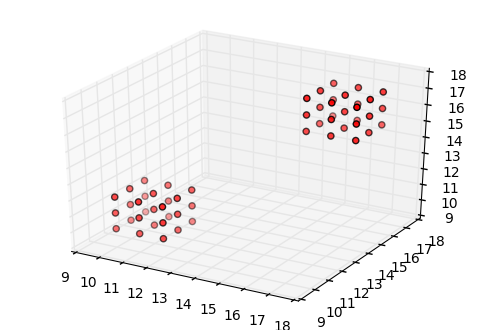

[[ 0.98239989  0.15194483  0.10864262  1.08780154]
 [-0.14307509  0.98603064 -0.08528245  0.4770962 ]
 [-0.12008318  0.06823742  0.99041592 -0.54652399]
 [ 0.          0.          0.          1.        ]]


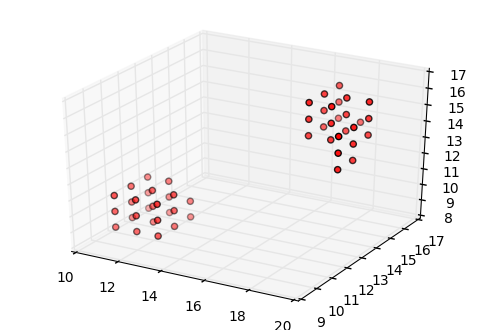

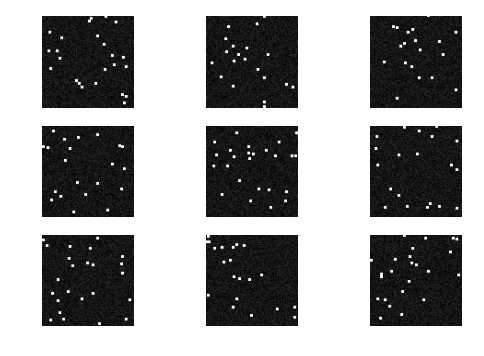

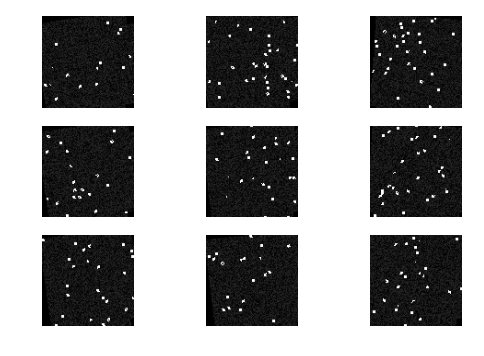

	Initial Error:  1.25583071053e+14
	Final Pipeline Error:  1.0388487425e+14
	Final Random Error:  1.20294680618e+14
	Pipeline Reduction Ratio:  0.172779632006
	Random Reduction Ratio:  0.0421106952612





Executing Validation Test With :  3  NDReg iterations
	Transformation Visualization:


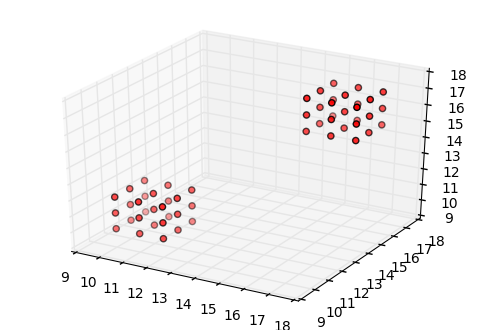

[[ 0.9942217  -0.06746409  0.08349738  0.82761318]
 [ 0.06025616  0.99446904  0.08602624  1.11132075]
 [-0.08883924 -0.08049793  0.99278783 -0.27491051]
 [ 0.          0.          0.          1.        ]]


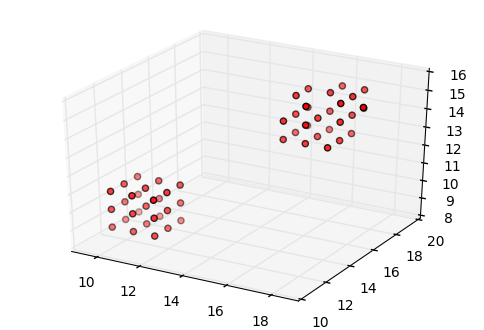

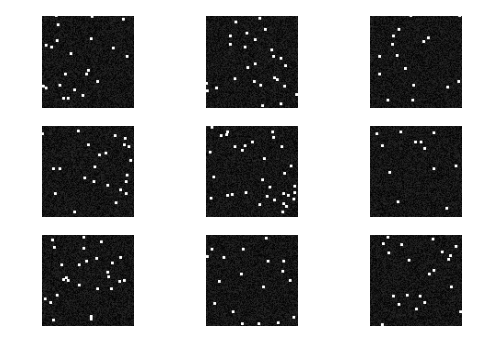

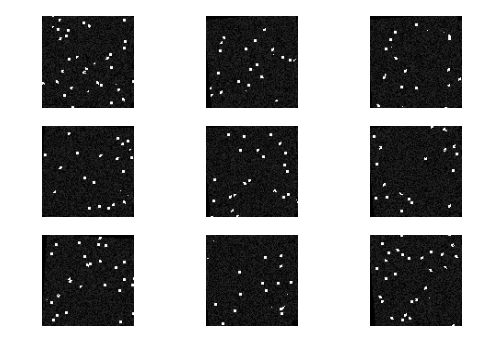

	Initial Error:  1.23476077812e+14
	Final Pipeline Error:  1.04430687843e+14
	Final Random Error:  1.26469884165e+14
	Pipeline Reduction Ratio:  0.15424356124
	Random Reduction Ratio:  -0.0242460434882





Average Error Reduction Ratio:
	Pipeline:  0.246187065678
	Random:  -0.000852311657484

Error Reduction Ratio Variance
	Pipeline:  0.013727730687
	Random:  0.000925347726643

Executing Validation Test With :  4  NDReg iterations
	Transformation Visualization:


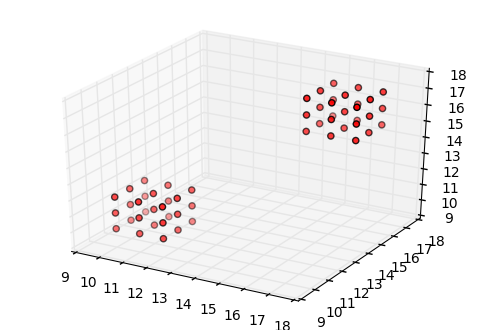

[[ 0.99897389  0.04461907  0.00776598 -0.39100856]
 [-0.04414934  0.99763298 -0.05271886  0.11451544]
 [-0.01009986  0.0523219   0.9985792  -0.34174449]
 [ 0.          0.          0.          1.        ]]


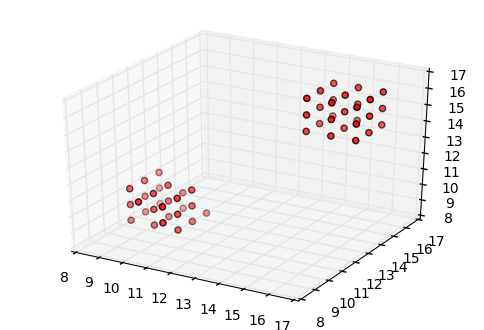

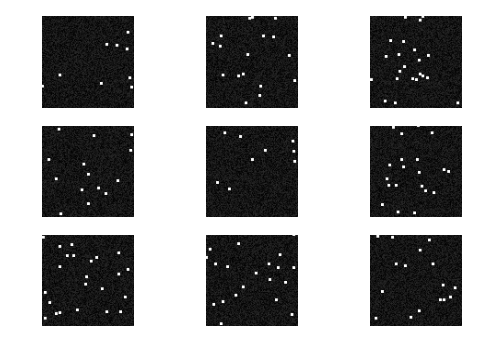

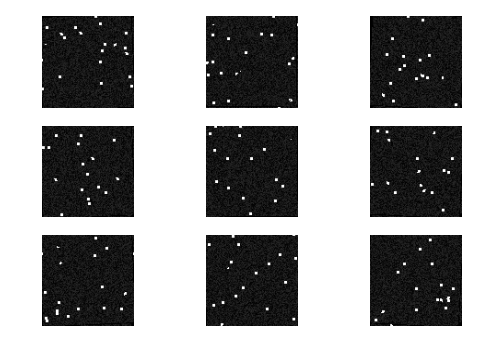

	Initial Error:  8.46112682338e+13
	Final Pipeline Error:  5.01032195376e+13
	Final Random Error:  9.62807998449e+13
	Pipeline Reduction Ratio:  0.407842234451
	Random Reduction Ratio:  -0.137919355834





Executing Validation Test With :  4  NDReg iterations
	Transformation Visualization:


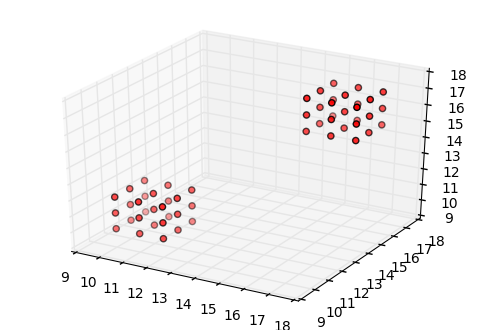

[[ 0.99821876  0.02064179 -0.05597519  0.3232914 ]
 [-0.02450112  0.99730457 -0.06916137 -1.15558448]
 [ 0.0543967   0.07040963  0.99603388  0.19984392]
 [ 0.          0.          0.          1.        ]]


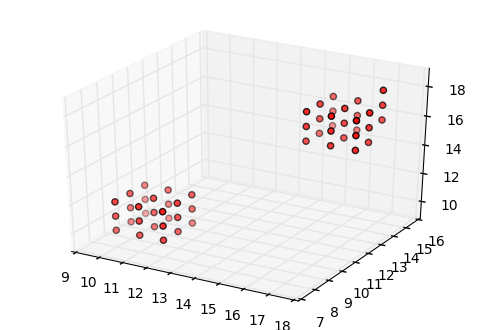

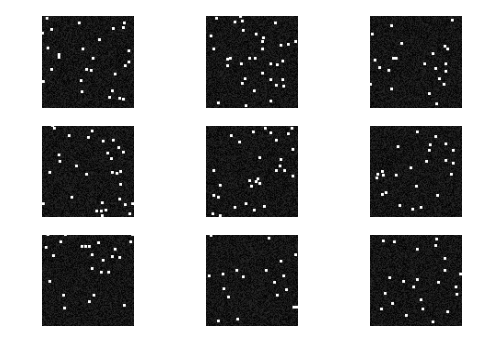

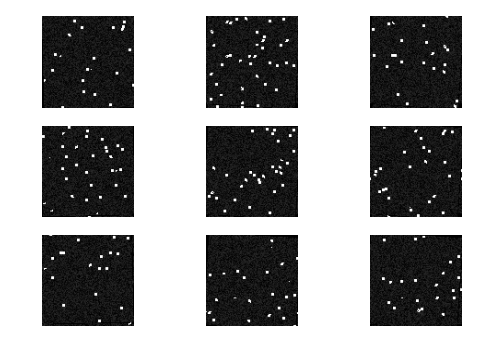

	Initial Error:  1.28677936344e+14
	Final Pipeline Error:  6.8024991007e+13
	Final Random Error:  1.35942532399e+14
	Pipeline Reduction Ratio:  0.471354663123
	Random Reduction Ratio:  -0.0564556462571





Executing Validation Test With :  4  NDReg iterations
	Transformation Visualization:


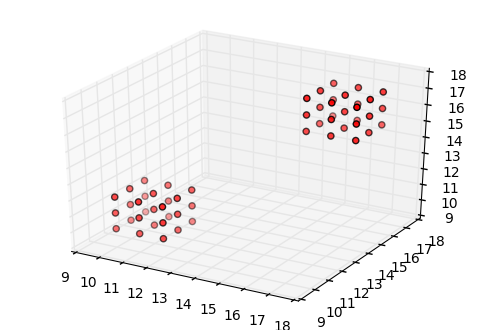

[[ 0.99336375 -0.02771544  0.1116258   0.00426744]
 [ 0.0332682   0.99828388 -0.04819262 -0.22317031]
 [-0.11009855  0.05158639  0.99258106  1.0730484 ]
 [ 0.          0.          0.          1.        ]]


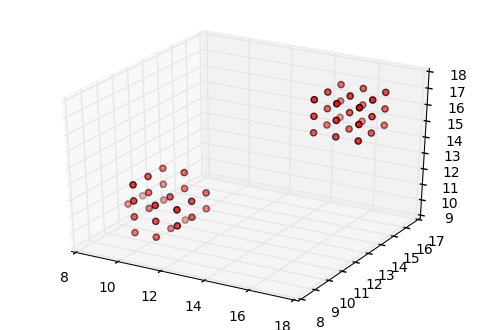

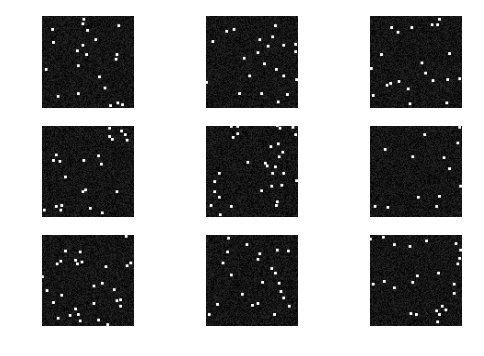

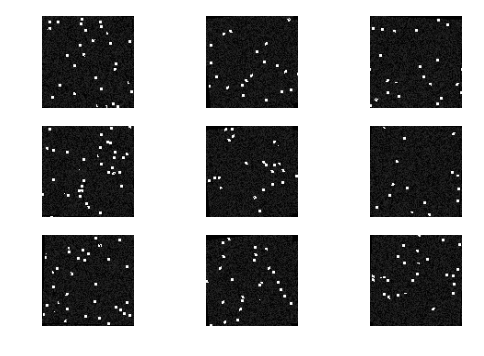

	Initial Error:  1.25295321987e+14
	Final Pipeline Error:  1.06878671961e+14
	Final Random Error:  1.28852971919e+14
	Pipeline Reduction Ratio:  0.146985934779
	Random Reduction Ratio:  -0.0283941162015





Average Error Reduction Ratio:
	Pipeline:  0.342060944118
	Random:  -0.0742563727641

Error Reduction Ratio Variance
	Pipeline:  0.0196994344002
	Random:  0.00215772928483

Executing Validation Test With :  5  NDReg iterations
	Transformation Visualization:


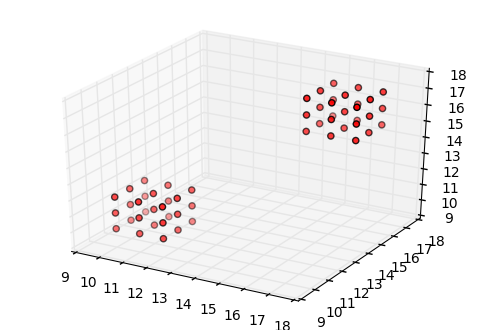

[[ 0.99441554  0.08339294  0.0646788   1.46143079]
 [-0.08905084  0.99193573  0.09018567 -1.23649863]
 [-0.05663637 -0.09544173  0.99382252 -0.33840984]
 [ 0.          0.          0.          1.        ]]


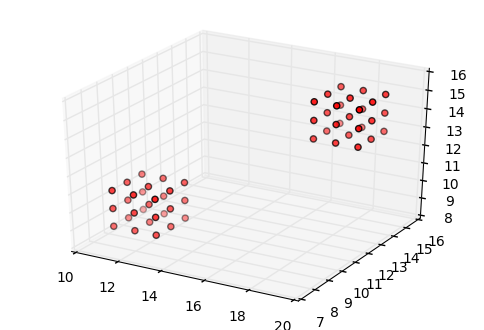

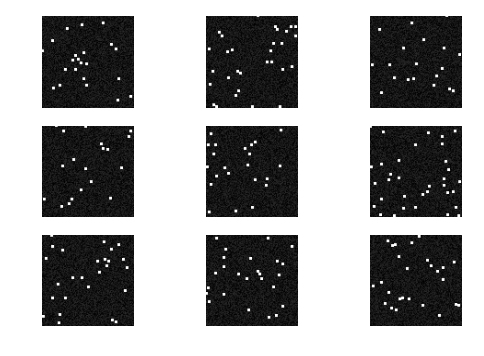

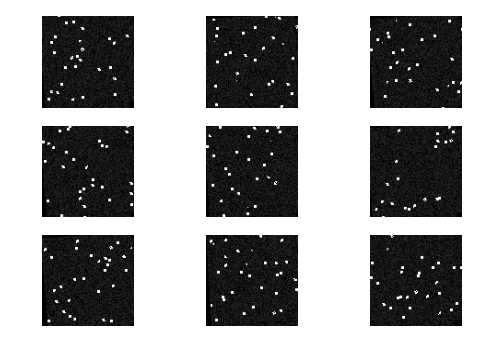

	Initial Error:  1.33156358892e+14
	Final Pipeline Error:  1.12853825218e+14
	Final Random Error:  1.35648987056e+14
	Pipeline Reduction Ratio:  0.152471379082
	Random Reduction Ratio:  -0.0187195578588





Executing Validation Test With :  5  NDReg iterations
	Transformation Visualization:


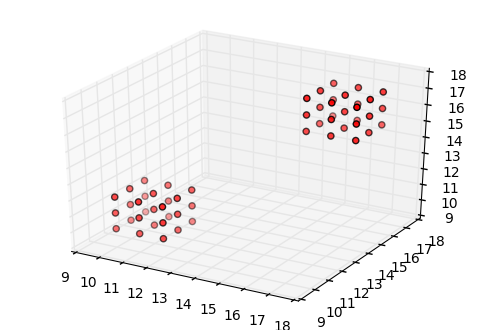

[[ 0.99875783 -0.04790076  0.01372291  0.94784065]
 [ 0.04846827  0.99783123 -0.0445383   1.10925607]
 [-0.01155973  0.04514811  0.99891342 -0.18370248]
 [ 0.          0.          0.          1.        ]]


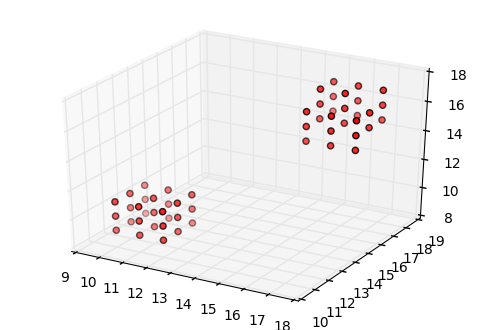

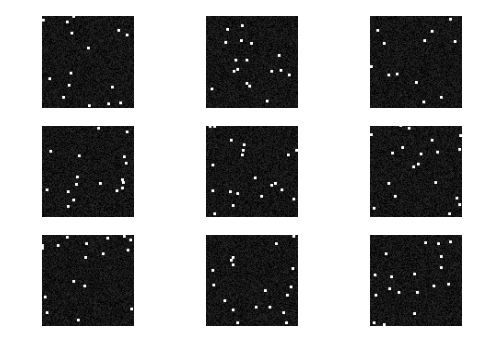

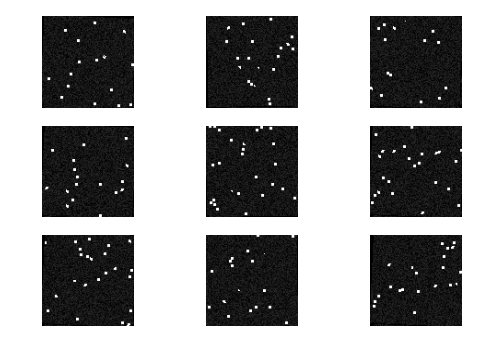

	Initial Error:  8.83782921457e+13
	Final Pipeline Error:  3.41595388722e+13
	Final Random Error:  1.06440092981e+14
	Pipeline Reduction Ratio:  0.613484962847
	Random Reduction Ratio:  -0.204369199688





Executing Validation Test With :  5  NDReg iterations
	Transformation Visualization:


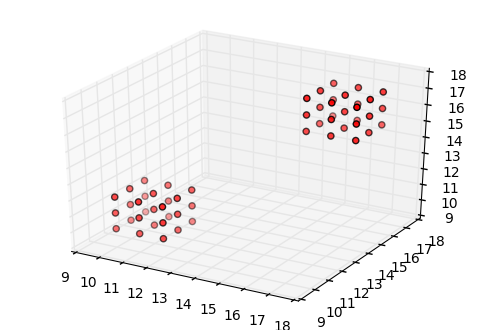

[[  9.93919312e-01   1.55545436e-02   1.09006683e-01  -1.35187201e-01]
 [ -1.19162911e-03   9.91433650e-01  -1.30605889e-01  -1.29470381e+00]
 [ -1.10104408e-01   1.29681820e-01   9.85423587e-01  -1.04857265e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   1.00000000e+00]]


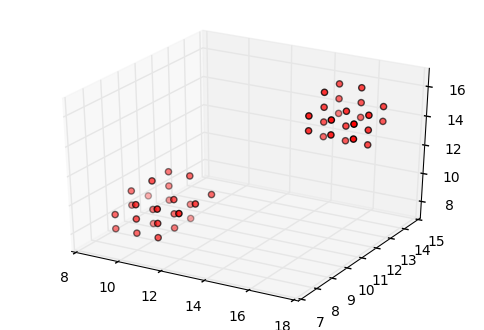

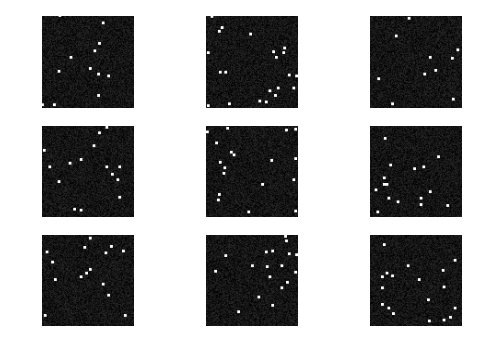

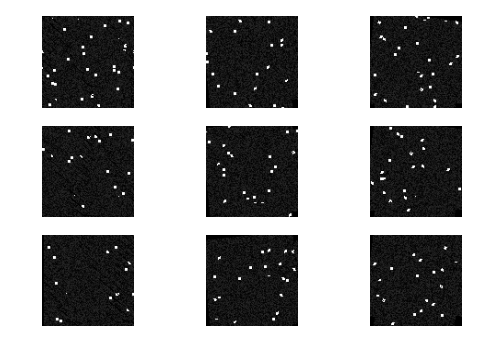

	Initial Error:  1.01078459674e+14
	Final Pipeline Error:  8.36975751903e+13
	Final Random Error:  1.01234423119e+14
	Pipeline Reduction Ratio:  0.171954386128
	Random Reduction Ratio:  -0.00154299388195





Average Error Reduction Ratio:
	Pipeline:  0.312636909352
	Random:  -0.0748772504762

Error Reduction Ratio Variance
	Pipeline:  0.0453180402397
	Random:  0.00843325484701


In [72]:
multiMIPipeDat = []
multiMIRandDat = []

for iterationNum in range(1, 6):
    
    pipeList = []
    randList = []
    
    for i in range(3):
        pipeline, random = executeNDReg2Test(iterationNum, True)
        pipeList.append(pipeline)
        randList.append(random)
    
    print '\nAverage Error Reduction Ratio:'
    print '\tPipeline: ', np.average(pipeList)
    print '\tRandom: ', np.average(randList)
n Ratio:'
    print '\tPipeline: ', np.averag
    print '\nError Reduction Ratio Variance'
    print '\tPipeline: ', np.var(pipeList)
    print '\tRandom: ', np.var(randList)
    
    #save the data for later exploration
    multiMIPipeDat.append(pipeList)
    multiMIRandDat.append(randList)

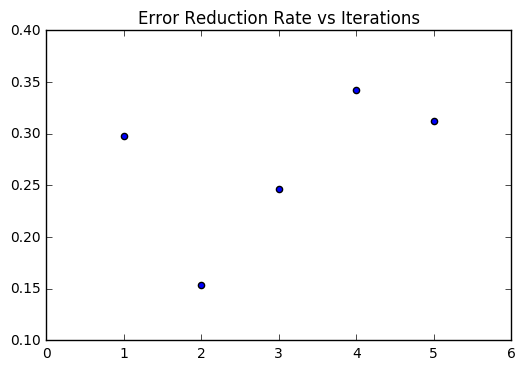

In [79]:
fig = plt.figure()
plt.title('Error Reduction Rate vs Iterations')
plt.scatter([1, 2, 3, 4, 5], [np.average(elem) for elem in multiMIPipeDat])
plt.show()

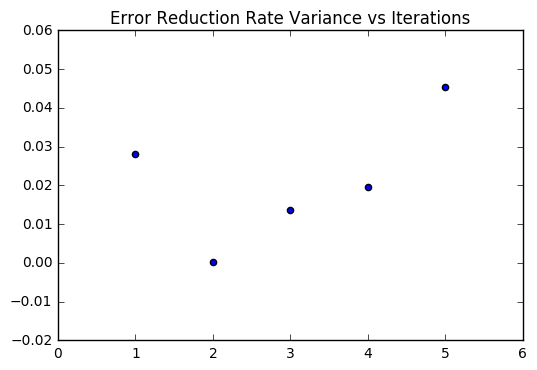

In [80]:
fig = plt.figure()
plt.title('Error Reduction Rate Variance vs Iterations')
plt.scatter([1, 2, 3, 4, 5], [np.var(elem) for elem in multiMIPipeDat])
plt.show()

In [81]:
print 'Average of Average Error Reduction for iterative NDReg: ', np.average([np.average(elem) for elem in multiMIPipeDat])

Average of Average Error Reduction for iterative NDReg:  0.270550288481


The results of the iterative pipeline are underwhelming. The high variance in the 4th trial verifies that that high error reduction rate of the 4th trial is likely a result of luck, and not of actual algorithmic integrity.

The variance in these registration metods remains quite high. This is a clue to me that we are getting stuck in a local, non global minima during gradient descent. In order to combat this, I am going to redefine the registration method such that it attempts to align the centroids of the images before running the registration pipline. This will likely cause a large time increase,but hopefully prevent local minima convergence.

However, before going too crazy with new methods, I am going to apply the current transforms to some real data and generate some qualitative results as a 'they actually dont work' sanity check

In [83]:
#load the real data
realDat = pickle.load(open('../code/tests/synthDat/realDat_tpi_5-10.io'))

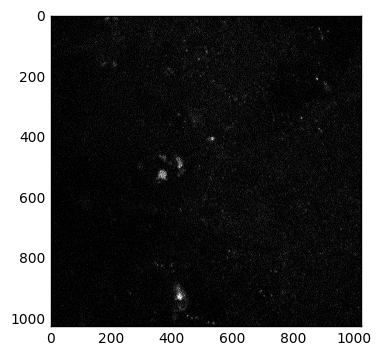

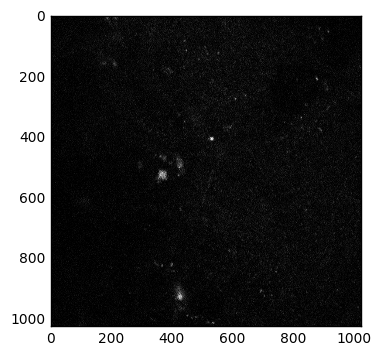

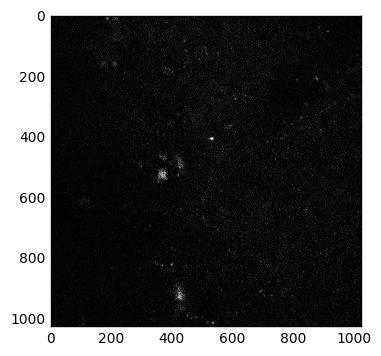

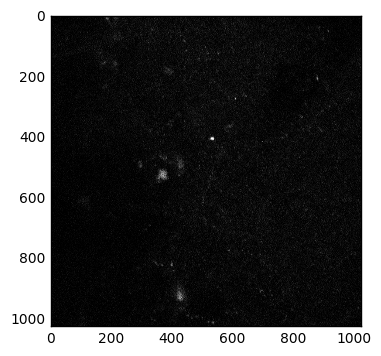

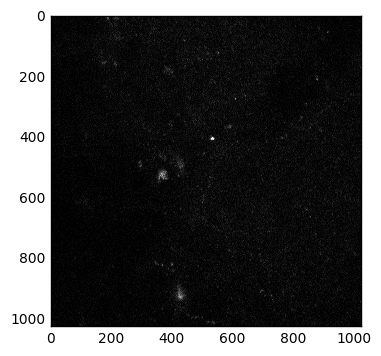

In [84]:
for i in range(5):
    fig = plt.figure()
    plt.imshow(realDat[i], cmap='gray')
    plt.show()

In [104]:
transform = getTransform()
print transform
rigidVol = applyRigid(realDat, transform)

[[ 0.97766824 -0.12567911  0.16843267  0.        ]
 [ 0.1477601   0.98100546 -0.12567911  0.        ]
 [-0.14943813  0.1477601   0.97766824  0.        ]
 [ 0.          0.          0.          1.        ]]


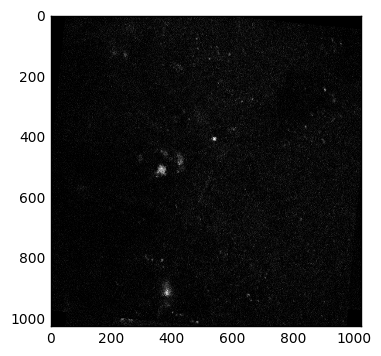

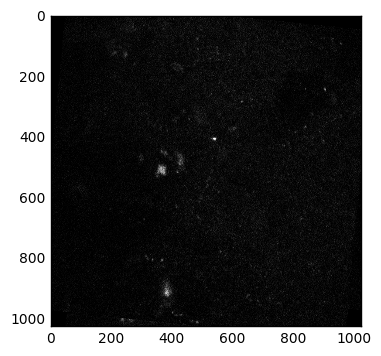

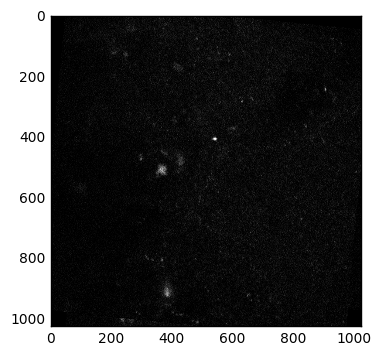

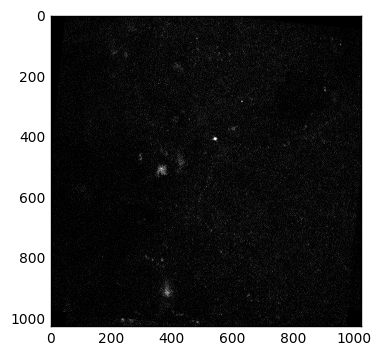

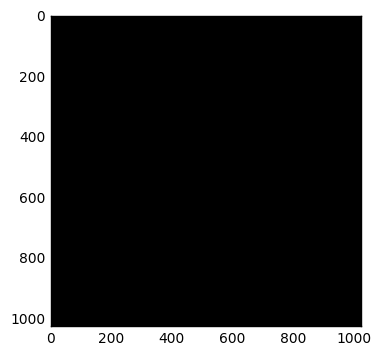

In [97]:
for i in range(5):
    fig = plt.figure()
    plt.imshow(rigidVol[i], cmap='gray')
    plt.show()